<a href="https://colab.research.google.com/github/mohammadsjahanbakhsh/detection/blob/main/road_segmentaion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install kaggle

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"mohammadjahanbakhshh","key":"d1fd145b23555ab409a27817aea82e71"}'}

In [ ]:
! mkdir ~/.kaggle

In [ ]:
! cp kaggle.json ~/.kaggle/

In [ ]:
!chmod 600 ~/.kaggle/kaggle.json

! kaggle datasets list

ref                                                    title                                        size  lastUpdated          downloadCount  voteCount  usabilityRating  
-----------------------------------------------------  ------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
thedrcat/daigt-v2-train-dataset                        DAIGT V2 Train Dataset                       29MB  2023-11-16 01:38:36           2767        237  1.0              
bhavikjikadara/car-price-prediction-dataset            Car Price Prediction Dataset                  4KB  2023-12-23 07:07:54            948         29  0.9411765        
thedevastator/global-video-game-sales-and-reviews      Global Video Game Sales and Reviews          56KB  2023-12-20 06:36:51            881         23  1.0              
vassyesboy/netflix-engagement-jan-jun-23               Netflix Engagement (Jan - Jun 23) +           2MB  2023-12-15 11:58:07           1017     

In [ ]:

!kaggle datasets download -d sakshaymahna/kittiroadsegmentation

100% 305M/305M [00:10<00:00, 34.7MB/s]
100% 305M/305M [00:10<00:00, 29.7MB/s]


In [ ]:

!unzip /content/kittiroadsegmentation.zip

Archive:  /content/kittiroadsegmentation.zip
  inflating: testing/challenge.mp4   
  inflating: testing/challenge_video.mp4  
  inflating: testing/harder_challenge_video.mp4  
  inflating: testing/project_video.mp4  
  inflating: testing/solidWhiteRight.mp4  
  inflating: testing/solidYellowLeft.mp4  
  inflating: training/calib/um_000000.txt  
  inflating: training/calib/um_000001.txt  
  inflating: training/calib/um_000002.txt  
  inflating: training/calib/um_000003.txt  
  inflating: training/calib/um_000004.txt  
  inflating: training/calib/um_000005.txt  
  inflating: training/calib/um_000006.txt  
  inflating: training/calib/um_000007.txt  
  inflating: training/calib/um_000008.txt  
  inflating: training/calib/um_000009.txt  
  inflating: training/calib/um_000010.txt  
  inflating: training/calib/um_000011.txt  
  inflating: training/calib/um_000012.txt  
  inflating: training/calib/um_000013.txt  
  inflating: training/calib/um_000014.txt  
  inflating: training/calib/um_000015

In [ ]:
import pandas as pd
import numpy as np
import os
import random
import tensorflow as tf
import cv2
from tqdm import tqdm
import datetime
from tensorflow import keras
from tensorflow.keras.layers import Conv2D, MaxPooling2D, UpSampling2D, Concatenate
from tensorflow.keras.layers import Input, Add, Conv2DTranspose
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.applications import VGG16
from tensorflow.keras.optimizers import SGD, Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy, MeanSquaredError, BinaryCrossentropy
from tensorflow.keras.utils import plot_model
from tensorflow.keras import callbacks

from  matplotlib import pyplot as plt
import matplotlib.image as mpimg
from IPython.display import clear_output

from IPython.display import HTML
from base64 import b64encode

In [ ]:
# Load directories
train_data_dir = r"/content/training/image_2/"
train_gt_dir = r"/content/training/gt_image_2/"

test_data_dir = r"/content/testing/"

In [ ]:
TRAINSET_SIZE = int(len(os.listdir(train_data_dir)) * 0.8)
print(f"Number of Training Examples: {TRAINSET_SIZE}")

VALIDSET_SIZE = int(len(os.listdir(train_data_dir)) * 0.1)
print(f"Number of Validation Examples: {VALIDSET_SIZE}")

TESTSET_SIZE = int(len(os.listdir(train_data_dir)) - TRAINSET_SIZE - VALIDSET_SIZE)
print(f"Number of Testing Examples: {TESTSET_SIZE}")

Number of Training Examples: 231
Number of Validation Examples: 28
Number of Testing Examples: 30


In [ ]:
IMG_SIZE = 128
N_CHANNELS = 3
N_CLASSES = 1
SEED = 123

In [ ]:
# Function to load image and return a dictionary
def parse_image(img_path: str) -> dict:
    image = tf.io.read_file(img_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.convert_image_dtype(image, tf.uint8)

    # Three types of img paths: um, umm, uu
    # gt image paths: um_road, umm_road, uu_road
    mask_path = tf.strings.regex_replace(img_path, "image_2", "gt_image_2")
    mask_path = tf.strings.regex_replace(mask_path, "um_", "um_road_")
    mask_path = tf.strings.regex_replace(mask_path, "umm_", "umm_road_")
    mask_path = tf.strings.regex_replace(mask_path, "uu_", "uu_road_")

    mask = tf.io.read_file(mask_path)
    mask = tf.image.decode_png(mask, channels=3)

    non_road_label = np.array([255, 0, 0])
    road_label = np.array([255, 0, 255])
    other_road_label = np.array([0, 0, 0])

    # Convert to mask to binary mask
    mask = tf.experimental.numpy.all(mask == road_label, axis = 2)
    mask = tf.cast(mask, tf.uint8)
    mask = tf.expand_dims(mask, axis=-1)

    return {'image': image, 'segmentation_mask': mask}

In [ ]:
# Generate dataset variables
all_dataset = tf.data.Dataset.list_files(train_data_dir + "*.png", seed=SEED)
all_dataset = all_dataset.map(parse_image)

train_dataset = all_dataset.take(TRAINSET_SIZE + VALIDSET_SIZE)
val_dataset = train_dataset.skip(TRAINSET_SIZE)
train_dataset = train_dataset.take(TRAINSET_SIZE)
test_dataset = all_dataset.skip(TRAINSET_SIZE + VALIDSET_SIZE)

In [ ]:
# Tensorflow function to rescale images to [0, 1]
@tf.function
def normalize(input_image: tf.Tensor, input_mask: tf.Tensor) -> tuple:
    input_image = tf.cast(input_image, tf.float32) / 255.0
    return input_image, input_mask

# Tensorflow function to apply preprocessing transformations
@tf.function
def load_image_train(datapoint: dict) -> tuple:
    input_image = tf.image.resize(datapoint['image'], (IMG_SIZE, IMG_SIZE))
    input_mask = tf.image.resize(datapoint['segmentation_mask'], (IMG_SIZE, IMG_SIZE))

    if tf.random.uniform(()) > 0.5:
        input_image = tf.image.flip_left_right(input_image)
        input_mask = tf.image.flip_left_right(input_mask)

    input_image, input_mask = normalize(input_image, input_mask)

    return input_image, input_mask

# Tensorflow function to preprocess validation images
@tf.function
def load_image_test(datapoint: dict) -> tuple:
    input_image = tf.image.resize(datapoint['image'], (IMG_SIZE, IMG_SIZE))
    input_mask = tf.image.resize(datapoint['segmentation_mask'], (IMG_SIZE, IMG_SIZE))

    input_image, input_mask = normalize(input_image, input_mask)

    return input_image, input_mask

In [ ]:
BATCH_SIZE = 32
BUFFER_SIZE = 1000

dataset = {"train": train_dataset, "val": val_dataset, "test": test_dataset}

# -- Train Dataset --#
dataset['train'] = dataset['train'].map(load_image_train, num_parallel_calls=tf.data.AUTOTUNE)
dataset['train'] = dataset['train'].shuffle(buffer_size=BUFFER_SIZE, seed=SEED)
dataset['train'] = dataset['train'].repeat()
dataset['train'] = dataset['train'].batch(BATCH_SIZE)
dataset['train'] = dataset['train'].prefetch(buffer_size=tf.data.AUTOTUNE)

#-- Validation Dataset --#
dataset['val'] = dataset['val'].map(load_image_test)
dataset['val'] = dataset['val'].repeat()
dataset['val'] = dataset['val'].batch(BATCH_SIZE)
dataset['val'] = dataset['val'].prefetch(buffer_size=tf.data.AUTOTUNE)

#-- Testing Dataset --#
dataset['test'] = dataset['test'].map(load_image_test)
dataset['test'] = dataset['test'].batch(BATCH_SIZE)
dataset['test'] = dataset['test'].prefetch(buffer_size=tf.data.AUTOTUNE)

print(dataset['train'])
print(dataset['val'])
print(dataset['test'])

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 128, 128, 1), dtype=tf.float32, name=None))>
<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 128, 128, 1), dtype=tf.float32, name=None))>
<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 128, 128, 1), dtype=tf.float32, name=None))>


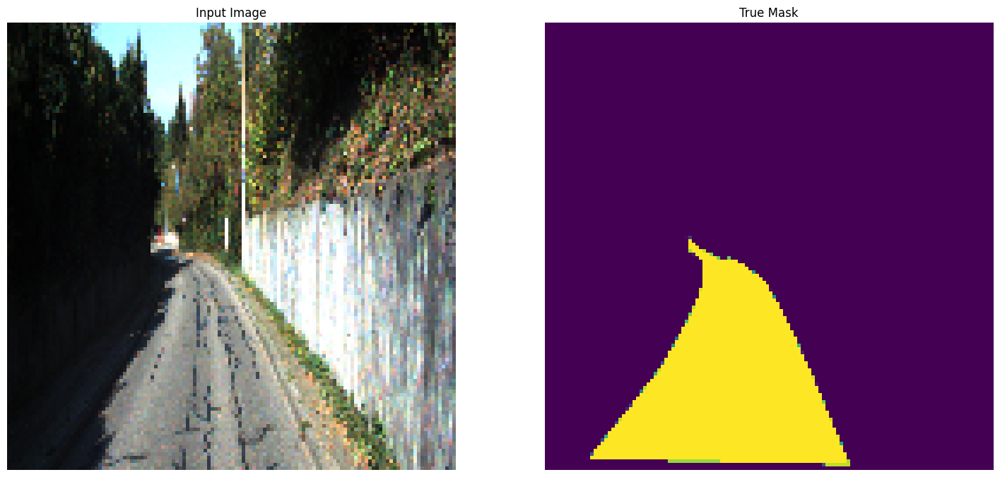

In [ ]:
# Function to view the images from the directory
def display_sample(display_list):
    plt.figure(figsize=(18, 18))

    title = ['Input Image', 'True Mask', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')

    plt.show()

for image, mask in dataset["train"].take(1):
    sample_image, sample_mask = image, mask

display_sample([sample_image[0], sample_mask[0]])

In [ ]:
# Get VGG-16 network as backbone
vgg16_model = VGG16()
vgg16_model.summary()

553467096/553467096 [==============================] - 15s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                           

In [ ]:
# Define input shape
input_shape = (IMG_SIZE, IMG_SIZE, N_CHANNELS)
# Generate a new model using the VGG network
# Input
inputs = Input(input_shape)

# VGG network
vgg16_model = VGG16(include_top = False, weights = 'imagenet', input_tensor = inputs)

# Encoder Layers
c1 = vgg16_model.get_layer("block3_pool").output
c2 = vgg16_model.get_layer("block4_pool").output
c3 = vgg16_model.get_layer("block5_pool").output

# Decoder
u1 = UpSampling2D((2, 2), interpolation = 'bilinear')(c3)
d1 = Concatenate()([u1, c2])

u2 = UpSampling2D((2, 2), interpolation = 'bilinear')(d1)
d2 = Concatenate()([u2, c1])

# Output
u3 = UpSampling2D((8, 8), interpolation = 'bilinear')(d2)
outputs = Conv2D(N_CLASSES, 1, activation = 'sigmoid')(u3)

model = Model(inputs, outputs, name = "VGG_FCN8")

58889256/58889256 [==============================] - 2s 0us/step


In [ ]:
m_iou = tf.keras.metrics.MeanIoU(2)
model.compile(optimizer=Adam(),
              loss=BinaryCrossentropy(),
              metrics=[m_iou])

1/1 [==============================] - 5s 5s/step


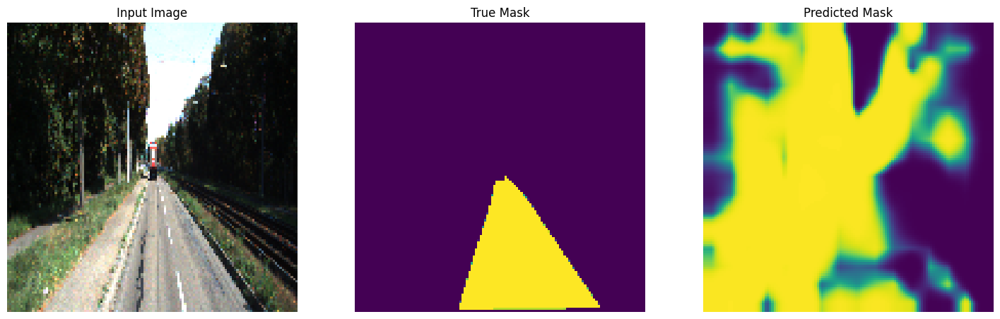

In [ ]:
# Function to create a mask out of network prediction
def create_mask(pred_mask: tf.Tensor) -> tf.Tensor:
    # Round to closest
    pred_mask = tf.math.round(pred_mask)

    # [IMG_SIZE, IMG_SIZE] -> [IMG_SIZE, IMG_SIZE, 1]
    pred_mask = tf.expand_dims(pred_mask, axis=-1)
    return pred_mask

# Function to show predictions
def show_predictions(dataset=None, num=1):
    if dataset:
        # Predict and show image from input dataset
        for image, mask in dataset.take(num):
            pred_mask = model.predict(image)
            display_sample([image[0], true_mask, create_mask(pred_mask)])
    else:
        # Predict and show the sample image
        inference = model.predict(sample_image)
        display_sample([sample_image[0], sample_mask[0],
                        inference[0]])

for image, mask in dataset['train'].take(1):
    sample_image, sample_mask = image, mask

show_predictions()

In [ ]:
# Callbacks and Logs
class DisplayCallback(callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        # clear_output(wait=True)
        show_predictions()
        print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

callbacks = [
    DisplayCallback(),
    callbacks.TensorBoard(logdir, histogram_freq = -1),
    # callbacks.EarlyStopping(patience = 10, verbose = 1),
    callbacks.EarlyStopping(monitor = 'val_loss', patience = 20),
    callbacks.ModelCheckpoint('best_model.h5', verbose = 1, save_best_only = True)
]


In [ ]:

# Set Variables
EPOCHS = 200
STEPS_PER_EPOCH = TRAINSET_SIZE // BATCH_SIZE
VALIDATION_STEPS = VALIDSET_SIZE // BATCH_SIZE
VALIDATION_STEPS = 1 if VALIDATION_STEPS <1 else VALIDATION_STEPS

Epoch 1/200
6/7 [========================>.....] - ETA: 0s - loss: 26.1704 - mse: 0.2973

1/1 [==============================] - 0s 26ms/step


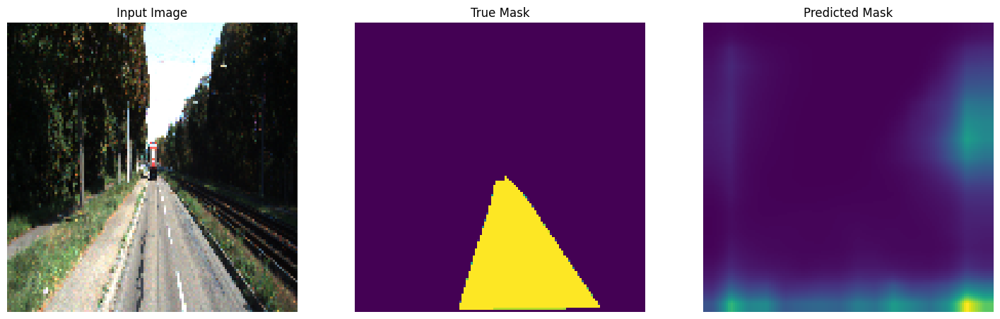


Sample Prediction after epoch 1


Epoch 1: val_loss improved from inf to 1.50943, saving model to best_model.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 50s 4s/step - loss: 22.5559 - mse: 0.2792 - val_loss: 1.5094 - val_mse: 0.1890
Epoch 2/200
1/1 [==============================] - 0s 22ms/step


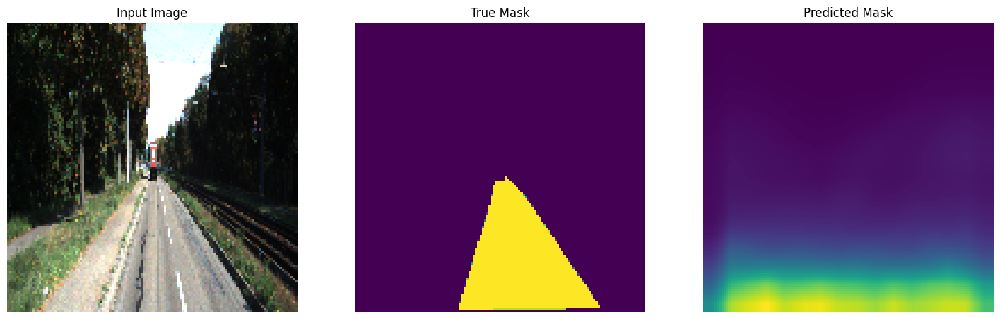


Sample Prediction after epoch 2


Epoch 2: val_loss improved from 1.50943 to 0.35774, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.7207 - mse: 0.1520 - val_loss: 0.3577 - val_mse: 0.1155
Epoch 3/200
1/1 [==============================] - 0s 22ms/step


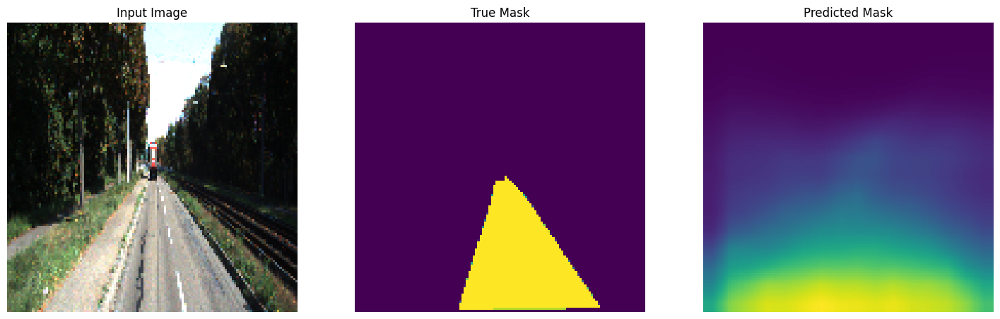


Sample Prediction after epoch 3


Epoch 3: val_loss improved from 0.35774 to 0.28565, saving model to best_model.h5
7/7 [==============================] - 26s 4s/step - loss: 0.3235 - mse: 0.1051 - val_loss: 0.2857 - val_mse: 0.0908
Epoch 4/200
1/1 [==============================] - 0s 27ms/step


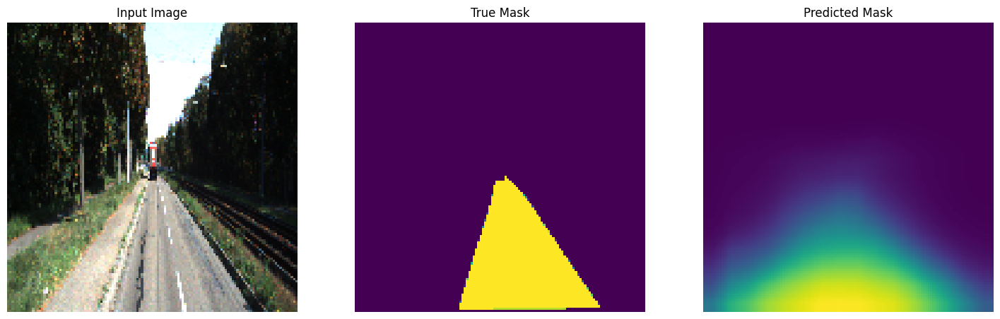


Sample Prediction after epoch 4


Epoch 4: val_loss improved from 0.28565 to 0.21601, saving model to best_model.h5
7/7 [==============================] - 23s 4s/step - loss: 0.2588 - mse: 0.0834 - val_loss: 0.2160 - val_mse: 0.0696
Epoch 5/200
1/1 [==============================] - 0s 22ms/step


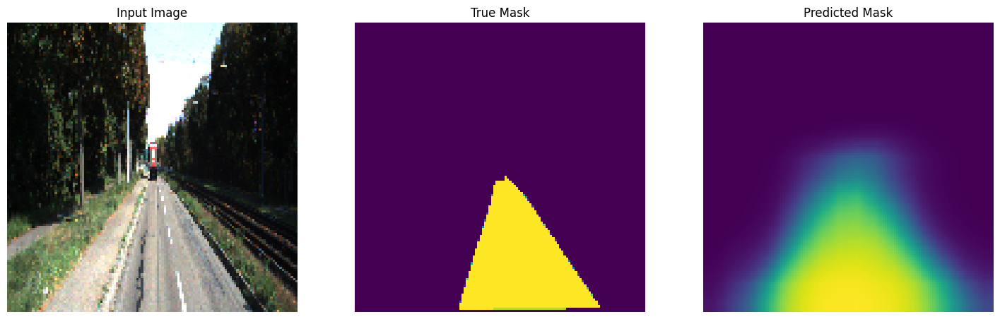


Sample Prediction after epoch 5


Epoch 5: val_loss did not improve from 0.21601
7/7 [==============================] - 18s 3s/step - loss: 0.2178 - mse: 0.0683 - val_loss: 0.2479 - val_mse: 0.0790
Epoch 6/200
1/1 [==============================] - 0s 21ms/step


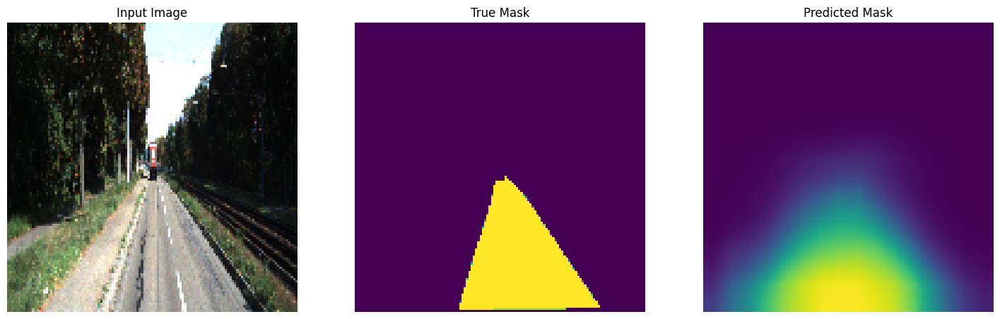


Sample Prediction after epoch 6


Epoch 6: val_loss improved from 0.21601 to 0.20287, saving model to best_model.h5
7/7 [==============================] - 32s 5s/step - loss: 0.2102 - mse: 0.0662 - val_loss: 0.2029 - val_mse: 0.0633
Epoch 7/200
1/1 [==============================] - 0s 20ms/step


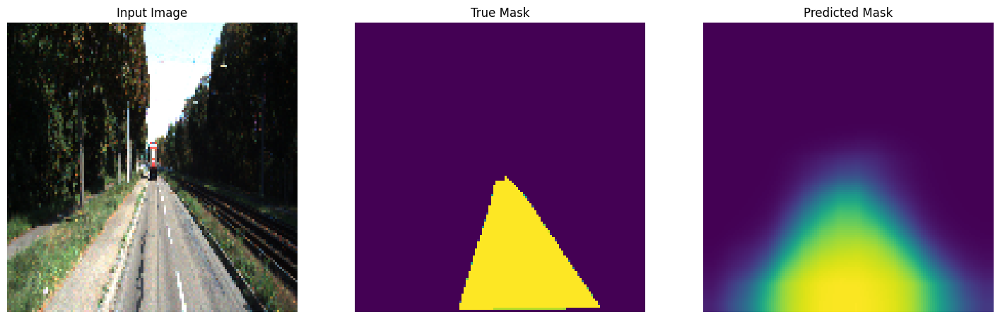


Sample Prediction after epoch 7


Epoch 7: val_loss improved from 0.20287 to 0.19835, saving model to best_model.h5
7/7 [==============================] - 27s 5s/step - loss: 0.1991 - mse: 0.0628 - val_loss: 0.1984 - val_mse: 0.0618
Epoch 8/200
1/1 [==============================] - 0s 22ms/step


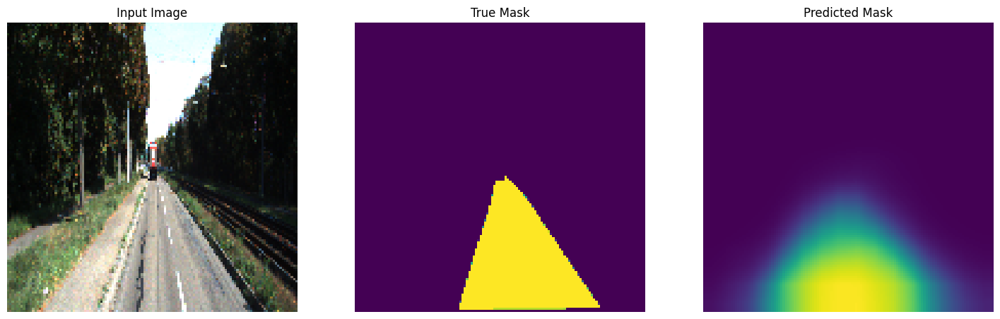


Sample Prediction after epoch 8


Epoch 8: val_loss did not improve from 0.19835
7/7 [==============================] - 21s 4s/step - loss: 0.1994 - mse: 0.0632 - val_loss: 0.2057 - val_mse: 0.0648
Epoch 9/200
1/1 [==============================] - 0s 20ms/step


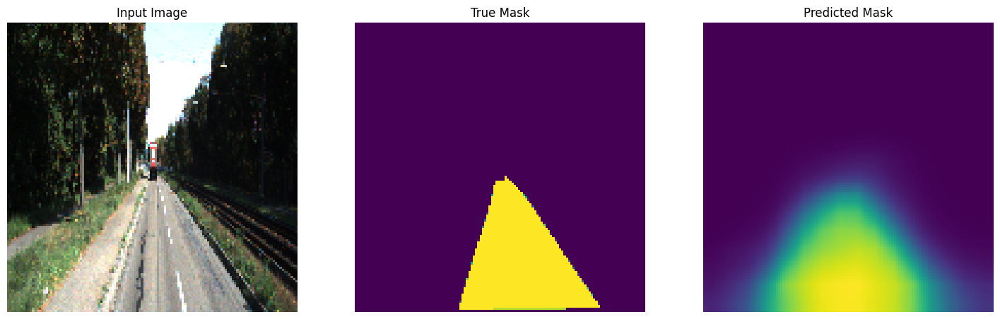


Sample Prediction after epoch 9


Epoch 9: val_loss improved from 0.19835 to 0.18577, saving model to best_model.h5
7/7 [==============================] - 19s 3s/step - loss: 0.1959 - mse: 0.0614 - val_loss: 0.1858 - val_mse: 0.0579
Epoch 10/200
1/1 [==============================] - 0s 20ms/step


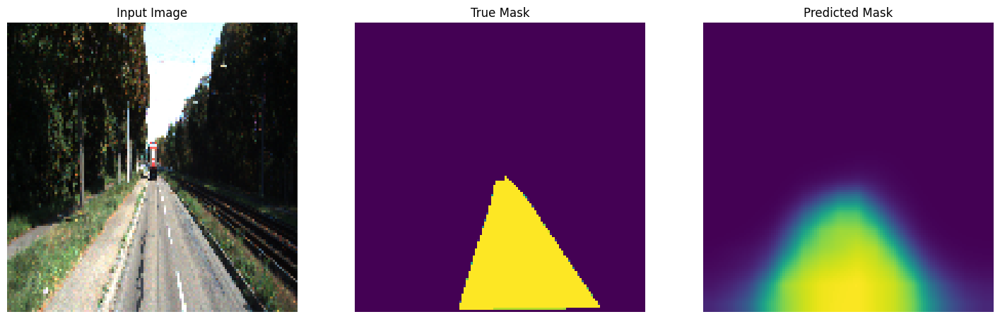


Sample Prediction after epoch 10


Epoch 10: val_loss improved from 0.18577 to 0.17161, saving model to best_model.h5
7/7 [==============================] - 30s 5s/step - loss: 0.1802 - mse: 0.0565 - val_loss: 0.1716 - val_mse: 0.0541
Epoch 11/200
1/1 [==============================] - 0s 27ms/step


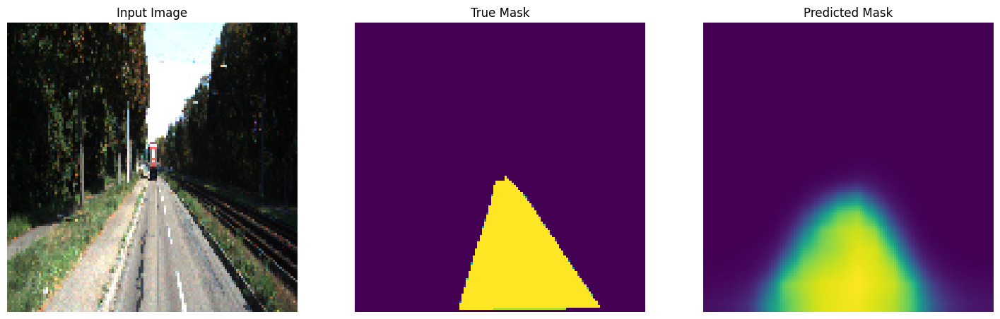


Sample Prediction after epoch 11


Epoch 11: val_loss improved from 0.17161 to 0.15364, saving model to best_model.h5
7/7 [==============================] - 23s 4s/step - loss: 0.1655 - mse: 0.0514 - val_loss: 0.1536 - val_mse: 0.0472
Epoch 12/200
1/1 [==============================] - 0s 22ms/step


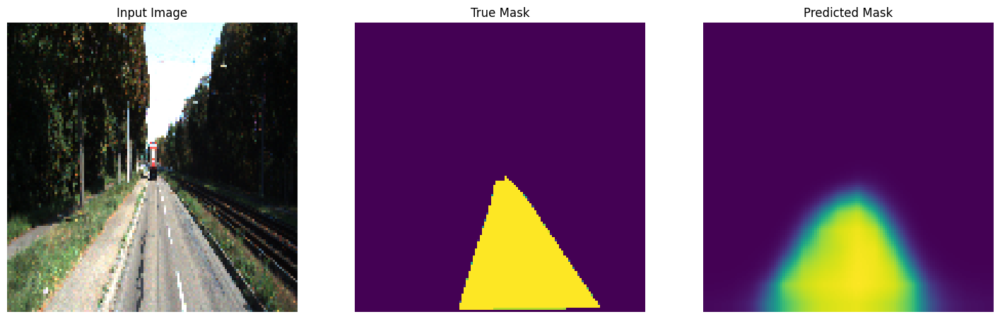


Sample Prediction after epoch 12


Epoch 12: val_loss improved from 0.15364 to 0.13716, saving model to best_model.h5
7/7 [==============================] - 22s 4s/step - loss: 0.1564 - mse: 0.0481 - val_loss: 0.1372 - val_mse: 0.0429
Epoch 13/200
1/1 [==============================] - 0s 20ms/step


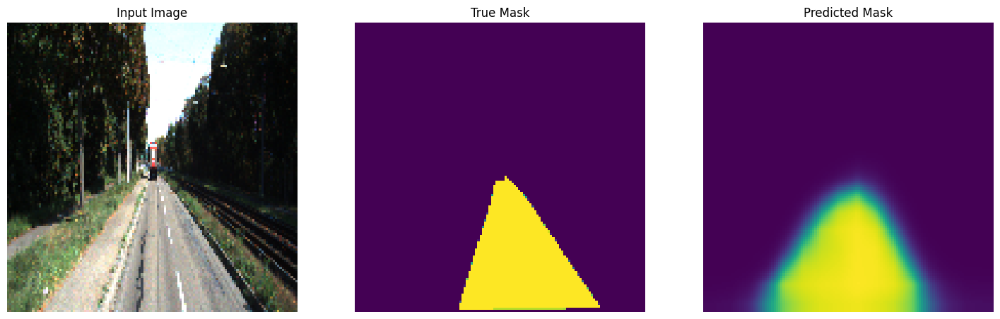


Sample Prediction after epoch 13


Epoch 13: val_loss did not improve from 0.13716
7/7 [==============================] - 26s 4s/step - loss: 0.1415 - mse: 0.0438 - val_loss: 0.1480 - val_mse: 0.0466
Epoch 14/200
1/1 [==============================] - 0s 20ms/step


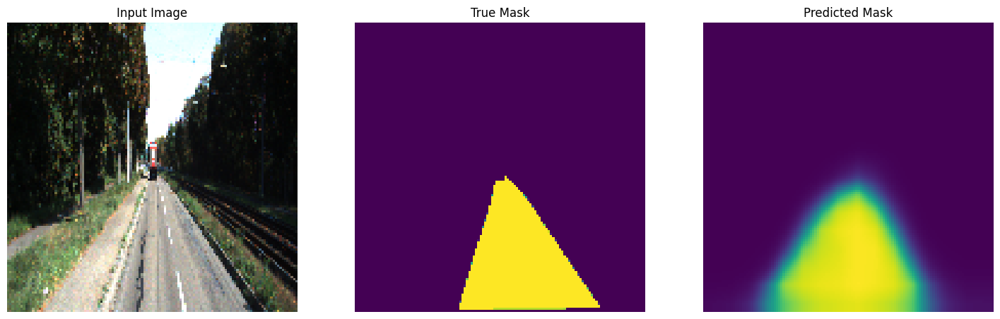


Sample Prediction after epoch 14


Epoch 14: val_loss improved from 0.13716 to 0.12755, saving model to best_model.h5
7/7 [==============================] - 23s 4s/step - loss: 0.1476 - mse: 0.0456 - val_loss: 0.1276 - val_mse: 0.0380
Epoch 15/200
1/1 [==============================] - 0s 20ms/step


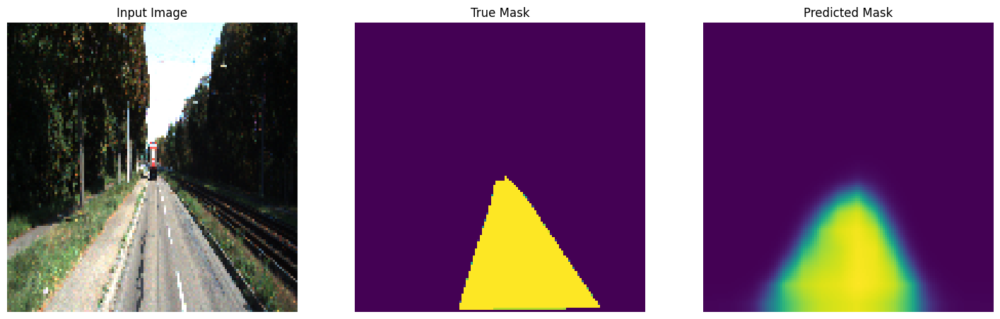


Sample Prediction after epoch 15


Epoch 15: val_loss did not improve from 0.12755
7/7 [==============================] - 26s 4s/step - loss: 0.1382 - mse: 0.0431 - val_loss: 0.1299 - val_mse: 0.0400
Epoch 16/200
1/1 [==============================] - 0s 27ms/step


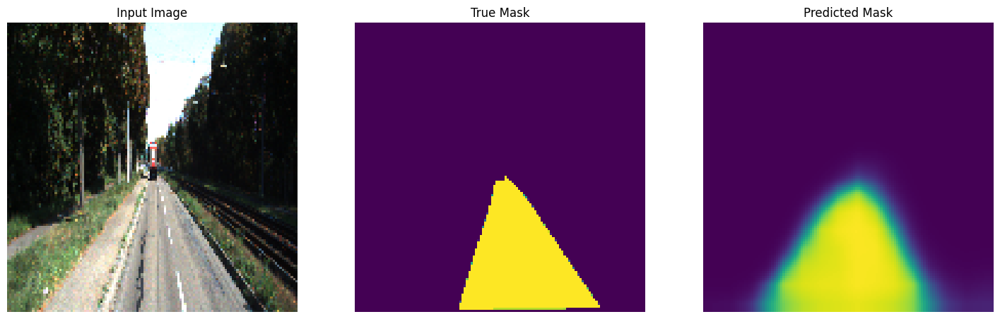


Sample Prediction after epoch 16


Epoch 16: val_loss did not improve from 0.12755
7/7 [==============================] - 23s 4s/step - loss: 0.1373 - mse: 0.0420 - val_loss: 0.1447 - val_mse: 0.0451
Epoch 17/200
1/1 [==============================] - 0s 20ms/step


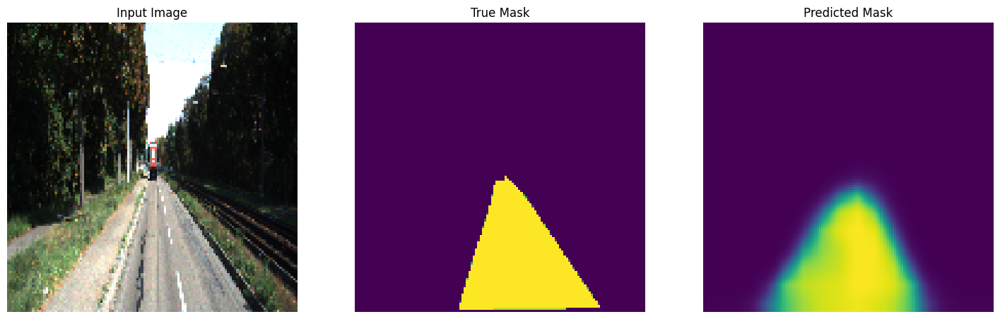


Sample Prediction after epoch 17


Epoch 17: val_loss improved from 0.12755 to 0.12335, saving model to best_model.h5
7/7 [==============================] - 22s 4s/step - loss: 0.1357 - mse: 0.0417 - val_loss: 0.1233 - val_mse: 0.0382
Epoch 18/200
1/1 [==============================] - 0s 19ms/step


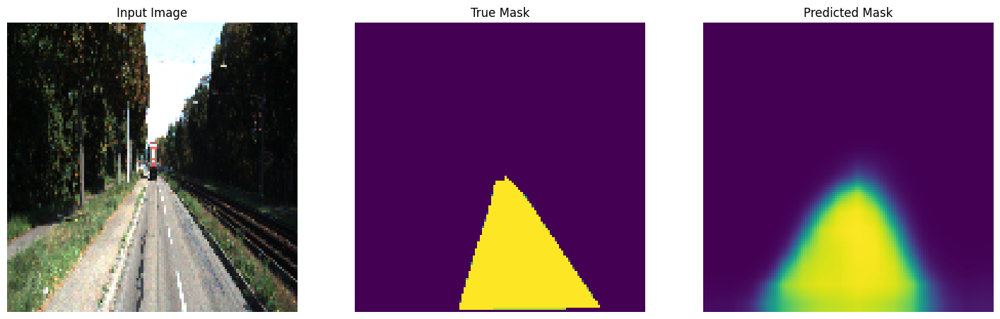


Sample Prediction after epoch 18


Epoch 18: val_loss did not improve from 0.12335
7/7 [==============================] - 26s 4s/step - loss: 0.1376 - mse: 0.0425 - val_loss: 0.1370 - val_mse: 0.0416
Epoch 19/200
1/1 [==============================] - 0s 19ms/step


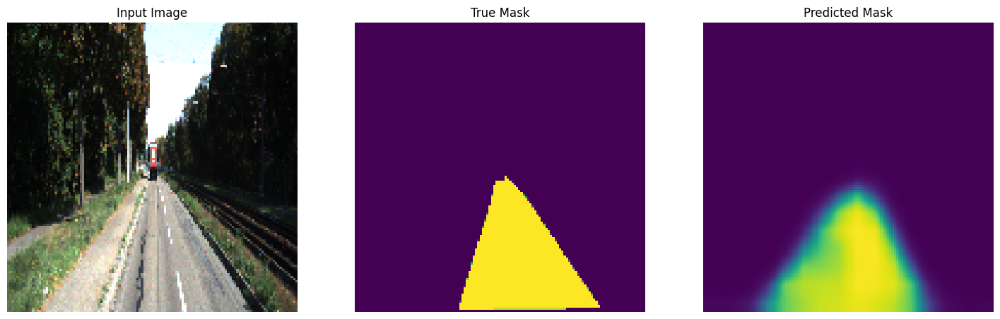


Sample Prediction after epoch 19


Epoch 19: val_loss did not improve from 0.12335
7/7 [==============================] - 27s 4s/step - loss: 0.1379 - mse: 0.0423 - val_loss: 0.1288 - val_mse: 0.0398
Epoch 20/200
1/1 [==============================] - 0s 28ms/step


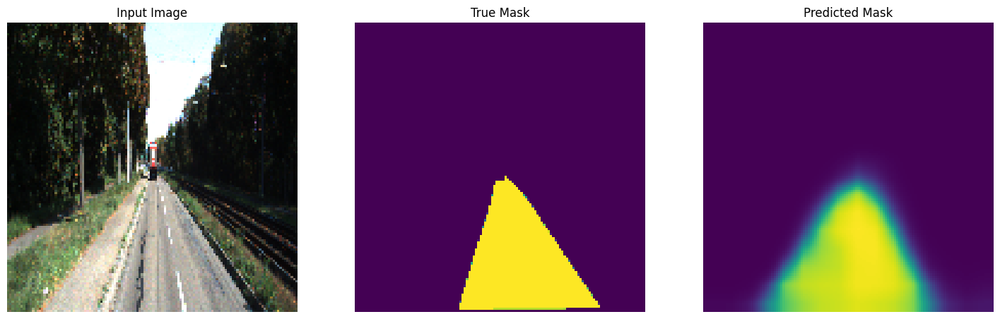


Sample Prediction after epoch 20


Epoch 20: val_loss did not improve from 0.12335
7/7 [==============================] - 30s 5s/step - loss: 0.1289 - mse: 0.0396 - val_loss: 0.1436 - val_mse: 0.0449
Epoch 21/200
1/1 [==============================] - 0s 83ms/step


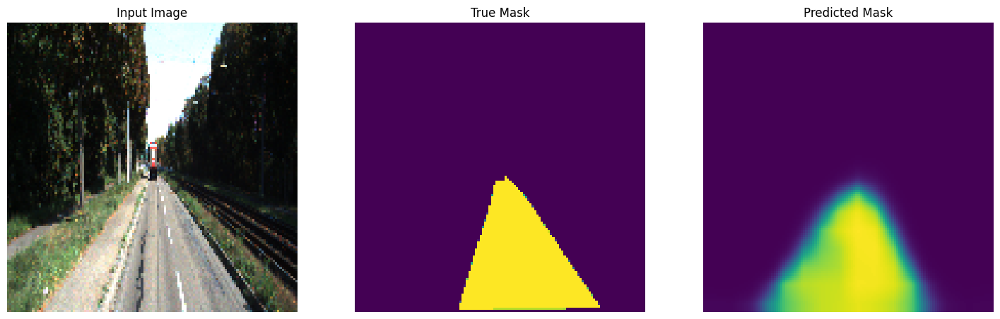


Sample Prediction after epoch 21


Epoch 21: val_loss did not improve from 0.12335
7/7 [==============================] - 24s 4s/step - loss: 0.1281 - mse: 0.0390 - val_loss: 0.1313 - val_mse: 0.0399
Epoch 22/200
1/1 [==============================] - 0s 19ms/step


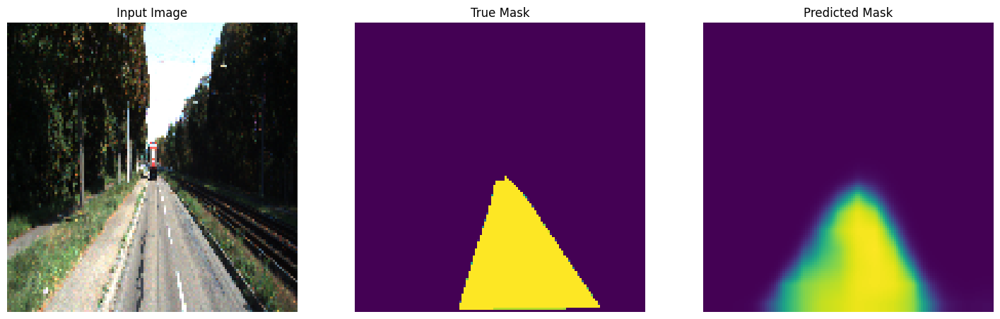


Sample Prediction after epoch 22


Epoch 22: val_loss did not improve from 0.12335
7/7 [==============================] - 27s 4s/step - loss: 0.1247 - mse: 0.0381 - val_loss: 0.1359 - val_mse: 0.0415
Epoch 23/200
1/1 [==============================] - 0s 21ms/step


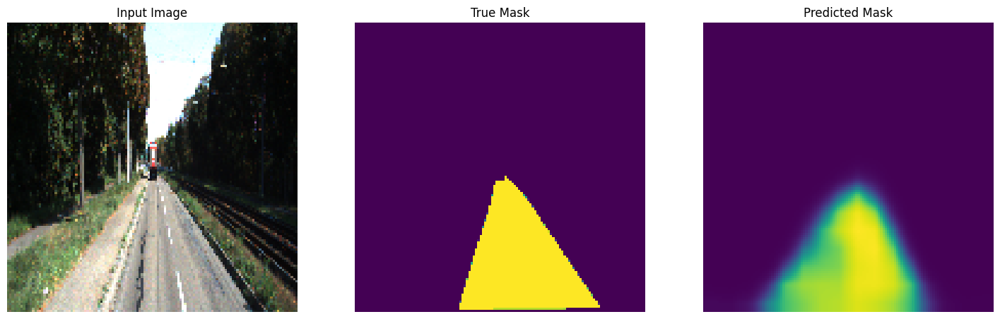


Sample Prediction after epoch 23


Epoch 23: val_loss improved from 0.12335 to 0.11848, saving model to best_model.h5
7/7 [==============================] - 21s 3s/step - loss: 0.1257 - mse: 0.0385 - val_loss: 0.1185 - val_mse: 0.0362
Epoch 24/200
1/1 [==============================] - 0s 20ms/step


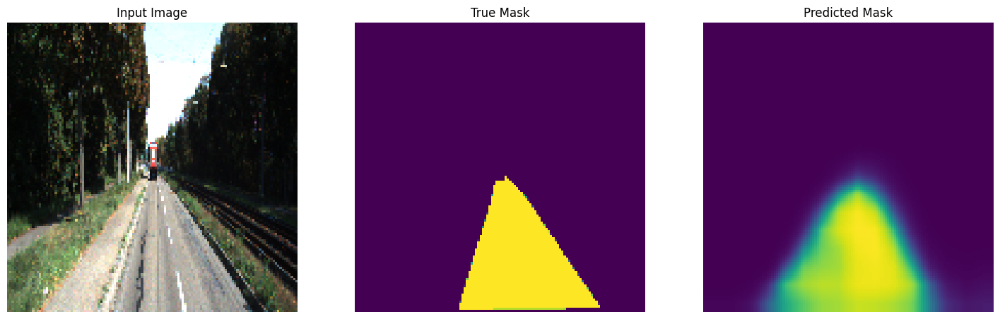


Sample Prediction after epoch 24


Epoch 24: val_loss did not improve from 0.11848
7/7 [==============================] - 26s 4s/step - loss: 0.1367 - mse: 0.0416 - val_loss: 0.1235 - val_mse: 0.0373
Epoch 25/200
1/1 [==============================] - 0s 19ms/step


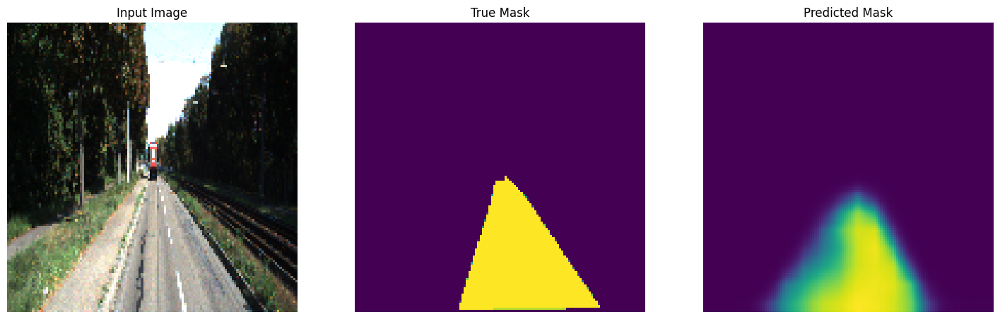


Sample Prediction after epoch 25


Epoch 25: val_loss did not improve from 0.11848
7/7 [==============================] - 26s 4s/step - loss: 0.1370 - mse: 0.0421 - val_loss: 0.1548 - val_mse: 0.0466
Epoch 26/200
1/1 [==============================] - 0s 26ms/step


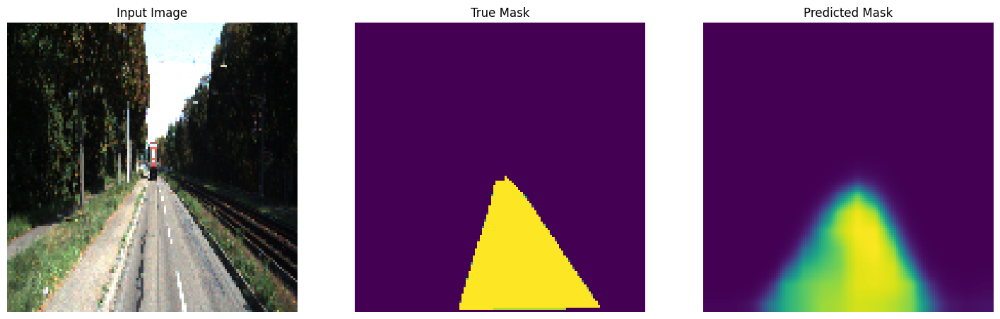


Sample Prediction after epoch 26


Epoch 26: val_loss did not improve from 0.11848
7/7 [==============================] - 23s 4s/step - loss: 0.1490 - mse: 0.0462 - val_loss: 0.1341 - val_mse: 0.0418
Epoch 27/200
1/1 [==============================] - 0s 19ms/step


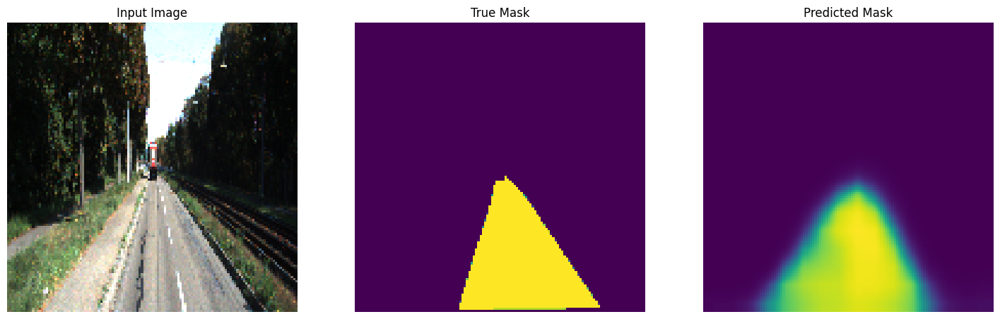


Sample Prediction after epoch 27


Epoch 27: val_loss did not improve from 0.11848
7/7 [==============================] - 22s 4s/step - loss: 0.1345 - mse: 0.0407 - val_loss: 0.1242 - val_mse: 0.0380
Epoch 28/200
1/1 [==============================] - 0s 21ms/step


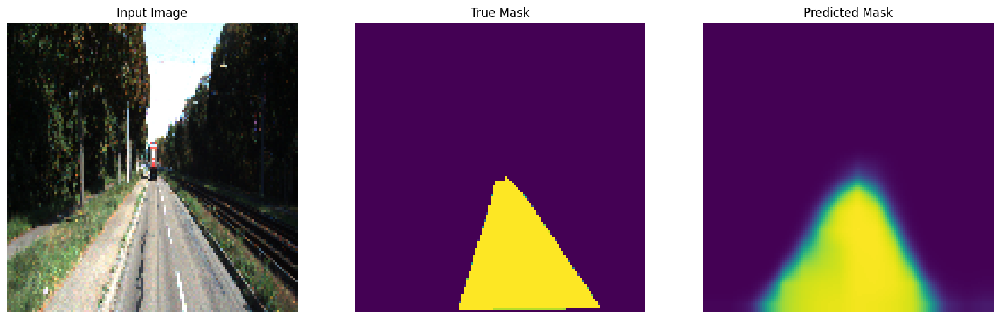


Sample Prediction after epoch 28


Epoch 28: val_loss did not improve from 0.11848
7/7 [==============================] - 27s 4s/step - loss: 0.1297 - mse: 0.0392 - val_loss: 0.1282 - val_mse: 0.0394
Epoch 29/200
1/1 [==============================] - 0s 22ms/step


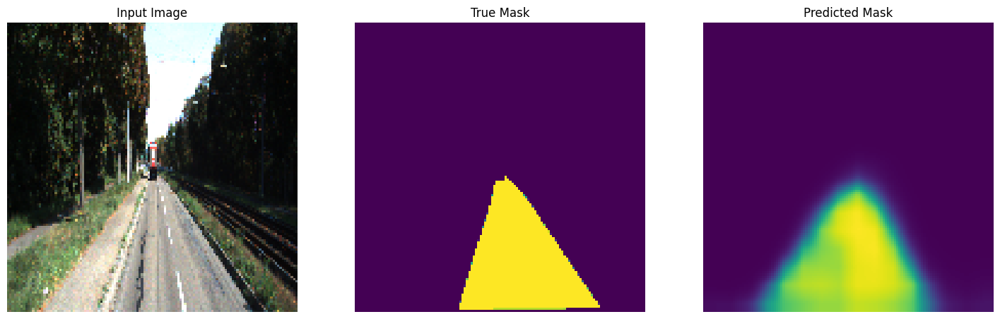


Sample Prediction after epoch 29


Epoch 29: val_loss improved from 0.11848 to 0.11532, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.1316 - mse: 0.0404 - val_loss: 0.1153 - val_mse: 0.0335
Epoch 30/200
1/1 [==============================] - 0s 20ms/step


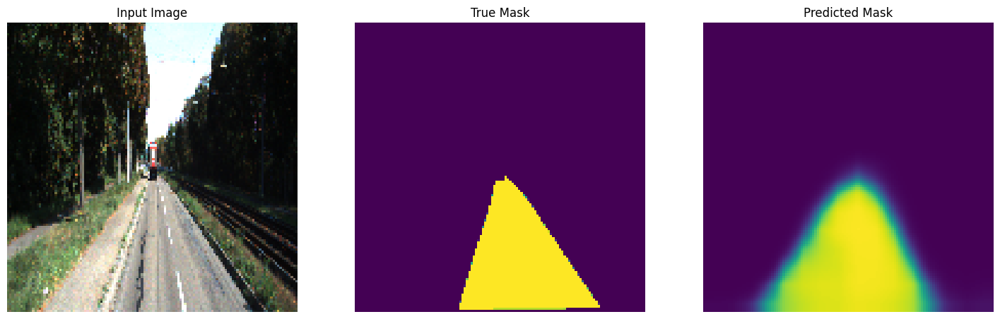


Sample Prediction after epoch 30


Epoch 30: val_loss did not improve from 0.11532
7/7 [==============================] - 27s 4s/step - loss: 0.1343 - mse: 0.0402 - val_loss: 0.1186 - val_mse: 0.0362
Epoch 31/200
1/1 [==============================] - 0s 19ms/step


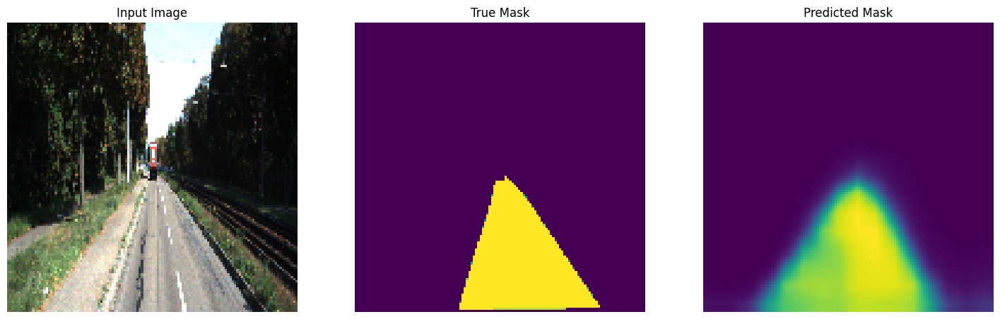


Sample Prediction after epoch 31


Epoch 31: val_loss did not improve from 0.11532
7/7 [==============================] - 27s 4s/step - loss: 0.1352 - mse: 0.0415 - val_loss: 0.1207 - val_mse: 0.0358
Epoch 32/200
1/1 [==============================] - 0s 19ms/step


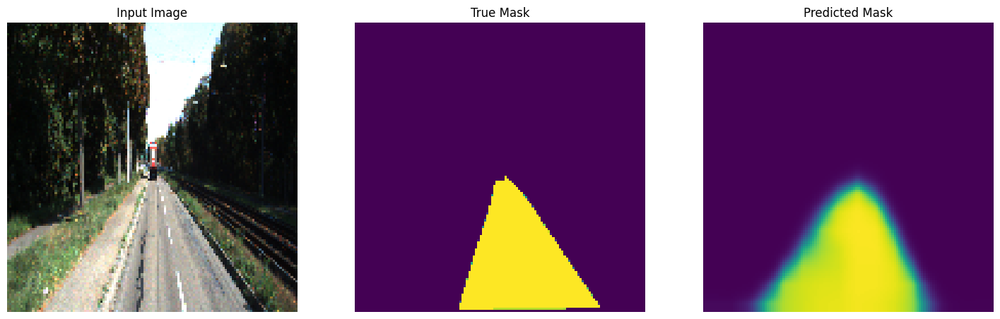


Sample Prediction after epoch 32


Epoch 32: val_loss did not improve from 0.11532
7/7 [==============================] - 27s 4s/step - loss: 0.1255 - mse: 0.0378 - val_loss: 0.1178 - val_mse: 0.0355
Epoch 33/200
1/1 [==============================] - 0s 20ms/step


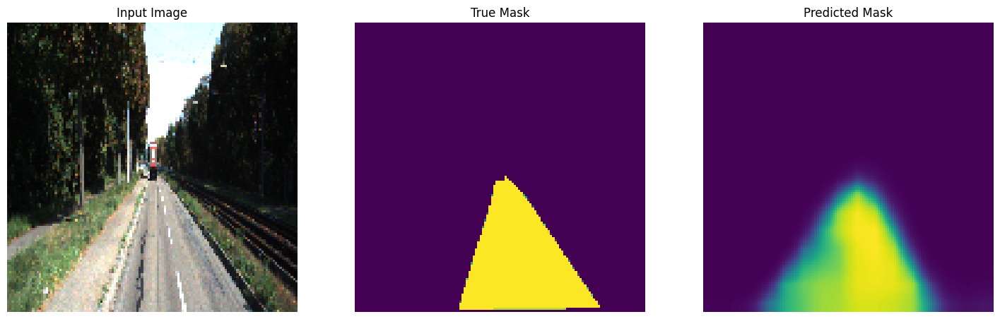


Sample Prediction after epoch 33


Epoch 33: val_loss did not improve from 0.11532
7/7 [==============================] - 21s 4s/step - loss: 0.1256 - mse: 0.0382 - val_loss: 0.1166 - val_mse: 0.0348
Epoch 34/200
1/1 [==============================] - 0s 27ms/step


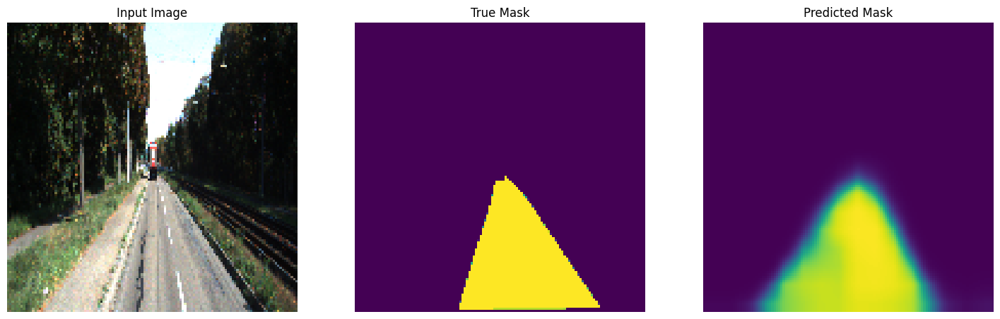


Sample Prediction after epoch 34


Epoch 34: val_loss did not improve from 0.11532
7/7 [==============================] - 23s 4s/step - loss: 0.1200 - mse: 0.0364 - val_loss: 0.1167 - val_mse: 0.0356
Epoch 35/200
1/1 [==============================] - 0s 21ms/step


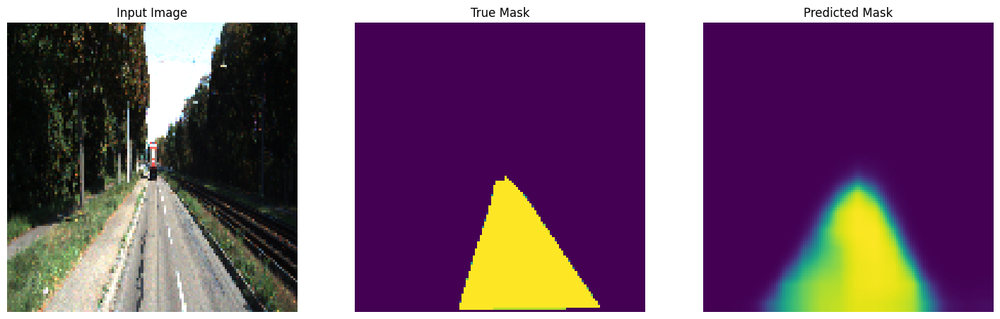


Sample Prediction after epoch 35


Epoch 35: val_loss did not improve from 0.11532
7/7 [==============================] - 26s 4s/step - loss: 0.1211 - mse: 0.0366 - val_loss: 0.1174 - val_mse: 0.0360
Epoch 36/200
1/1 [==============================] - 0s 19ms/step


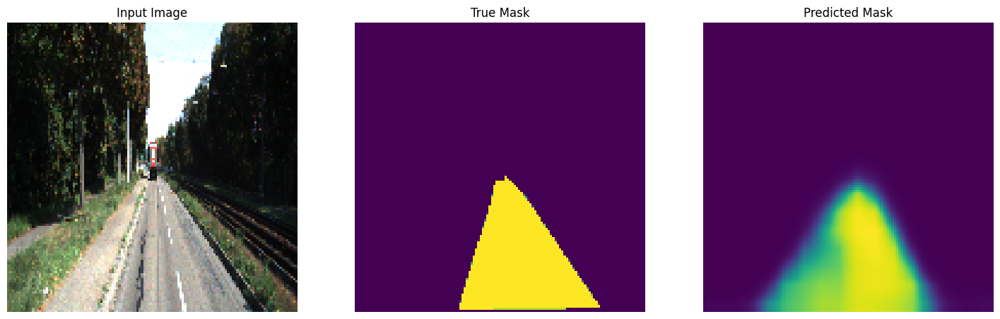


Sample Prediction after epoch 36


Epoch 36: val_loss improved from 0.11532 to 0.10923, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.1126 - mse: 0.0339 - val_loss: 0.1092 - val_mse: 0.0332
Epoch 37/200
1/1 [==============================] - 0s 20ms/step


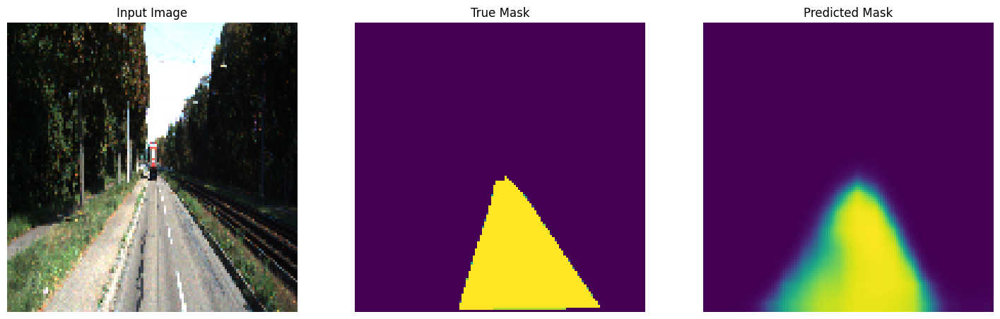


Sample Prediction after epoch 37


Epoch 37: val_loss improved from 0.10923 to 0.10880, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.1134 - mse: 0.0342 - val_loss: 0.1088 - val_mse: 0.0327
Epoch 38/200
1/1 [==============================] - 0s 20ms/step


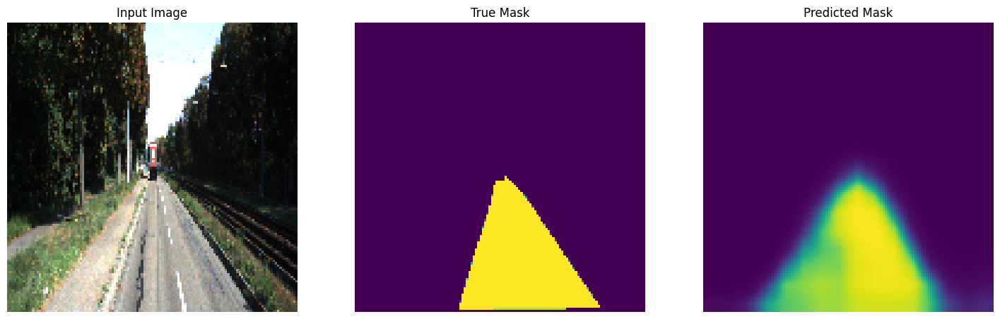


Sample Prediction after epoch 38


Epoch 38: val_loss did not improve from 0.10880
7/7 [==============================] - 26s 4s/step - loss: 0.1105 - mse: 0.0330 - val_loss: 0.1115 - val_mse: 0.0338
Epoch 39/200
1/1 [==============================] - 0s 24ms/step


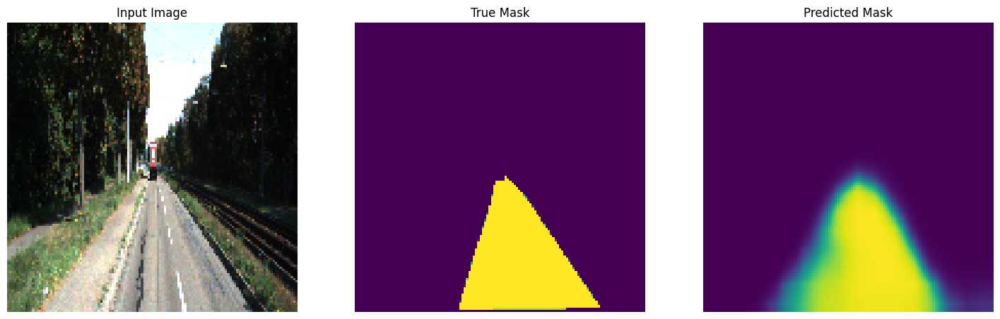


Sample Prediction after epoch 39


Epoch 39: val_loss did not improve from 0.10880
7/7 [==============================] - 27s 4s/step - loss: 0.1157 - mse: 0.0348 - val_loss: 0.1197 - val_mse: 0.0366
Epoch 40/200
1/1 [==============================] - 0s 19ms/step


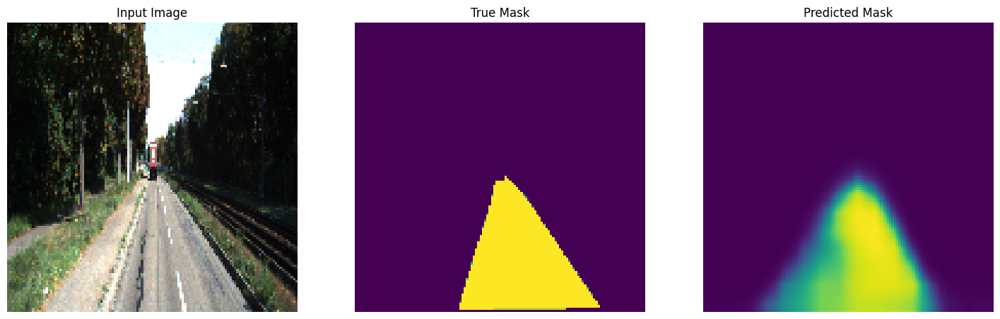


Sample Prediction after epoch 40


Epoch 40: val_loss improved from 0.10880 to 0.10527, saving model to best_model.h5
7/7 [==============================] - 21s 3s/step - loss: 0.1168 - mse: 0.0356 - val_loss: 0.1053 - val_mse: 0.0310
Epoch 41/200
1/1 [==============================] - 0s 20ms/step


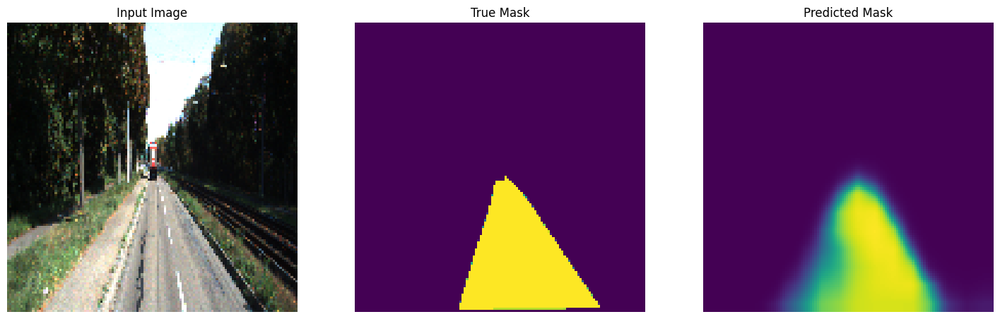


Sample Prediction after epoch 41


Epoch 41: val_loss did not improve from 0.10527
7/7 [==============================] - 26s 4s/step - loss: 0.1107 - mse: 0.0333 - val_loss: 0.1219 - val_mse: 0.0353
Epoch 42/200
1/1 [==============================] - 0s 20ms/step


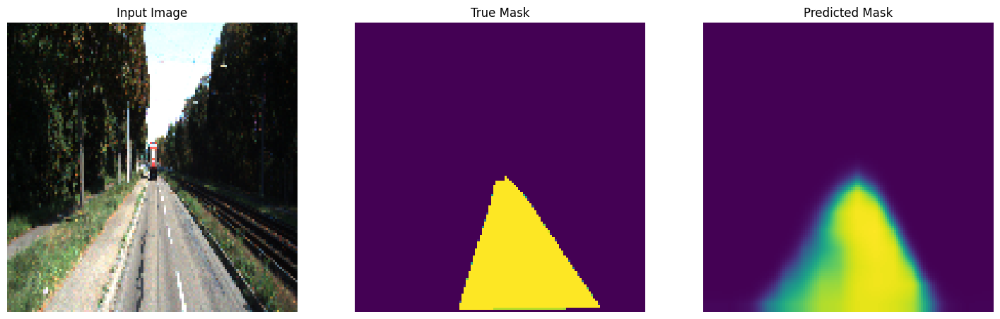


Sample Prediction after epoch 42


Epoch 42: val_loss did not improve from 0.10527
7/7 [==============================] - 26s 4s/step - loss: 0.1089 - mse: 0.0322 - val_loss: 0.1065 - val_mse: 0.0310
Epoch 43/200
1/1 [==============================] - 0s 19ms/step


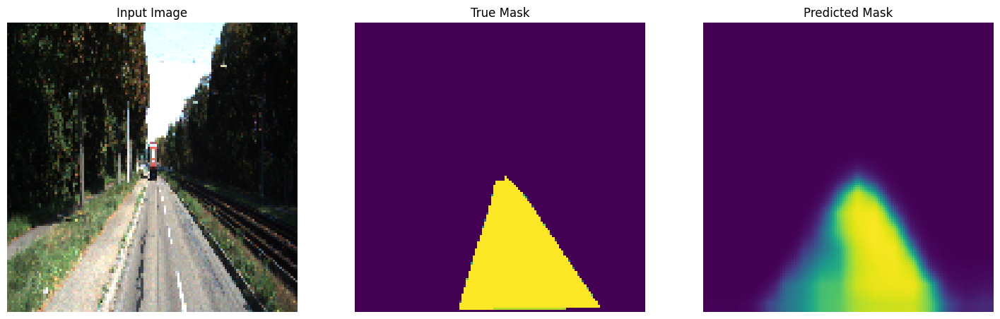


Sample Prediction after epoch 43


Epoch 43: val_loss did not improve from 0.10527
7/7 [==============================] - 21s 3s/step - loss: 0.1120 - mse: 0.0336 - val_loss: 0.1182 - val_mse: 0.0358
Epoch 44/200
1/1 [==============================] - 0s 20ms/step


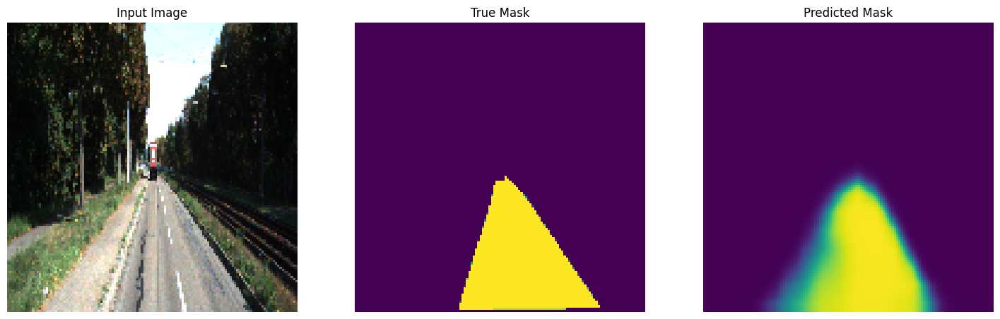


Sample Prediction after epoch 44


Epoch 44: val_loss did not improve from 0.10527
7/7 [==============================] - 26s 4s/step - loss: 0.1069 - mse: 0.0317 - val_loss: 0.1105 - val_mse: 0.0314
Epoch 45/200
1/1 [==============================] - 0s 20ms/step


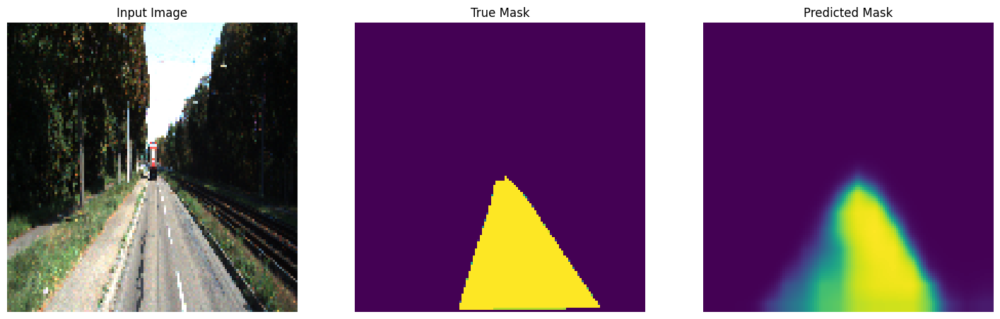


Sample Prediction after epoch 45


Epoch 45: val_loss improved from 0.10527 to 0.09720, saving model to best_model.h5
7/7 [==============================] - 21s 3s/step - loss: 0.1059 - mse: 0.0315 - val_loss: 0.0972 - val_mse: 0.0287
Epoch 46/200
1/1 [==============================] - 0s 20ms/step


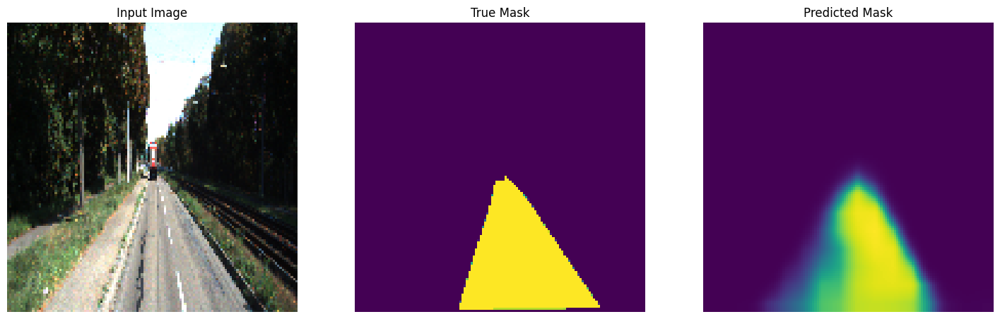


Sample Prediction after epoch 46


Epoch 46: val_loss did not improve from 0.09720
7/7 [==============================] - 21s 3s/step - loss: 0.1054 - mse: 0.0309 - val_loss: 0.1027 - val_mse: 0.0299
Epoch 47/200
1/1 [==============================] - 0s 23ms/step


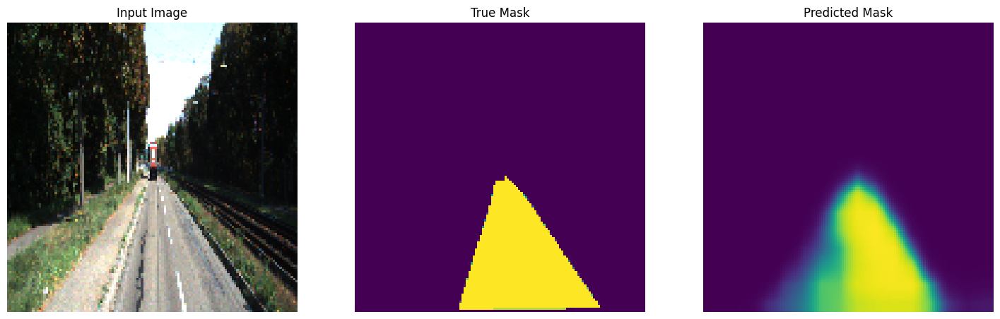


Sample Prediction after epoch 47


Epoch 47: val_loss did not improve from 0.09720
7/7 [==============================] - 20s 3s/step - loss: 0.1088 - mse: 0.0326 - val_loss: 0.1020 - val_mse: 0.0307
Epoch 48/200
1/1 [==============================] - 0s 22ms/step


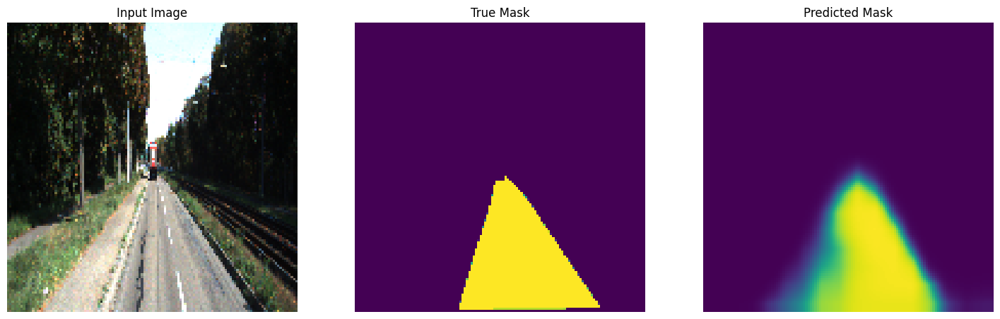


Sample Prediction after epoch 48


Epoch 48: val_loss improved from 0.09720 to 0.09486, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.1029 - mse: 0.0305 - val_loss: 0.0949 - val_mse: 0.0277
Epoch 49/200
1/1 [==============================] - 0s 20ms/step


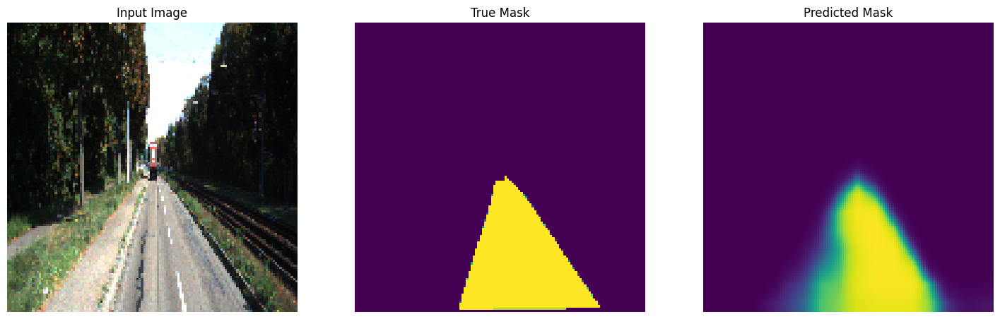


Sample Prediction after epoch 49


Epoch 49: val_loss did not improve from 0.09486
7/7 [==============================] - 21s 3s/step - loss: 0.0989 - mse: 0.0292 - val_loss: 0.1040 - val_mse: 0.0303
Epoch 50/200
1/1 [==============================] - 0s 20ms/step


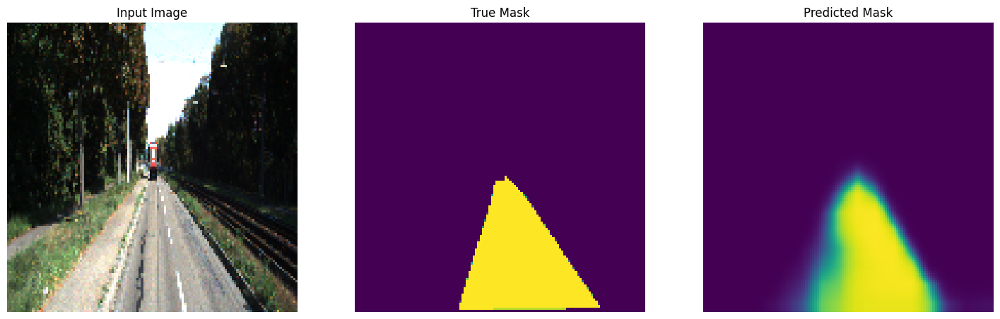


Sample Prediction after epoch 50


Epoch 50: val_loss did not improve from 0.09486
7/7 [==============================] - 26s 4s/step - loss: 0.0974 - mse: 0.0286 - val_loss: 0.1104 - val_mse: 0.0309
Epoch 51/200
1/1 [==============================] - 0s 19ms/step


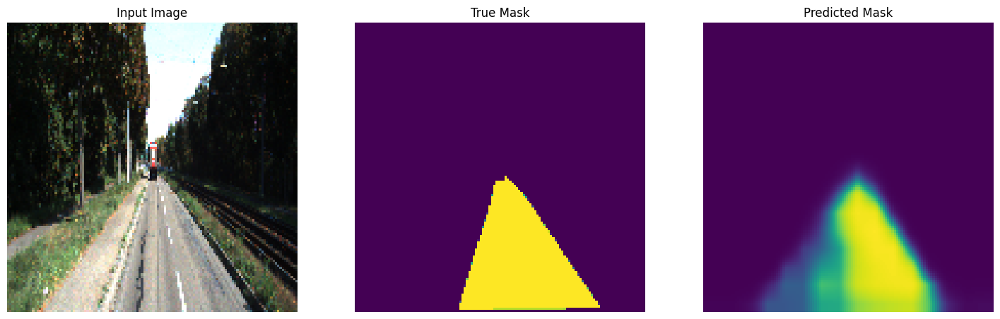


Sample Prediction after epoch 51


Epoch 51: val_loss improved from 0.09486 to 0.09292, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0992 - mse: 0.0291 - val_loss: 0.0929 - val_mse: 0.0272
Epoch 52/200
1/1 [==============================] - 0s 19ms/step


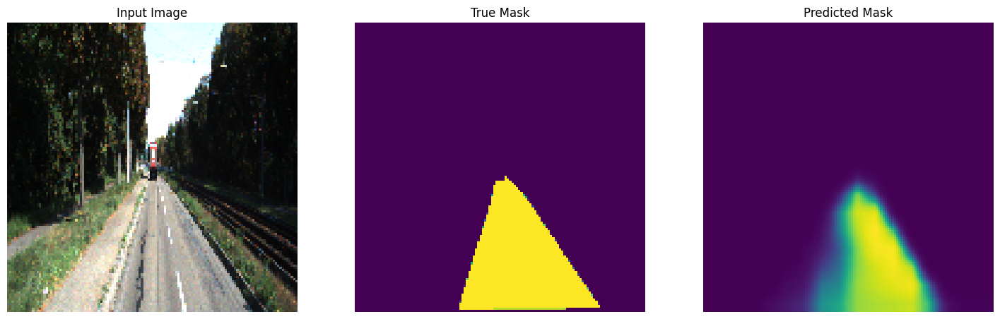


Sample Prediction after epoch 52


Epoch 52: val_loss did not improve from 0.09292
7/7 [==============================] - 21s 3s/step - loss: 0.1062 - mse: 0.0314 - val_loss: 0.1226 - val_mse: 0.0361
Epoch 53/200
1/1 [==============================] - 0s 21ms/step


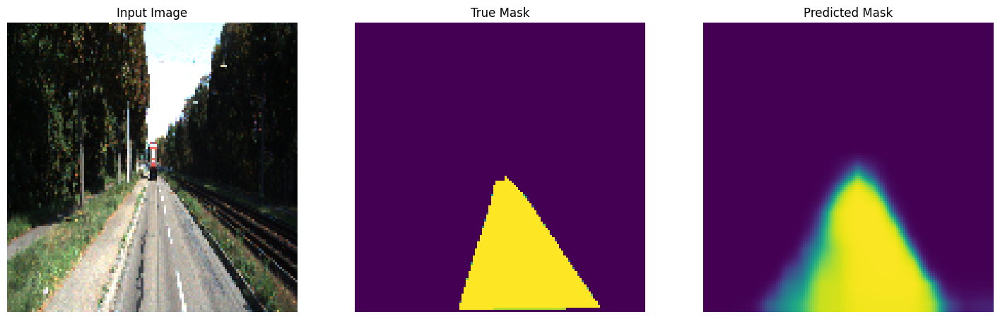


Sample Prediction after epoch 53


Epoch 53: val_loss did not improve from 0.09292
7/7 [==============================] - 26s 4s/step - loss: 0.1094 - mse: 0.0323 - val_loss: 0.1094 - val_mse: 0.0334
Epoch 54/200
1/1 [==============================] - 0s 20ms/step


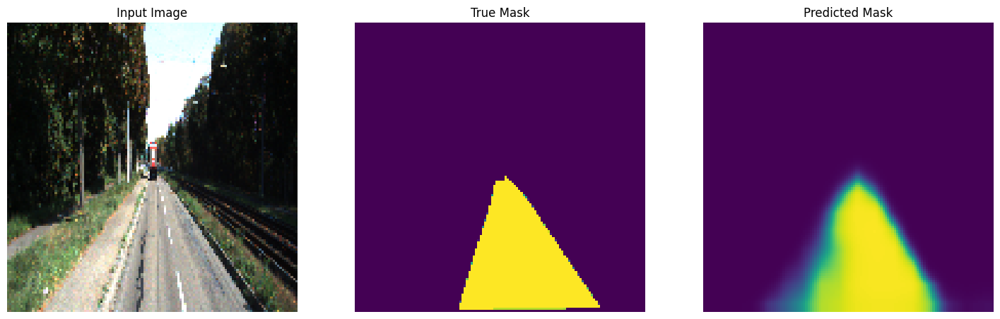


Sample Prediction after epoch 54


Epoch 54: val_loss improved from 0.09292 to 0.09063, saving model to best_model.h5
7/7 [==============================] - 22s 4s/step - loss: 0.0990 - mse: 0.0294 - val_loss: 0.0906 - val_mse: 0.0267
Epoch 55/200
1/1 [==============================] - 0s 22ms/step


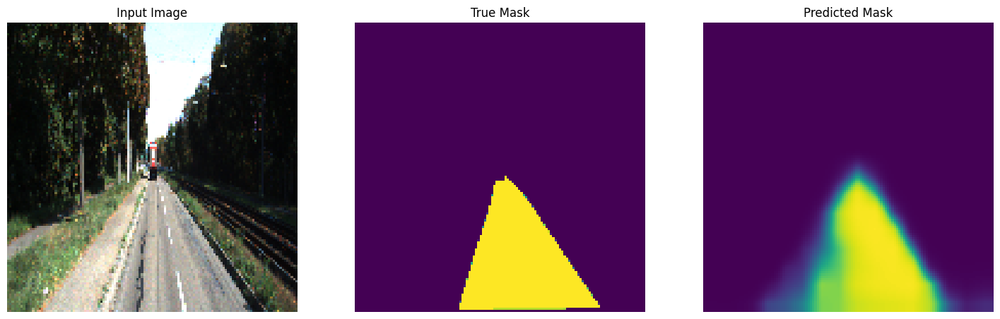


Sample Prediction after epoch 55


Epoch 55: val_loss did not improve from 0.09063
7/7 [==============================] - 26s 4s/step - loss: 0.0959 - mse: 0.0280 - val_loss: 0.0919 - val_mse: 0.0271
Epoch 56/200
1/1 [==============================] - 0s 19ms/step


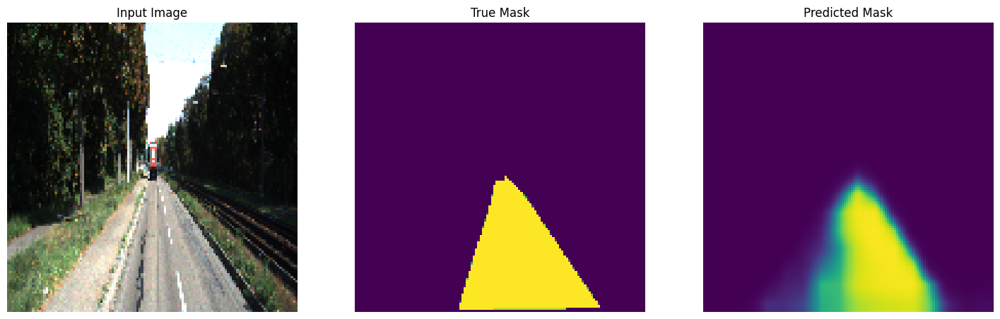


Sample Prediction after epoch 56


Epoch 56: val_loss did not improve from 0.09063
7/7 [==============================] - 21s 4s/step - loss: 0.1024 - mse: 0.0301 - val_loss: 0.0934 - val_mse: 0.0274
Epoch 57/200
1/1 [==============================] - 0s 20ms/step


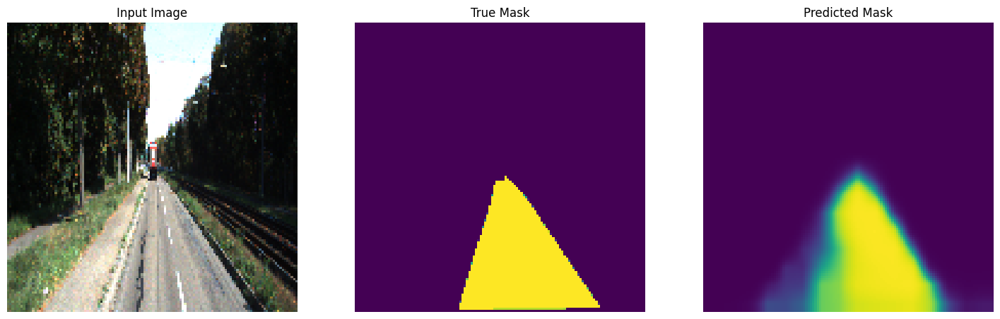


Sample Prediction after epoch 57


Epoch 57: val_loss did not improve from 0.09063
7/7 [==============================] - 26s 4s/step - loss: 0.0953 - mse: 0.0283 - val_loss: 0.0959 - val_mse: 0.0283
Epoch 58/200
1/1 [==============================] - 0s 20ms/step


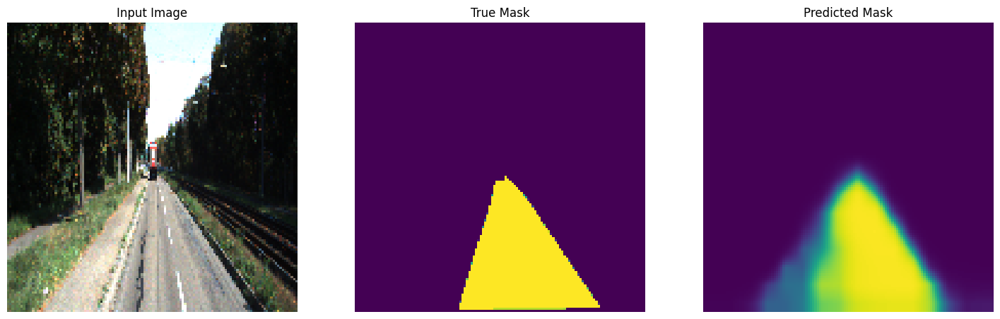


Sample Prediction after epoch 58


Epoch 58: val_loss did not improve from 0.09063
7/7 [==============================] - 26s 4s/step - loss: 0.1069 - mse: 0.0322 - val_loss: 0.0991 - val_mse: 0.0299
Epoch 59/200
1/1 [==============================] - 0s 20ms/step


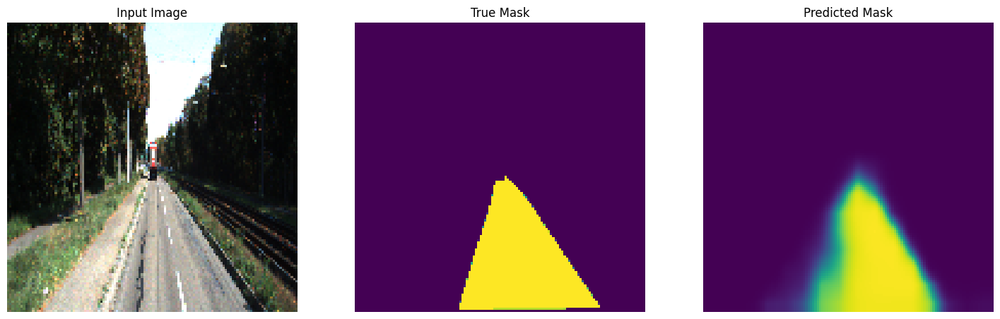


Sample Prediction after epoch 59


Epoch 59: val_loss improved from 0.09063 to 0.08795, saving model to best_model.h5
7/7 [==============================] - 22s 4s/step - loss: 0.0985 - mse: 0.0290 - val_loss: 0.0880 - val_mse: 0.0249
Epoch 60/200
1/1 [==============================] - 0s 20ms/step


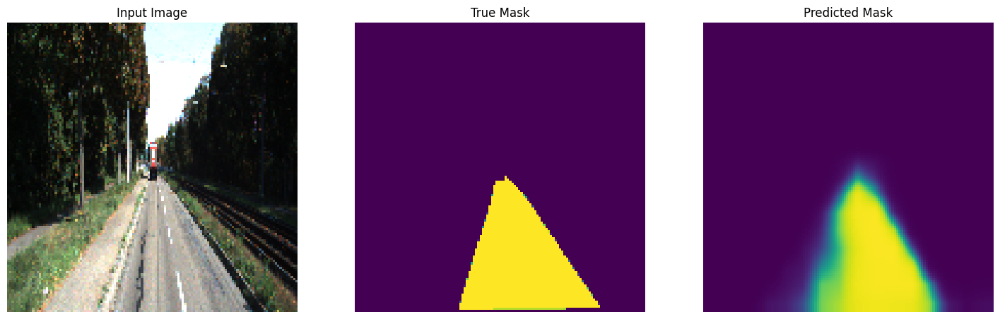


Sample Prediction after epoch 60


Epoch 60: val_loss improved from 0.08795 to 0.08758, saving model to best_model.h5
7/7 [==============================] - 26s 4s/step - loss: 0.0984 - mse: 0.0287 - val_loss: 0.0876 - val_mse: 0.0251
Epoch 61/200
1/1 [==============================] - 0s 20ms/step


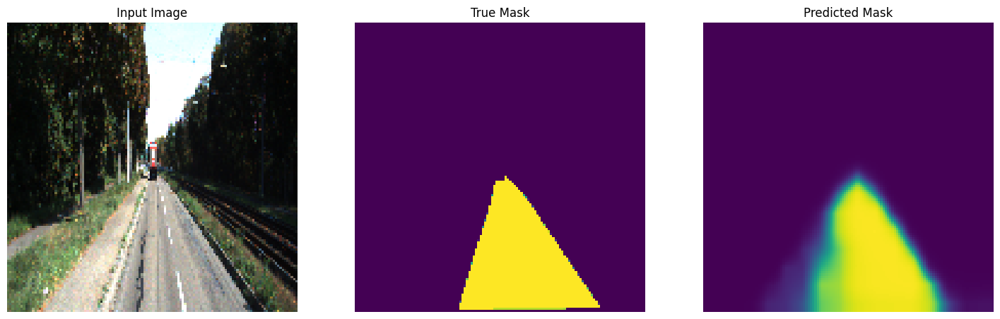


Sample Prediction after epoch 61


Epoch 61: val_loss did not improve from 0.08758
7/7 [==============================] - 26s 4s/step - loss: 0.1022 - mse: 0.0303 - val_loss: 0.0929 - val_mse: 0.0272
Epoch 62/200
1/1 [==============================] - 0s 20ms/step


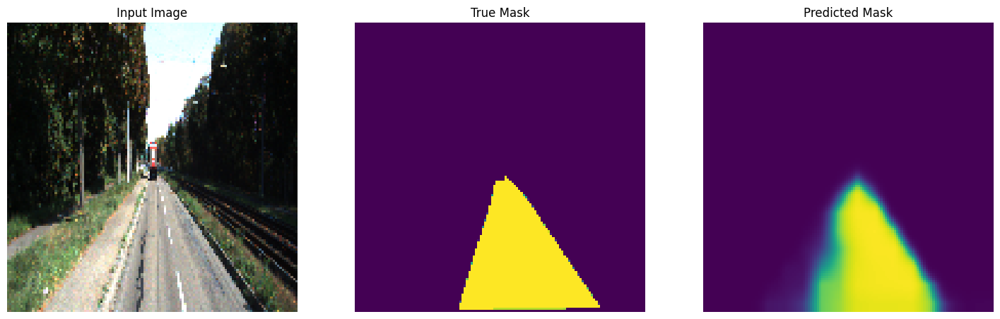


Sample Prediction after epoch 62


Epoch 62: val_loss did not improve from 0.08758
7/7 [==============================] - 26s 4s/step - loss: 0.0888 - mse: 0.0259 - val_loss: 0.0908 - val_mse: 0.0262
Epoch 63/200
1/1 [==============================] - 0s 20ms/step


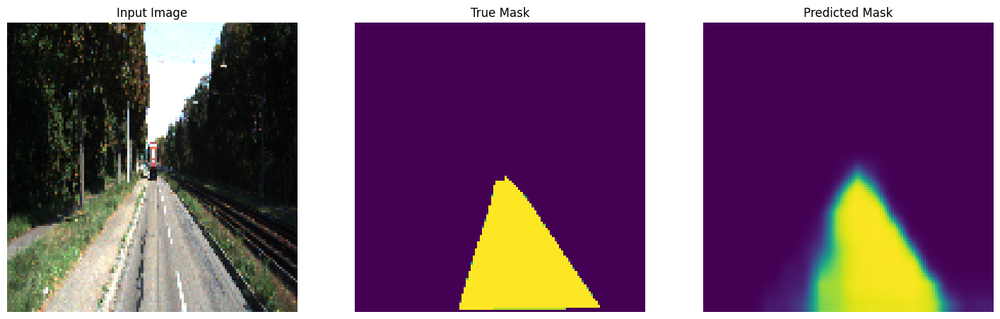


Sample Prediction after epoch 63


Epoch 63: val_loss did not improve from 0.08758
7/7 [==============================] - 21s 3s/step - loss: 0.0913 - mse: 0.0264 - val_loss: 0.0954 - val_mse: 0.0279
Epoch 64/200
1/1 [==============================] - 0s 20ms/step


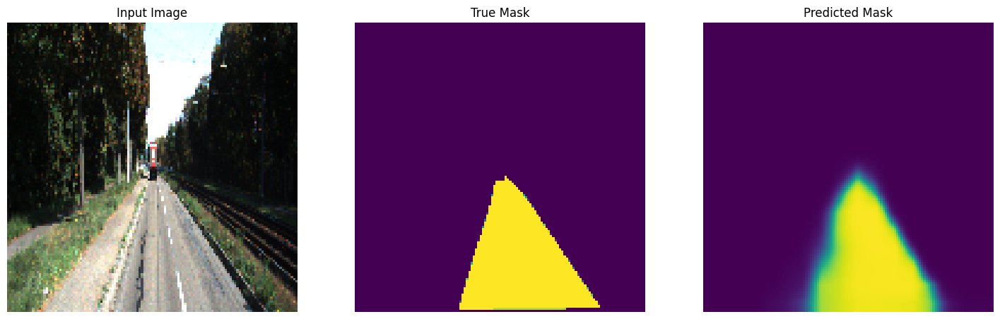


Sample Prediction after epoch 64


Epoch 64: val_loss did not improve from 0.08758
7/7 [==============================] - 26s 4s/step - loss: 0.0941 - mse: 0.0273 - val_loss: 0.0987 - val_mse: 0.0280
Epoch 65/200
1/1 [==============================] - 0s 19ms/step


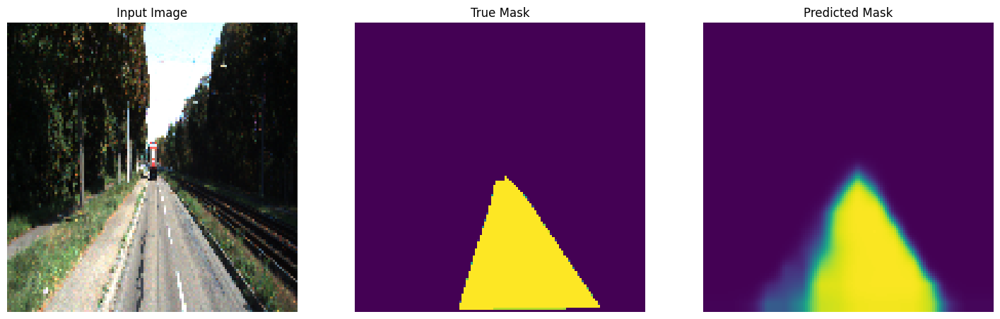


Sample Prediction after epoch 65


Epoch 65: val_loss improved from 0.08758 to 0.08498, saving model to best_model.h5
7/7 [==============================] - 23s 4s/step - loss: 0.1006 - mse: 0.0291 - val_loss: 0.0850 - val_mse: 0.0244
Epoch 66/200
1/1 [==============================] - 0s 20ms/step


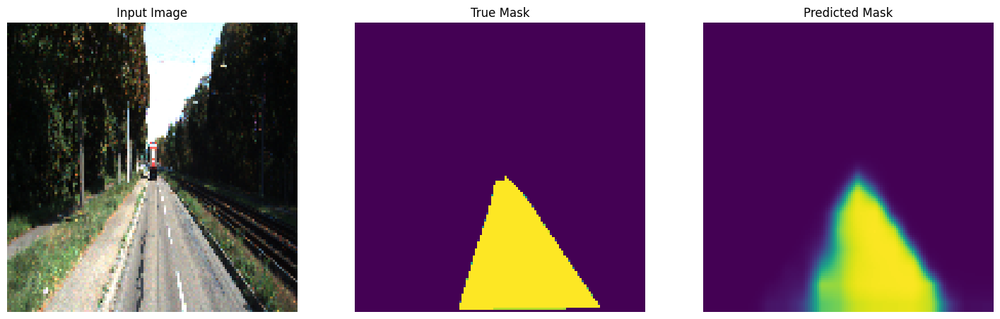


Sample Prediction after epoch 66


Epoch 66: val_loss did not improve from 0.08498
7/7 [==============================] - 26s 4s/step - loss: 0.0952 - mse: 0.0279 - val_loss: 0.0989 - val_mse: 0.0296
Epoch 67/200
1/1 [==============================] - 0s 19ms/step


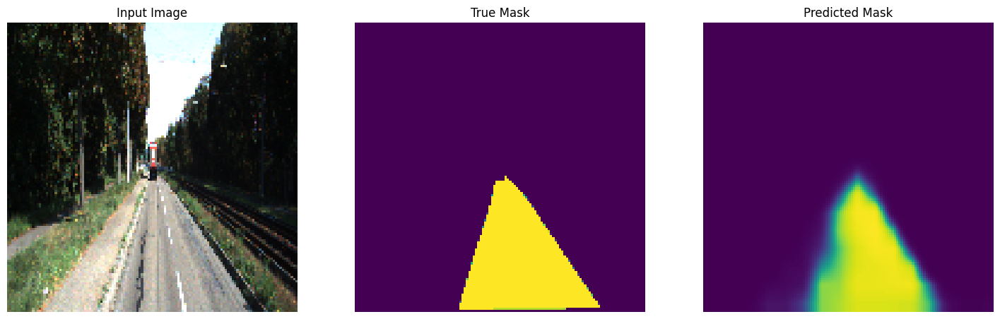


Sample Prediction after epoch 67


Epoch 67: val_loss did not improve from 0.08498
7/7 [==============================] - 21s 4s/step - loss: 0.0956 - mse: 0.0279 - val_loss: 0.1027 - val_mse: 0.0297
Epoch 68/200
1/1 [==============================] - 0s 20ms/step


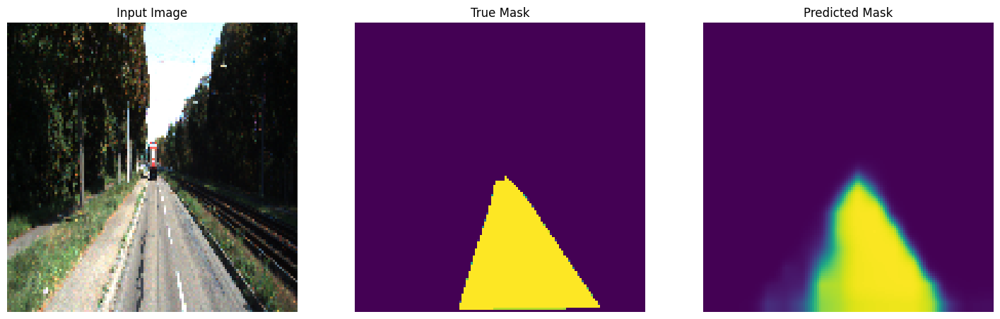


Sample Prediction after epoch 68


Epoch 68: val_loss did not improve from 0.08498
7/7 [==============================] - 26s 4s/step - loss: 0.1029 - mse: 0.0300 - val_loss: 0.0889 - val_mse: 0.0262
Epoch 69/200
1/1 [==============================] - 0s 19ms/step


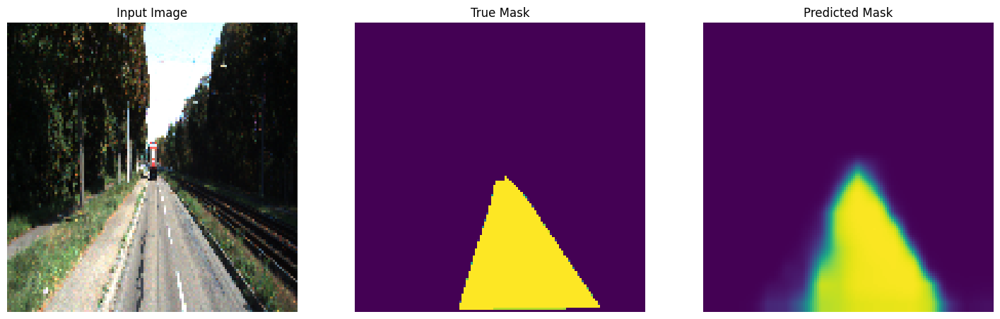


Sample Prediction after epoch 69


Epoch 69: val_loss did not improve from 0.08498
7/7 [==============================] - 22s 4s/step - loss: 0.0914 - mse: 0.0269 - val_loss: 0.0878 - val_mse: 0.0251
Epoch 70/200
1/1 [==============================] - 0s 19ms/step


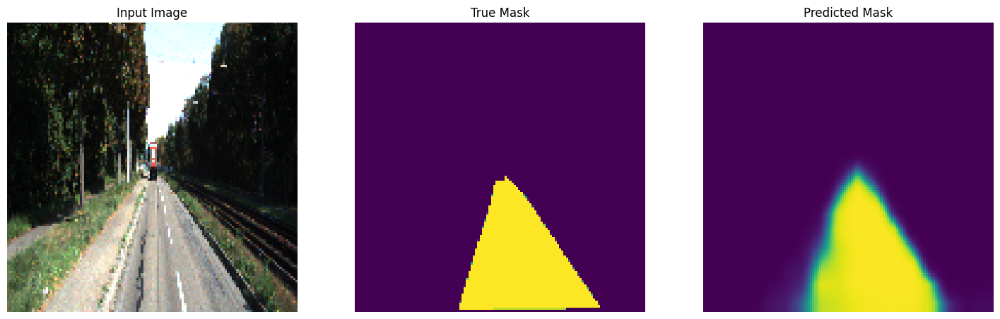


Sample Prediction after epoch 70


Epoch 70: val_loss did not improve from 0.08498
7/7 [==============================] - 18s 3s/step - loss: 0.0861 - mse: 0.0248 - val_loss: 0.0964 - val_mse: 0.0279
Epoch 71/200
1/1 [==============================] - 0s 19ms/step


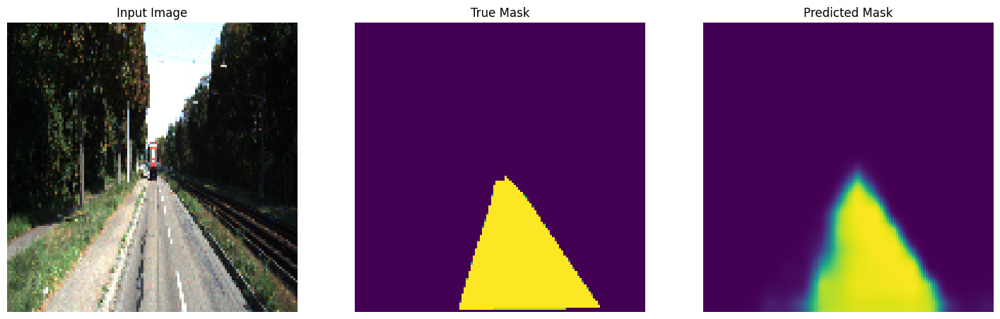


Sample Prediction after epoch 71


Epoch 71: val_loss did not improve from 0.08498
7/7 [==============================] - 27s 4s/step - loss: 0.0915 - mse: 0.0263 - val_loss: 0.0863 - val_mse: 0.0246
Epoch 72/200
1/1 [==============================] - 0s 20ms/step


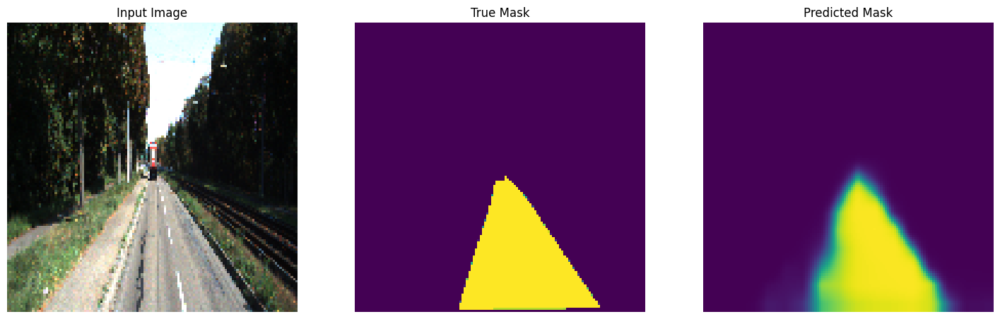


Sample Prediction after epoch 72


Epoch 72: val_loss did not improve from 0.08498
7/7 [==============================] - 20s 3s/step - loss: 0.0852 - mse: 0.0243 - val_loss: 0.0882 - val_mse: 0.0261
Epoch 73/200
1/1 [==============================] - 0s 20ms/step


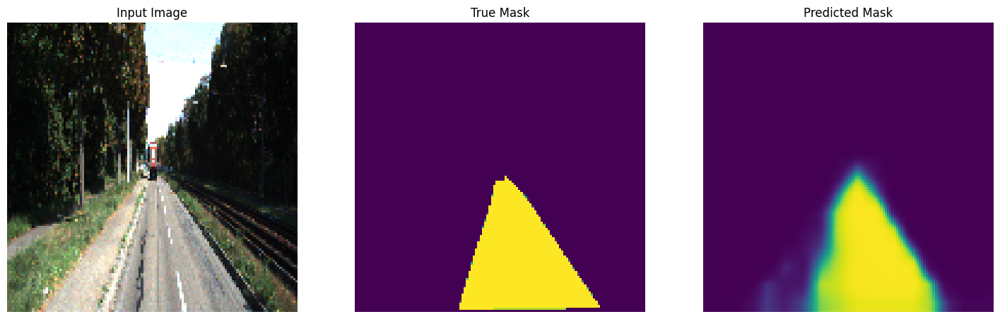


Sample Prediction after epoch 73


Epoch 73: val_loss did not improve from 0.08498
7/7 [==============================] - 26s 4s/step - loss: 0.0857 - mse: 0.0248 - val_loss: 0.0928 - val_mse: 0.0280
Epoch 74/200
1/1 [==============================] - 0s 20ms/step


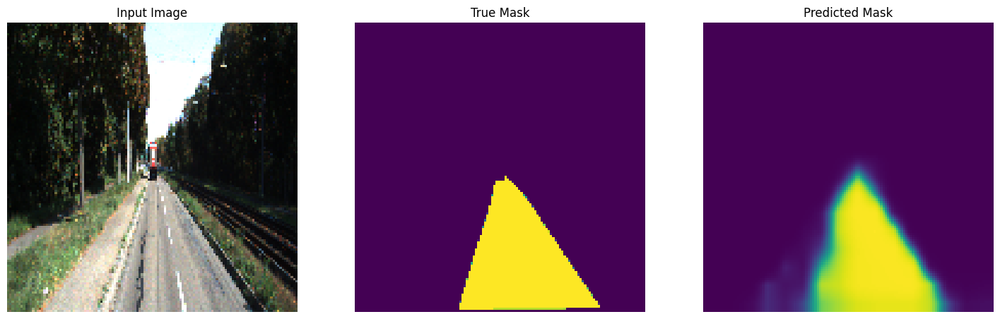


Sample Prediction after epoch 74


Epoch 74: val_loss improved from 0.08498 to 0.08055, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0909 - mse: 0.0263 - val_loss: 0.0806 - val_mse: 0.0235
Epoch 75/200
1/1 [==============================] - 0s 19ms/step


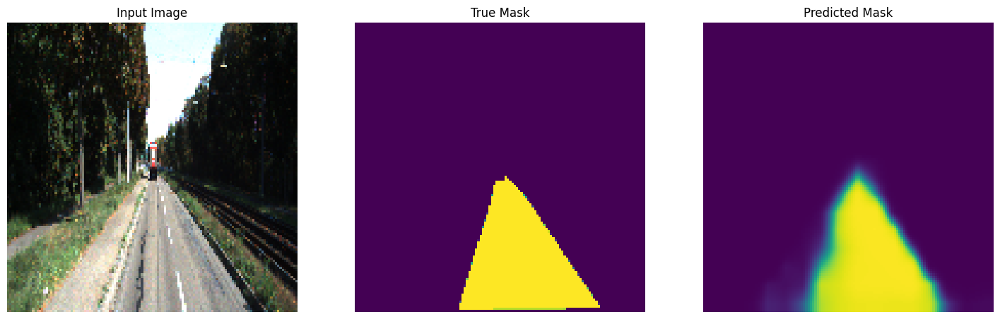


Sample Prediction after epoch 75


Epoch 75: val_loss did not improve from 0.08055
7/7 [==============================] - 21s 3s/step - loss: 0.0844 - mse: 0.0242 - val_loss: 0.0820 - val_mse: 0.0234
Epoch 76/200
1/1 [==============================] - 0s 22ms/step


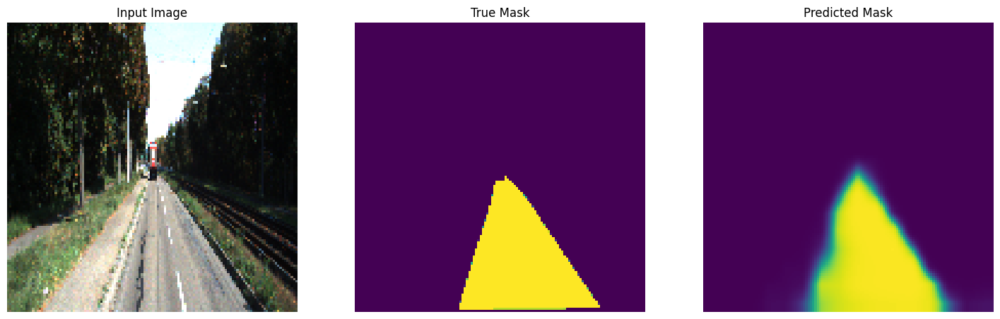


Sample Prediction after epoch 76


Epoch 76: val_loss did not improve from 0.08055
7/7 [==============================] - 26s 4s/step - loss: 0.0813 - mse: 0.0236 - val_loss: 0.0823 - val_mse: 0.0236
Epoch 77/200
1/1 [==============================] - 0s 24ms/step


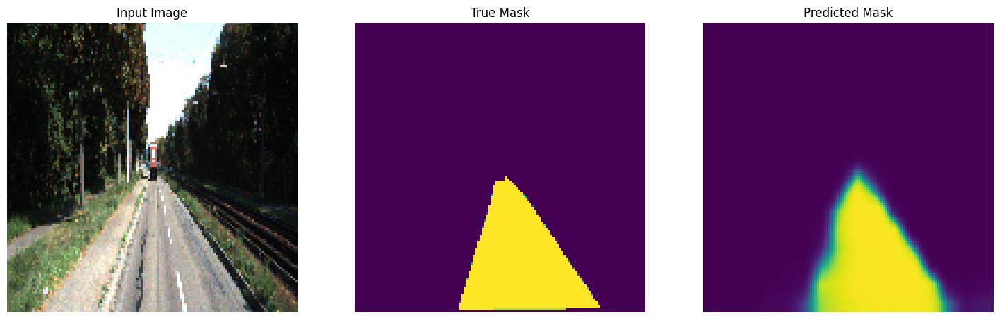


Sample Prediction after epoch 77


Epoch 77: val_loss did not improve from 0.08055
7/7 [==============================] - 21s 3s/step - loss: 0.0831 - mse: 0.0240 - val_loss: 0.0878 - val_mse: 0.0254
Epoch 78/200
1/1 [==============================] - 0s 20ms/step


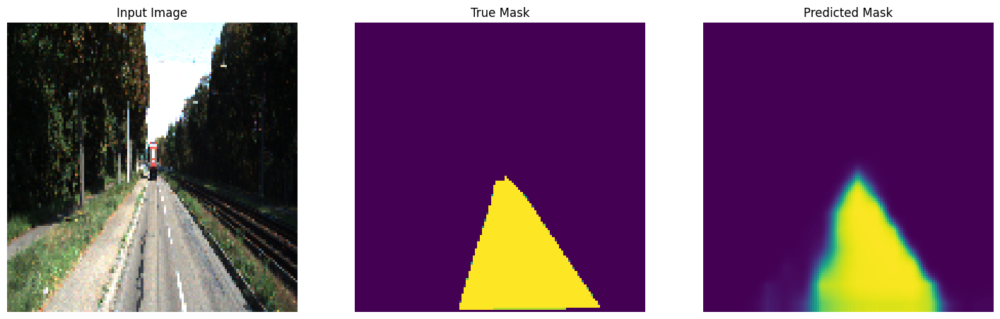


Sample Prediction after epoch 78


Epoch 78: val_loss improved from 0.08055 to 0.07985, saving model to best_model.h5
7/7 [==============================] - 21s 3s/step - loss: 0.0937 - mse: 0.0271 - val_loss: 0.0799 - val_mse: 0.0228
Epoch 79/200
1/1 [==============================] - 0s 20ms/step


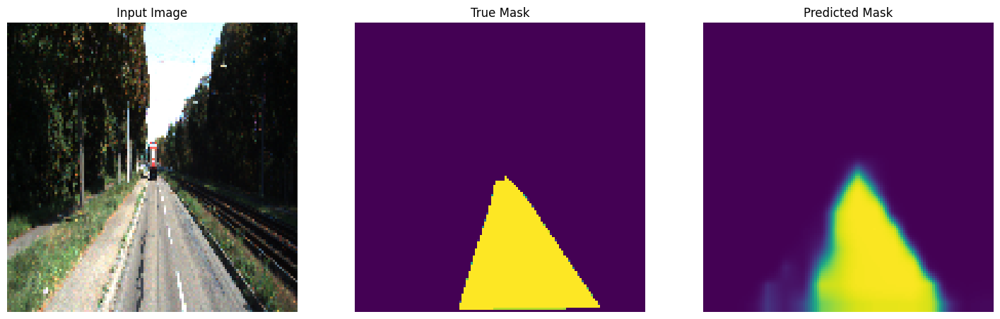


Sample Prediction after epoch 79


Epoch 79: val_loss improved from 0.07985 to 0.07828, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0809 - mse: 0.0235 - val_loss: 0.0783 - val_mse: 0.0223
Epoch 80/200
1/1 [==============================] - 0s 20ms/step


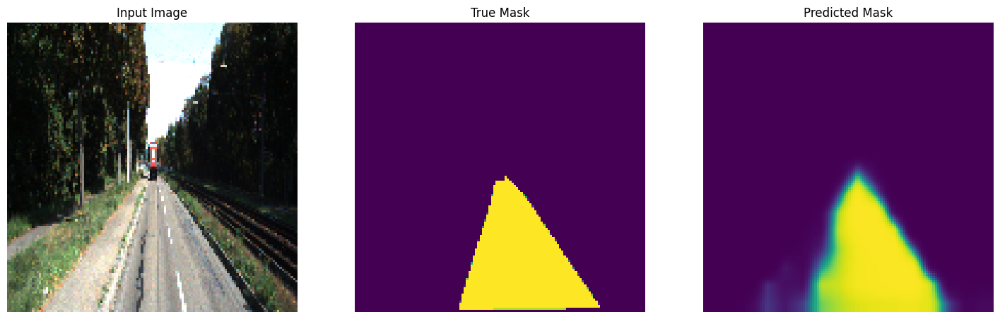


Sample Prediction after epoch 80


Epoch 80: val_loss did not improve from 0.07828
7/7 [==============================] - 21s 3s/step - loss: 0.0789 - mse: 0.0225 - val_loss: 0.0817 - val_mse: 0.0237
Epoch 81/200
1/1 [==============================] - 0s 30ms/step


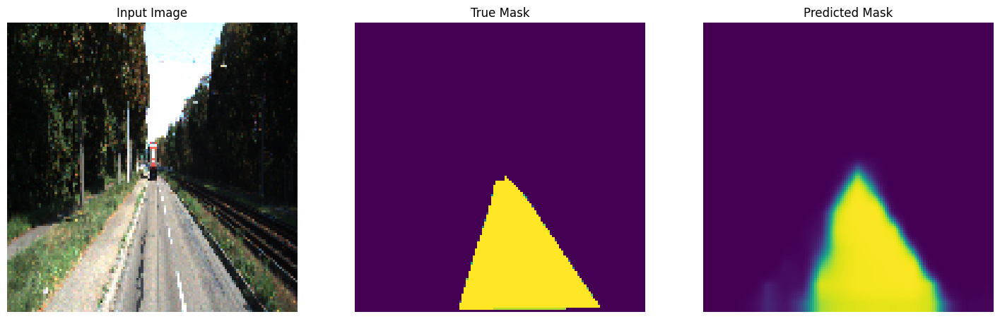


Sample Prediction after epoch 81


Epoch 81: val_loss did not improve from 0.07828
7/7 [==============================] - 27s 4s/step - loss: 0.0816 - mse: 0.0233 - val_loss: 0.0797 - val_mse: 0.0226
Epoch 82/200
1/1 [==============================] - 0s 19ms/step


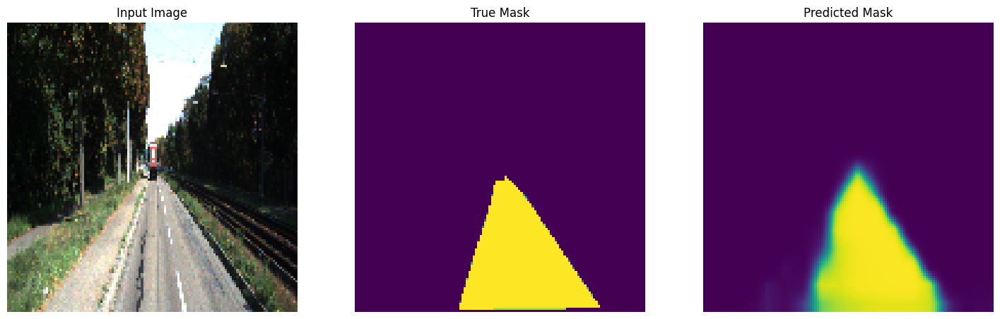


Sample Prediction after epoch 82


Epoch 82: val_loss did not improve from 0.07828
7/7 [==============================] - 26s 4s/step - loss: 0.0768 - mse: 0.0219 - val_loss: 0.0844 - val_mse: 0.0248
Epoch 83/200
1/1 [==============================] - 0s 19ms/step


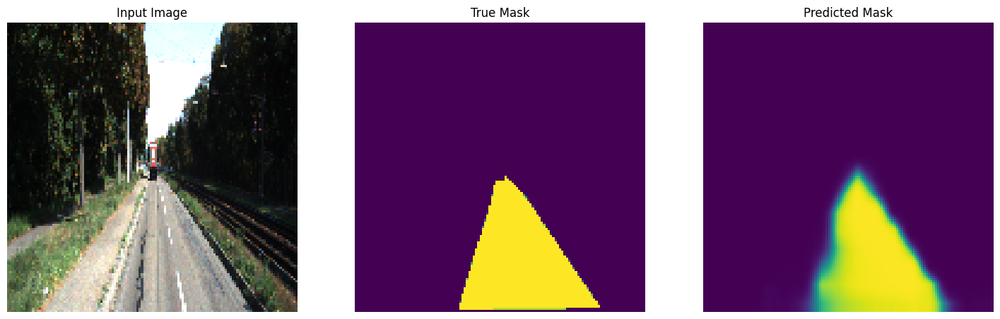


Sample Prediction after epoch 83


Epoch 83: val_loss did not improve from 0.07828
7/7 [==============================] - 26s 4s/step - loss: 0.0785 - mse: 0.0227 - val_loss: 0.0796 - val_mse: 0.0228
Epoch 84/200
1/1 [==============================] - 0s 20ms/step


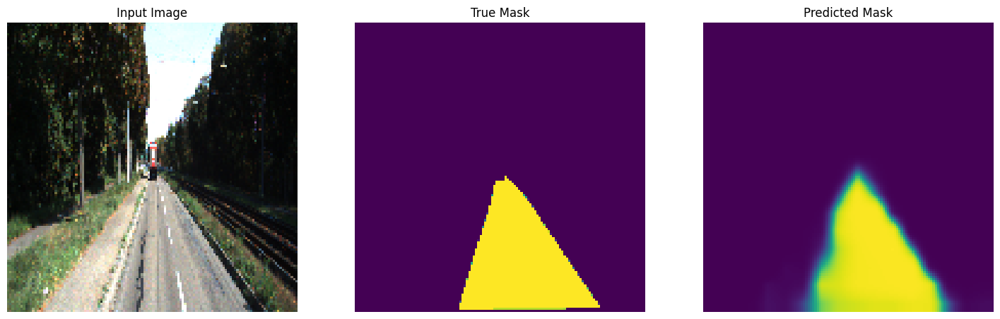


Sample Prediction after epoch 84


Epoch 84: val_loss did not improve from 0.07828
7/7 [==============================] - 26s 4s/step - loss: 0.0775 - mse: 0.0222 - val_loss: 0.0805 - val_mse: 0.0226
Epoch 85/200
1/1 [==============================] - 0s 20ms/step


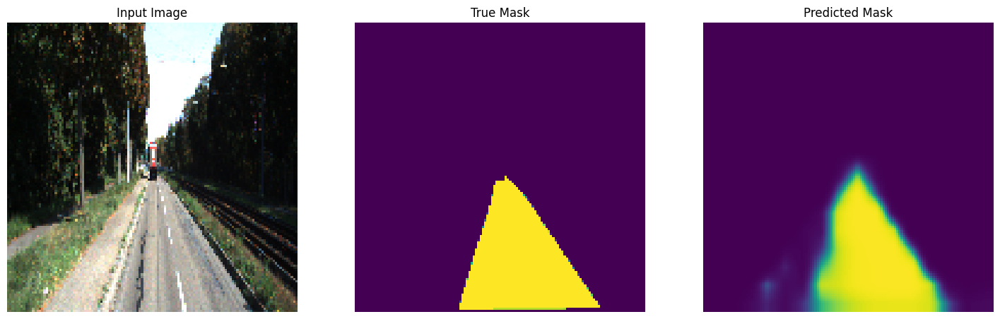


Sample Prediction after epoch 85


Epoch 85: val_loss improved from 0.07828 to 0.07325, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0780 - mse: 0.0223 - val_loss: 0.0733 - val_mse: 0.0210
Epoch 86/200
1/1 [==============================] - 0s 19ms/step


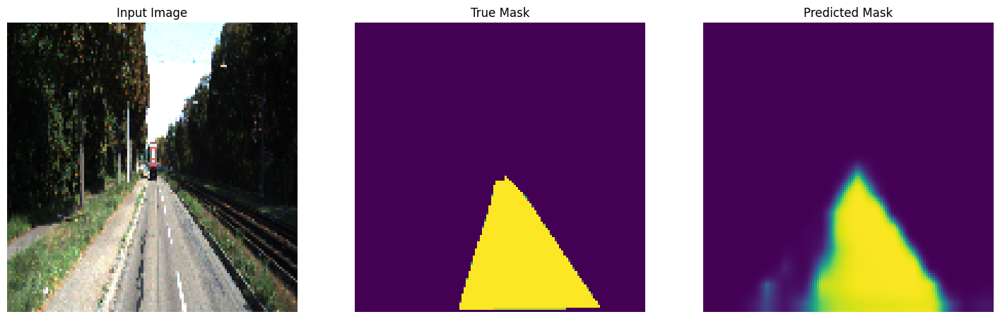


Sample Prediction after epoch 86


Epoch 86: val_loss did not improve from 0.07325
7/7 [==============================] - 27s 4s/step - loss: 0.0765 - mse: 0.0217 - val_loss: 0.0874 - val_mse: 0.0250
Epoch 87/200
1/1 [==============================] - 0s 20ms/step


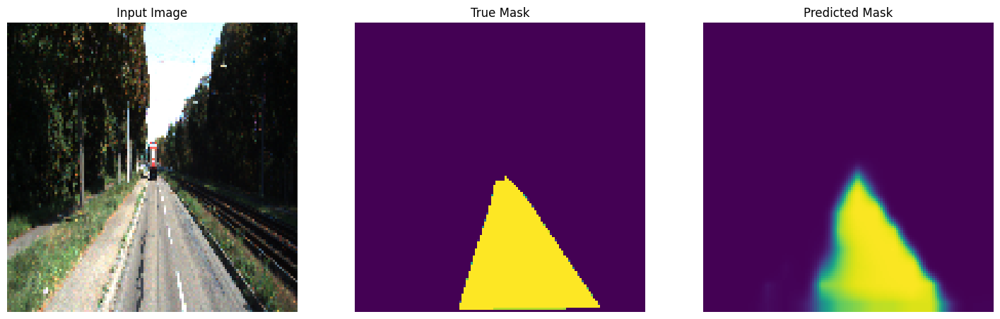


Sample Prediction after epoch 87


Epoch 87: val_loss did not improve from 0.07325
7/7 [==============================] - 20s 3s/step - loss: 0.0785 - mse: 0.0225 - val_loss: 0.0805 - val_mse: 0.0234
Epoch 88/200
1/1 [==============================] - 0s 19ms/step


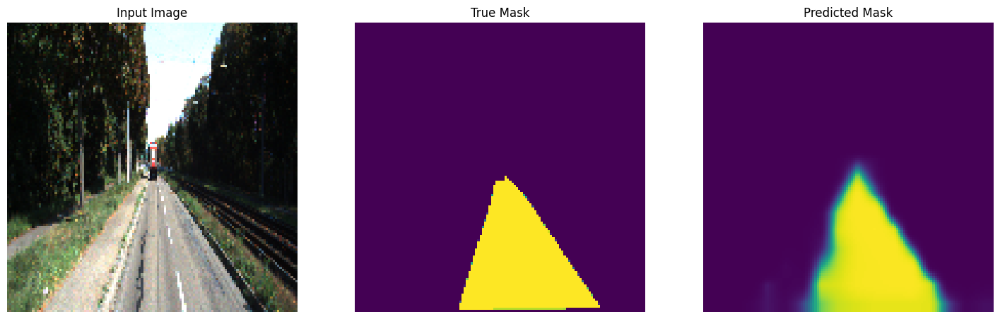


Sample Prediction after epoch 88


Epoch 88: val_loss did not improve from 0.07325
7/7 [==============================] - 26s 4s/step - loss: 0.0818 - mse: 0.0232 - val_loss: 0.0748 - val_mse: 0.0212
Epoch 89/200
1/1 [==============================] - 0s 20ms/step


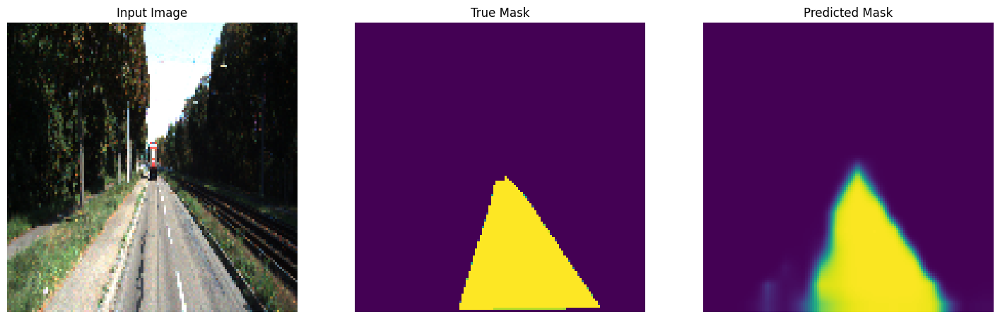


Sample Prediction after epoch 89


Epoch 89: val_loss did not improve from 0.07325
7/7 [==============================] - 27s 4s/step - loss: 0.0751 - mse: 0.0215 - val_loss: 0.0888 - val_mse: 0.0263
Epoch 90/200
1/1 [==============================] - 0s 19ms/step


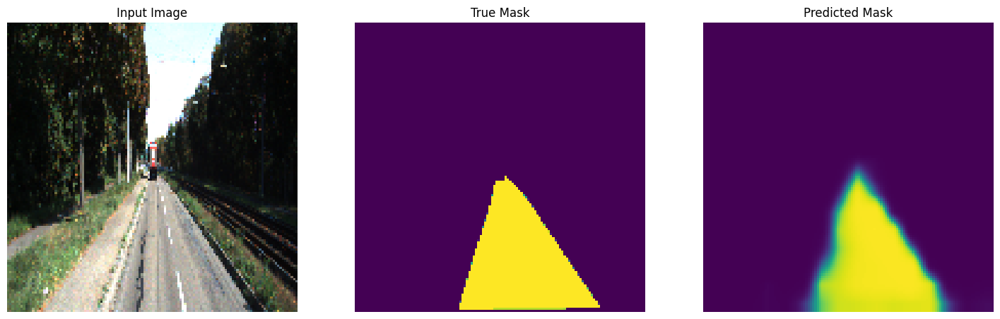


Sample Prediction after epoch 90


Epoch 90: val_loss did not improve from 0.07325
7/7 [==============================] - 27s 4s/step - loss: 0.0824 - mse: 0.0238 - val_loss: 0.0852 - val_mse: 0.0242
Epoch 91/200
1/1 [==============================] - 0s 20ms/step


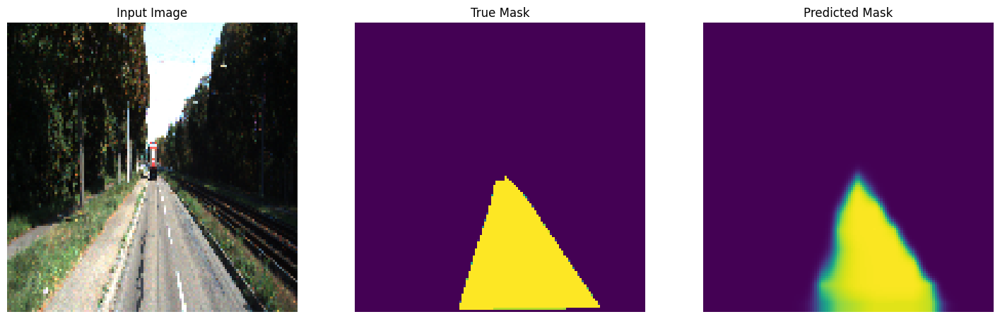


Sample Prediction after epoch 91


Epoch 91: val_loss did not improve from 0.07325
7/7 [==============================] - 26s 4s/step - loss: 0.0809 - mse: 0.0232 - val_loss: 0.0795 - val_mse: 0.0229
Epoch 92/200
1/1 [==============================] - 0s 20ms/step


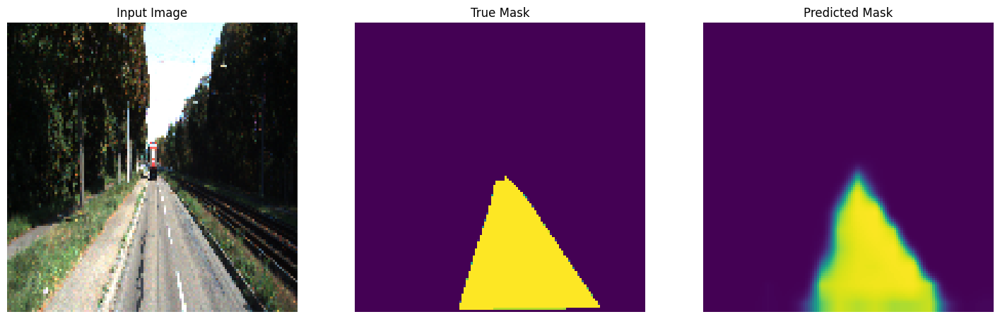


Sample Prediction after epoch 92


Epoch 92: val_loss did not improve from 0.07325
7/7 [==============================] - 26s 4s/step - loss: 0.0769 - mse: 0.0225 - val_loss: 0.0770 - val_mse: 0.0221
Epoch 93/200
1/1 [==============================] - 0s 20ms/step


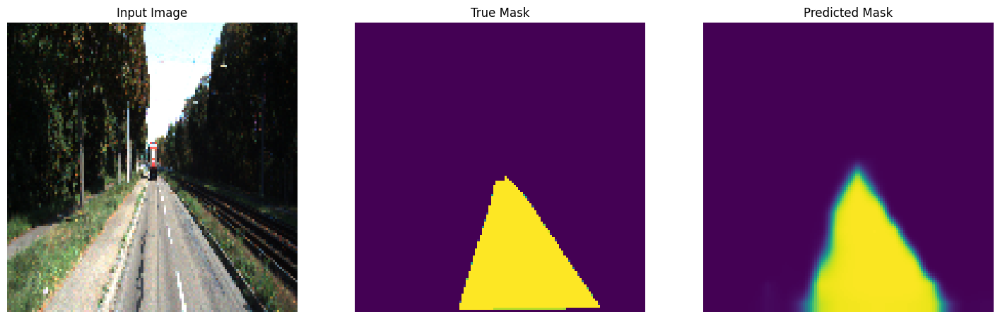


Sample Prediction after epoch 93


Epoch 93: val_loss did not improve from 0.07325
7/7 [==============================] - 26s 4s/step - loss: 0.0764 - mse: 0.0218 - val_loss: 0.0768 - val_mse: 0.0211
Epoch 94/200
1/1 [==============================] - 0s 21ms/step


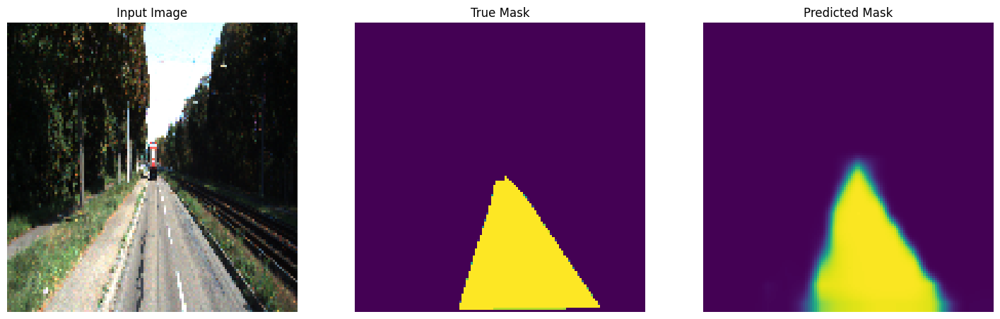


Sample Prediction after epoch 94


Epoch 94: val_loss did not improve from 0.07325
7/7 [==============================] - 26s 4s/step - loss: 0.0800 - mse: 0.0229 - val_loss: 0.0799 - val_mse: 0.0231
Epoch 95/200
1/1 [==============================] - 0s 20ms/step


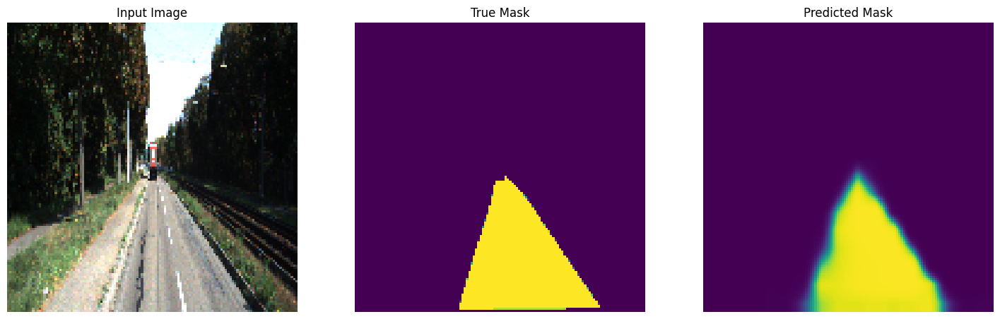


Sample Prediction after epoch 95


Epoch 95: val_loss improved from 0.07325 to 0.06933, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0791 - mse: 0.0228 - val_loss: 0.0693 - val_mse: 0.0194
Epoch 96/200
1/1 [==============================] - 0s 20ms/step


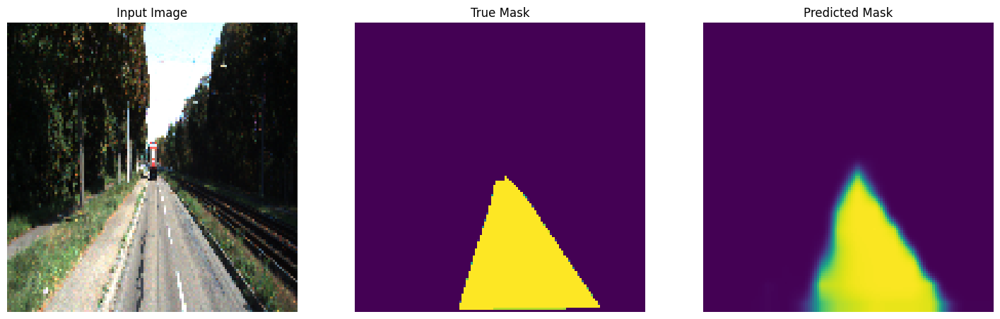


Sample Prediction after epoch 96


Epoch 96: val_loss did not improve from 0.06933
7/7 [==============================] - 21s 3s/step - loss: 0.0750 - mse: 0.0212 - val_loss: 0.0697 - val_mse: 0.0201
Epoch 97/200
1/1 [==============================] - 0s 20ms/step


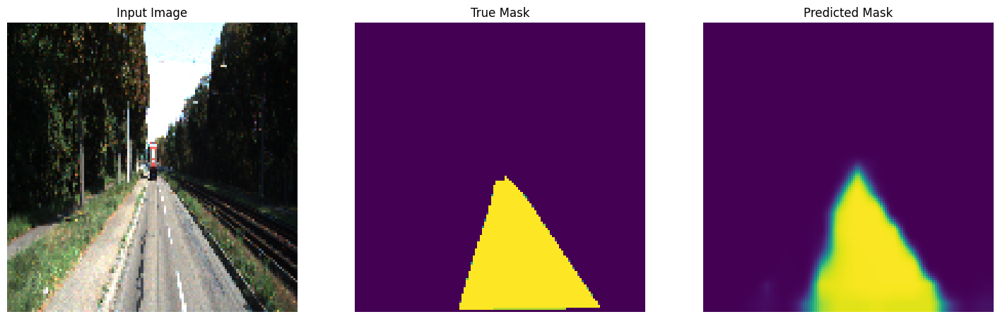


Sample Prediction after epoch 97


Epoch 97: val_loss improved from 0.06933 to 0.06922, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0758 - mse: 0.0219 - val_loss: 0.0692 - val_mse: 0.0197
Epoch 98/200
1/1 [==============================] - 0s 21ms/step


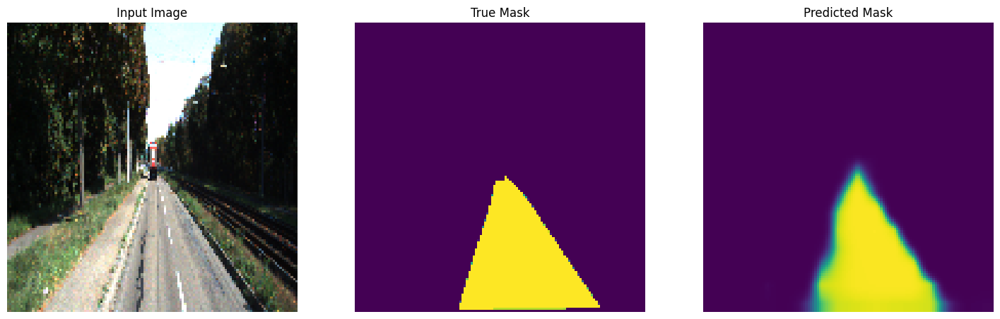


Sample Prediction after epoch 98


Epoch 98: val_loss did not improve from 0.06922
7/7 [==============================] - 21s 4s/step - loss: 0.0718 - mse: 0.0204 - val_loss: 0.0756 - val_mse: 0.0212
Epoch 99/200
1/1 [==============================] - 0s 21ms/step


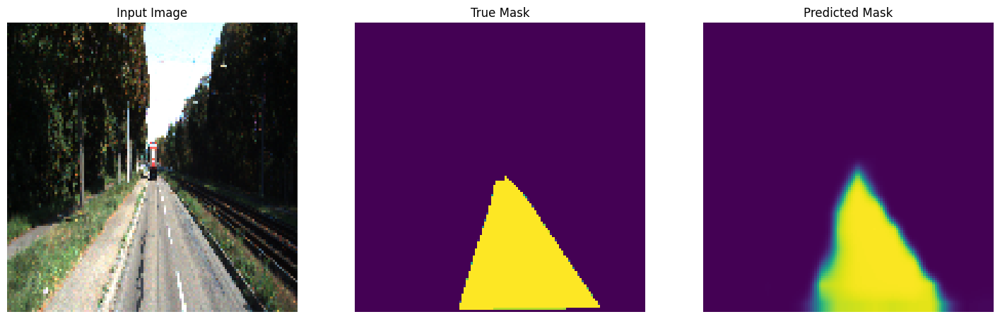


Sample Prediction after epoch 99


Epoch 99: val_loss improved from 0.06922 to 0.06561, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0712 - mse: 0.0202 - val_loss: 0.0656 - val_mse: 0.0182
Epoch 100/200
1/1 [==============================] - 0s 19ms/step


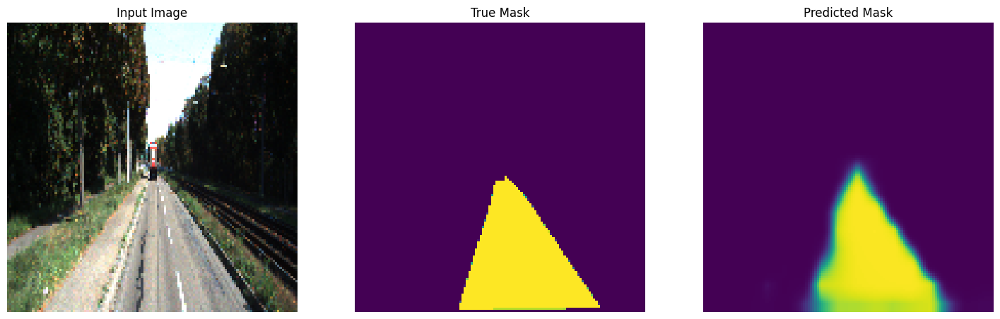


Sample Prediction after epoch 100


Epoch 100: val_loss did not improve from 0.06561
7/7 [==============================] - 22s 4s/step - loss: 0.0674 - mse: 0.0191 - val_loss: 0.0704 - val_mse: 0.0206
Epoch 101/200
1/1 [==============================] - 0s 19ms/step


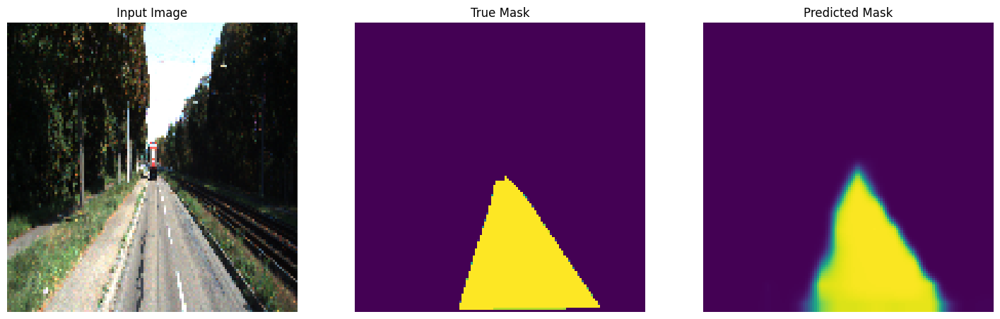


Sample Prediction after epoch 101


Epoch 101: val_loss did not improve from 0.06561
7/7 [==============================] - 26s 4s/step - loss: 0.0677 - mse: 0.0192 - val_loss: 0.0684 - val_mse: 0.0194
Epoch 102/200
1/1 [==============================] - 0s 19ms/step


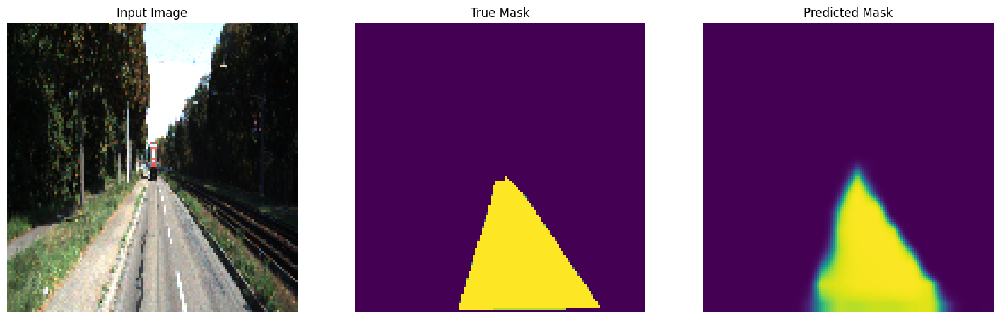


Sample Prediction after epoch 102


Epoch 102: val_loss did not improve from 0.06561
7/7 [==============================] - 26s 4s/step - loss: 0.0684 - mse: 0.0195 - val_loss: 0.0667 - val_mse: 0.0190
Epoch 103/200
1/1 [==============================] - 0s 20ms/step


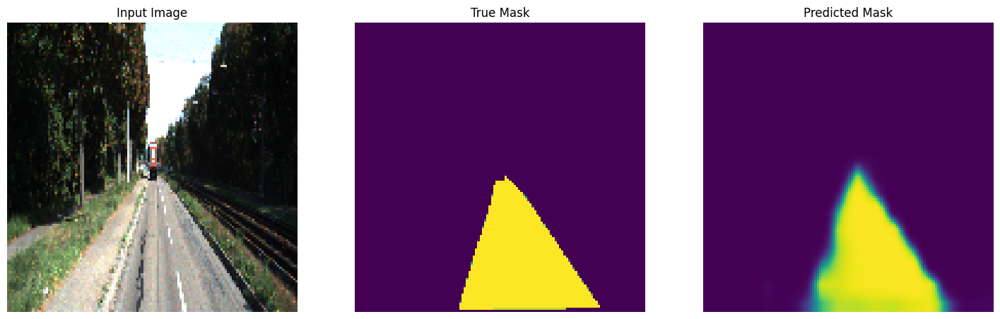


Sample Prediction after epoch 103


Epoch 103: val_loss did not improve from 0.06561
7/7 [==============================] - 27s 4s/step - loss: 0.0712 - mse: 0.0205 - val_loss: 0.0689 - val_mse: 0.0197
Epoch 104/200
1/1 [==============================] - 0s 19ms/step


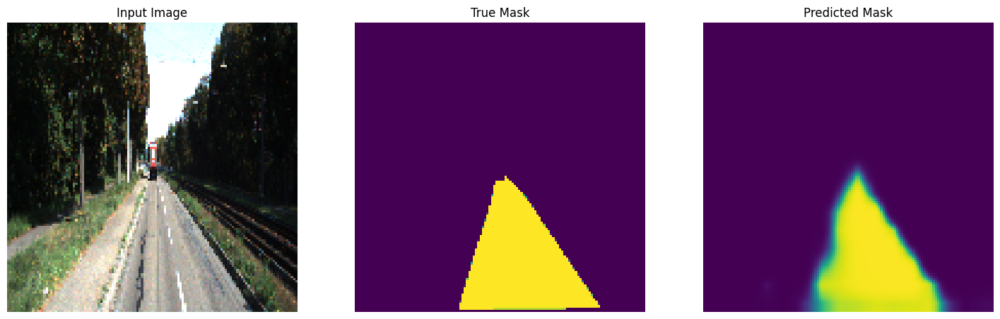


Sample Prediction after epoch 104


Epoch 104: val_loss did not improve from 0.06561
7/7 [==============================] - 20s 3s/step - loss: 0.0785 - mse: 0.0228 - val_loss: 0.0684 - val_mse: 0.0189
Epoch 105/200
1/1 [==============================] - 0s 20ms/step


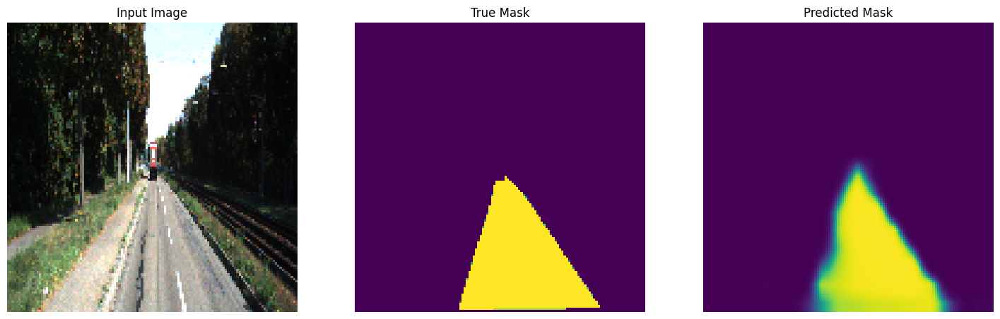


Sample Prediction after epoch 105


Epoch 105: val_loss improved from 0.06561 to 0.06514, saving model to best_model.h5
7/7 [==============================] - 23s 4s/step - loss: 0.0742 - mse: 0.0211 - val_loss: 0.0651 - val_mse: 0.0186
Epoch 106/200
1/1 [==============================] - 0s 24ms/step


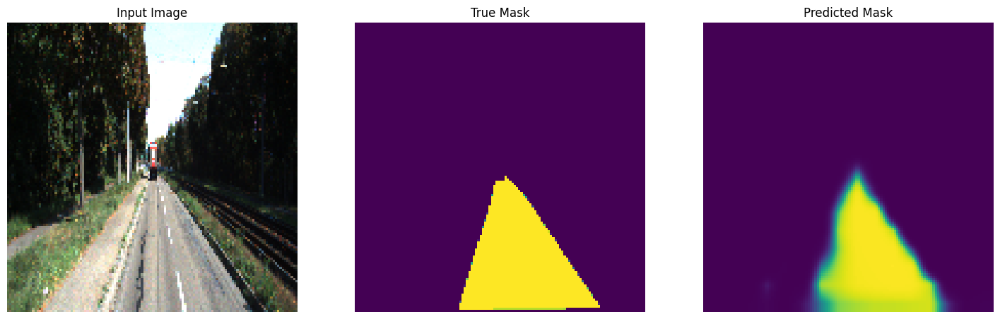


Sample Prediction after epoch 106


Epoch 106: val_loss did not improve from 0.06514
7/7 [==============================] - 26s 4s/step - loss: 0.0706 - mse: 0.0201 - val_loss: 0.0711 - val_mse: 0.0207
Epoch 107/200
1/1 [==============================] - 0s 20ms/step


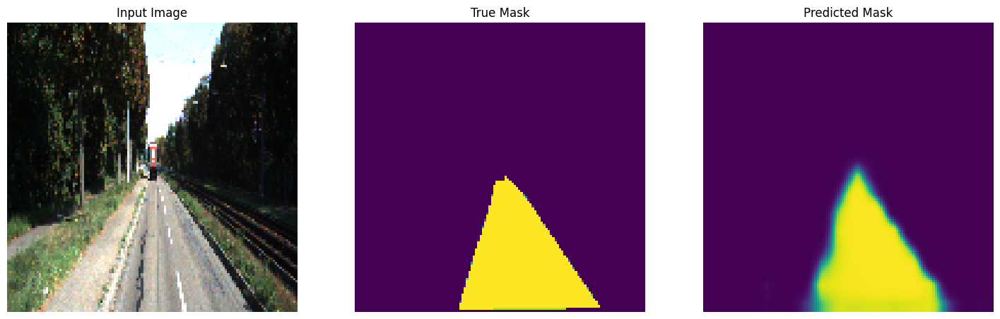


Sample Prediction after epoch 107


Epoch 107: val_loss did not improve from 0.06514
7/7 [==============================] - 26s 4s/step - loss: 0.0690 - mse: 0.0196 - val_loss: 0.0654 - val_mse: 0.0186
Epoch 108/200
1/1 [==============================] - 0s 19ms/step


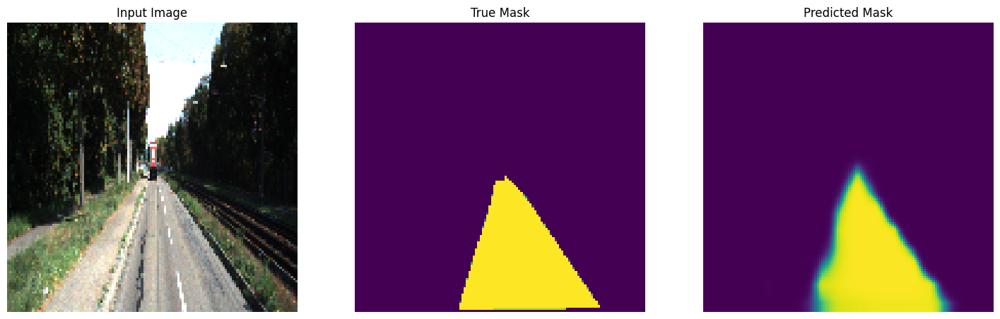


Sample Prediction after epoch 108


Epoch 108: val_loss did not improve from 0.06514
7/7 [==============================] - 26s 4s/step - loss: 0.0690 - mse: 0.0196 - val_loss: 0.0675 - val_mse: 0.0194
Epoch 109/200
1/1 [==============================] - 0s 20ms/step


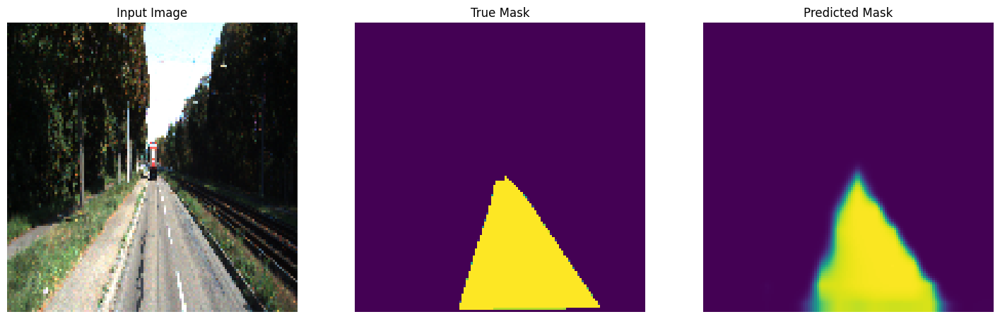


Sample Prediction after epoch 109


Epoch 109: val_loss improved from 0.06514 to 0.06286, saving model to best_model.h5
7/7 [==============================] - 28s 5s/step - loss: 0.0691 - mse: 0.0198 - val_loss: 0.0629 - val_mse: 0.0180
Epoch 110/200
1/1 [==============================] - 0s 20ms/step


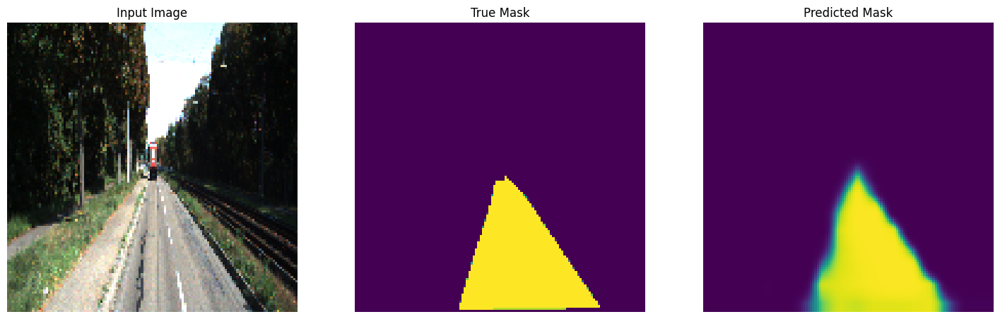


Sample Prediction after epoch 110


Epoch 110: val_loss did not improve from 0.06286
7/7 [==============================] - 21s 3s/step - loss: 0.0694 - mse: 0.0198 - val_loss: 0.0699 - val_mse: 0.0198
Epoch 111/200
1/1 [==============================] - 0s 20ms/step


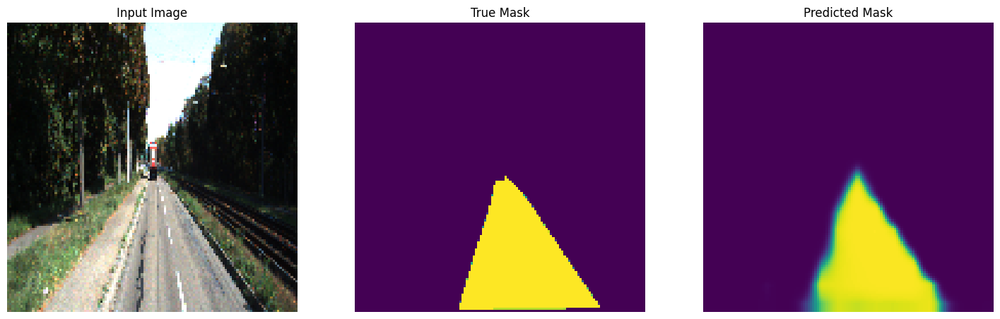


Sample Prediction after epoch 111


Epoch 111: val_loss did not improve from 0.06286
7/7 [==============================] - 26s 4s/step - loss: 0.0642 - mse: 0.0183 - val_loss: 0.0692 - val_mse: 0.0191
Epoch 112/200
1/1 [==============================] - 0s 21ms/step


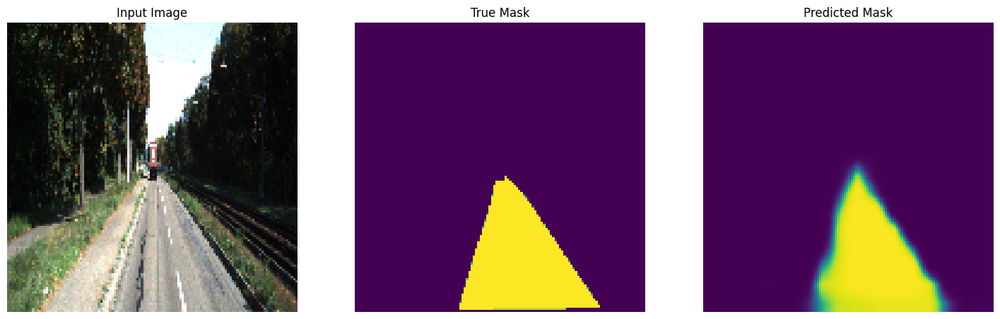


Sample Prediction after epoch 112


Epoch 112: val_loss did not improve from 0.06286
7/7 [==============================] - 21s 4s/step - loss: 0.0655 - mse: 0.0184 - val_loss: 0.0637 - val_mse: 0.0185
Epoch 113/200
1/1 [==============================] - 0s 20ms/step


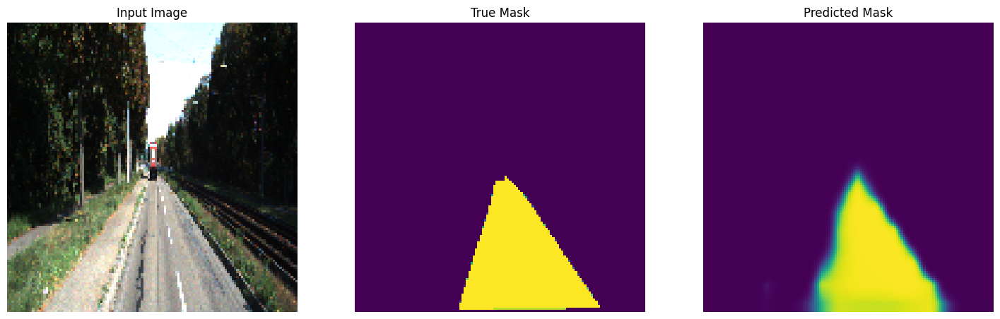


Sample Prediction after epoch 113


Epoch 113: val_loss did not improve from 0.06286
7/7 [==============================] - 21s 3s/step - loss: 0.0676 - mse: 0.0194 - val_loss: 0.0688 - val_mse: 0.0195
Epoch 114/200
1/1 [==============================] - 0s 21ms/step


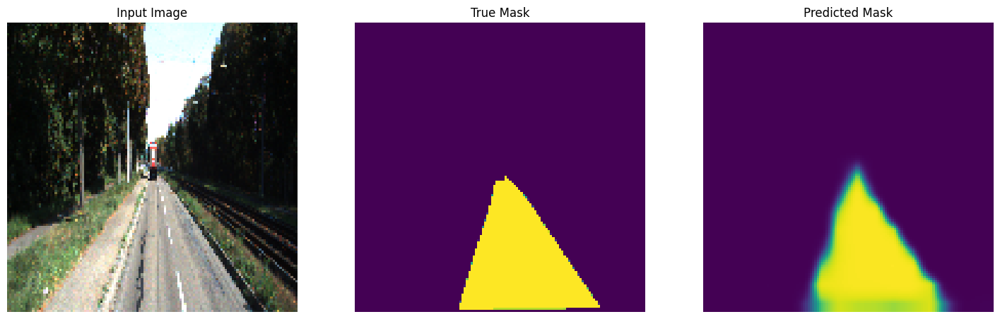


Sample Prediction after epoch 114


Epoch 114: val_loss did not improve from 0.06286
7/7 [==============================] - 21s 3s/step - loss: 0.0623 - mse: 0.0177 - val_loss: 0.0656 - val_mse: 0.0184
Epoch 115/200
1/1 [==============================] - 0s 21ms/step


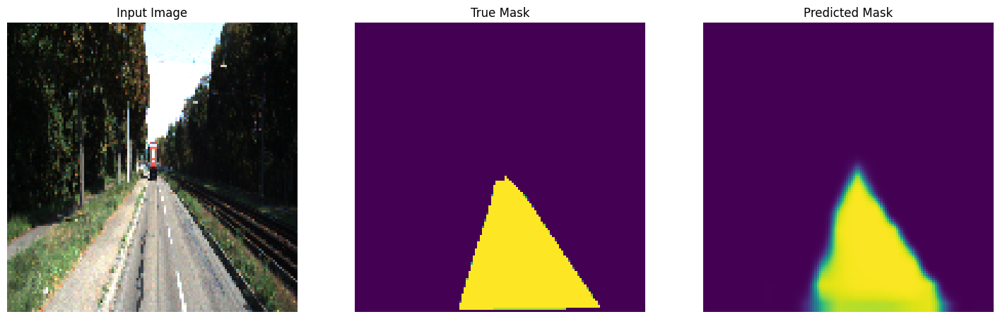


Sample Prediction after epoch 115


Epoch 115: val_loss improved from 0.06286 to 0.05825, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0633 - mse: 0.0181 - val_loss: 0.0583 - val_mse: 0.0168
Epoch 116/200
1/1 [==============================] - 0s 20ms/step


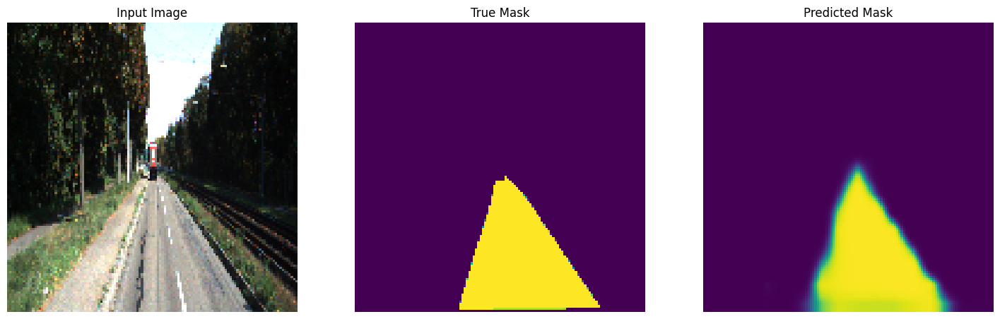


Sample Prediction after epoch 116


Epoch 116: val_loss did not improve from 0.05825
7/7 [==============================] - 27s 4s/step - loss: 0.0633 - mse: 0.0177 - val_loss: 0.0652 - val_mse: 0.0182
Epoch 117/200
1/1 [==============================] - 0s 19ms/step


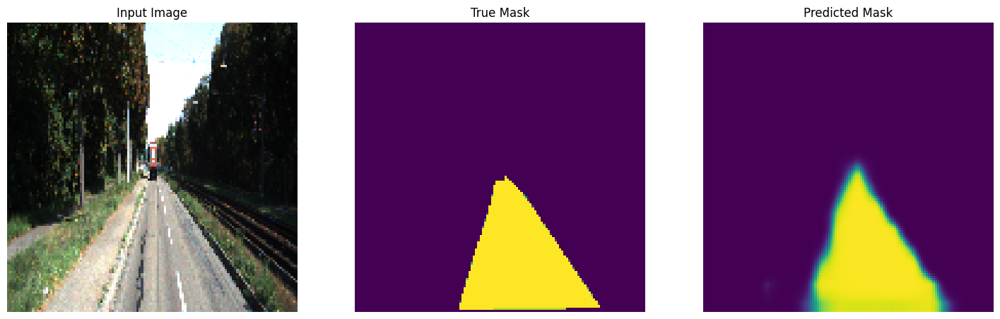


Sample Prediction after epoch 117


Epoch 117: val_loss did not improve from 0.05825
7/7 [==============================] - 21s 3s/step - loss: 0.0630 - mse: 0.0180 - val_loss: 0.0654 - val_mse: 0.0191
Epoch 118/200
1/1 [==============================] - 0s 22ms/step


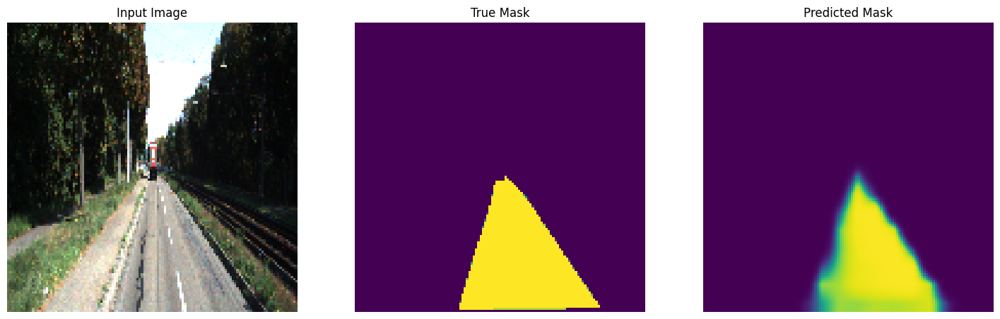


Sample Prediction after epoch 118


Epoch 118: val_loss did not improve from 0.05825
7/7 [==============================] - 26s 4s/step - loss: 0.0656 - mse: 0.0187 - val_loss: 0.0681 - val_mse: 0.0199
Epoch 119/200
1/1 [==============================] - 0s 20ms/step


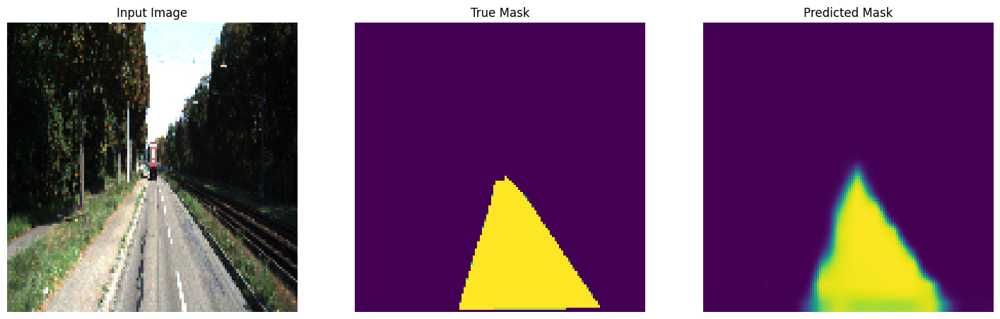


Sample Prediction after epoch 119


Epoch 119: val_loss did not improve from 0.05825
7/7 [==============================] - 21s 4s/step - loss: 0.0695 - mse: 0.0198 - val_loss: 0.0726 - val_mse: 0.0205
Epoch 120/200
1/1 [==============================] - 0s 25ms/step


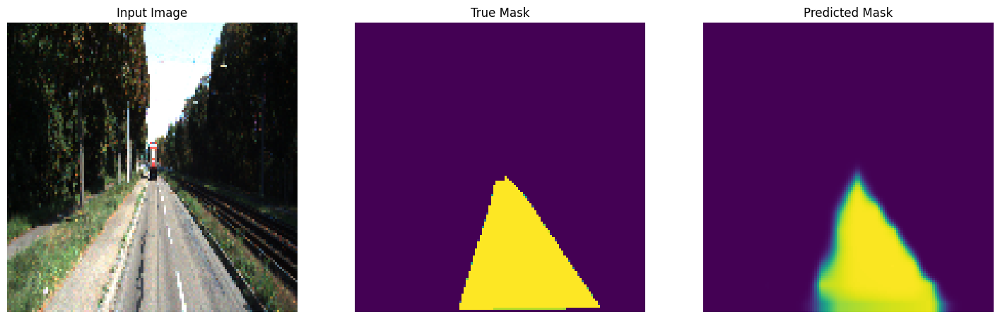


Sample Prediction after epoch 120


Epoch 120: val_loss did not improve from 0.05825
7/7 [==============================] - 21s 3s/step - loss: 0.0615 - mse: 0.0175 - val_loss: 0.0634 - val_mse: 0.0180
Epoch 121/200
1/1 [==============================] - 0s 19ms/step


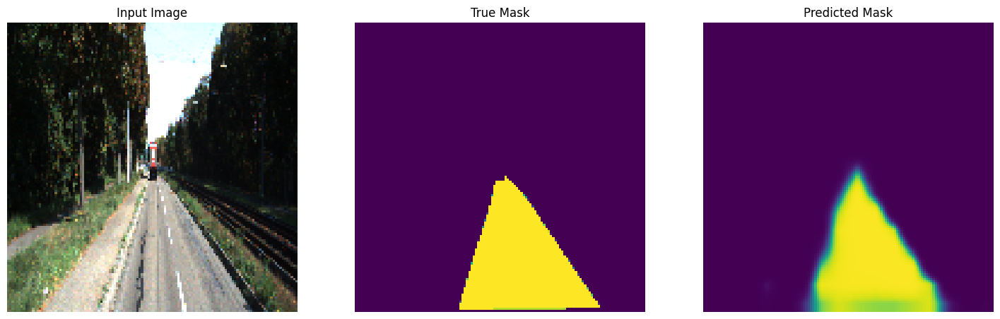


Sample Prediction after epoch 121


Epoch 121: val_loss did not improve from 0.05825
7/7 [==============================] - 26s 4s/step - loss: 0.0644 - mse: 0.0185 - val_loss: 0.0607 - val_mse: 0.0175
Epoch 122/200
1/1 [==============================] - 0s 20ms/step


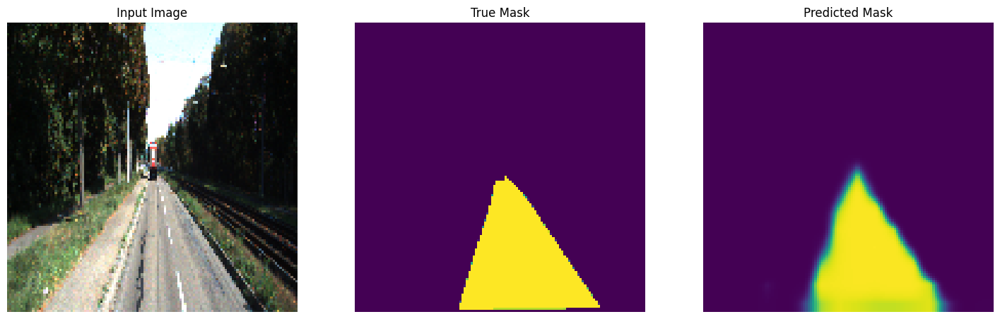


Sample Prediction after epoch 122


Epoch 122: val_loss did not improve from 0.05825
7/7 [==============================] - 22s 4s/step - loss: 0.0588 - mse: 0.0164 - val_loss: 0.0601 - val_mse: 0.0164
Epoch 123/200
1/1 [==============================] - 0s 20ms/step


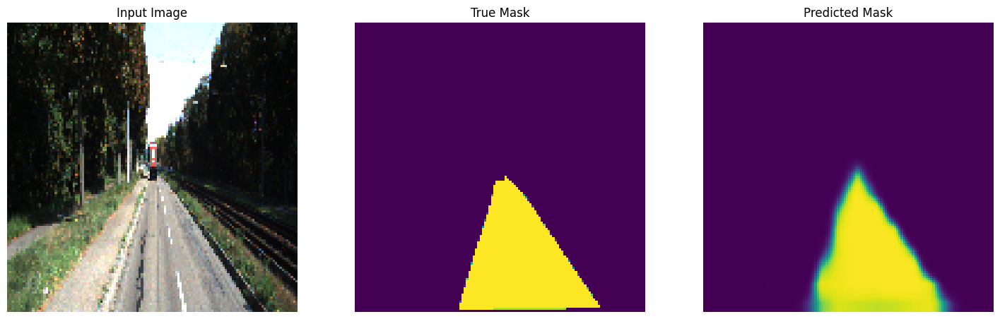


Sample Prediction after epoch 123


Epoch 123: val_loss improved from 0.05825 to 0.05719, saving model to best_model.h5
7/7 [==============================] - 21s 4s/step - loss: 0.0612 - mse: 0.0173 - val_loss: 0.0572 - val_mse: 0.0161
Epoch 124/200
1/1 [==============================] - 0s 23ms/step


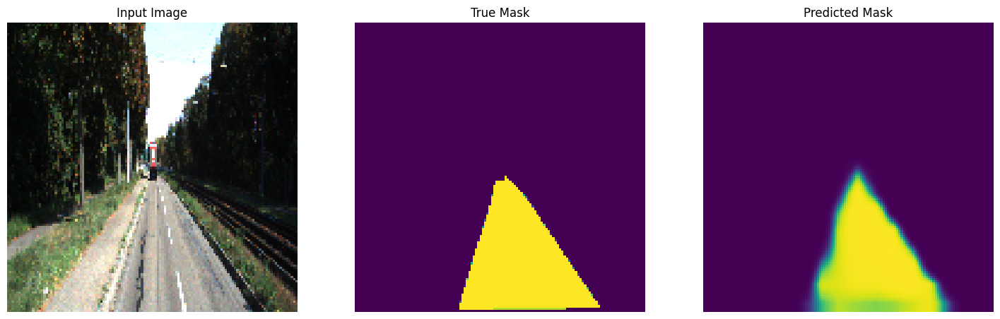


Sample Prediction after epoch 124


Epoch 124: val_loss improved from 0.05719 to 0.05631, saving model to best_model.h5
7/7 [==============================] - 28s 5s/step - loss: 0.0570 - mse: 0.0162 - val_loss: 0.0563 - val_mse: 0.0159
Epoch 125/200
1/1 [==============================] - 0s 29ms/step


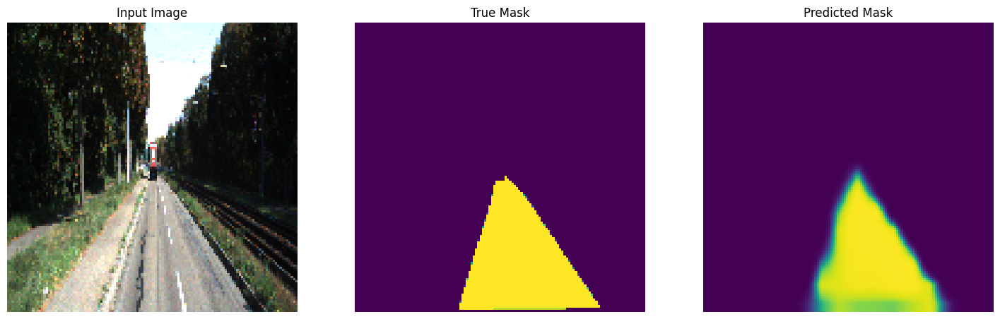


Sample Prediction after epoch 125


Epoch 125: val_loss did not improve from 0.05631
7/7 [==============================] - 27s 4s/step - loss: 0.0614 - mse: 0.0175 - val_loss: 0.0729 - val_mse: 0.0202
Epoch 126/200
1/1 [==============================] - 0s 26ms/step


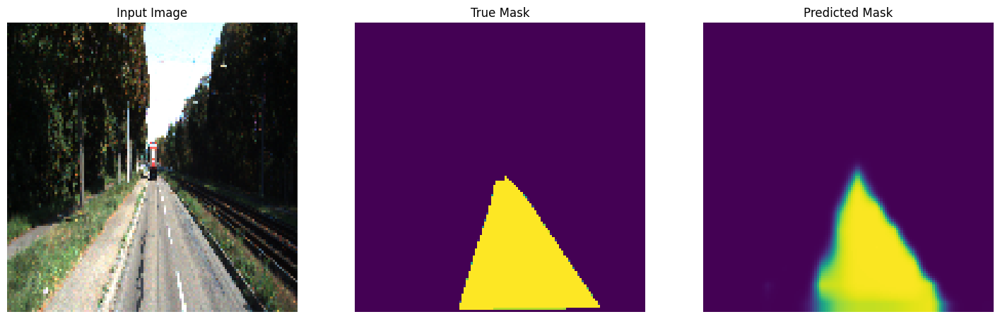


Sample Prediction after epoch 126


Epoch 126: val_loss did not improve from 0.05631
7/7 [==============================] - 21s 3s/step - loss: 0.0640 - mse: 0.0182 - val_loss: 0.0616 - val_mse: 0.0175
Epoch 127/200
1/1 [==============================] - 0s 20ms/step


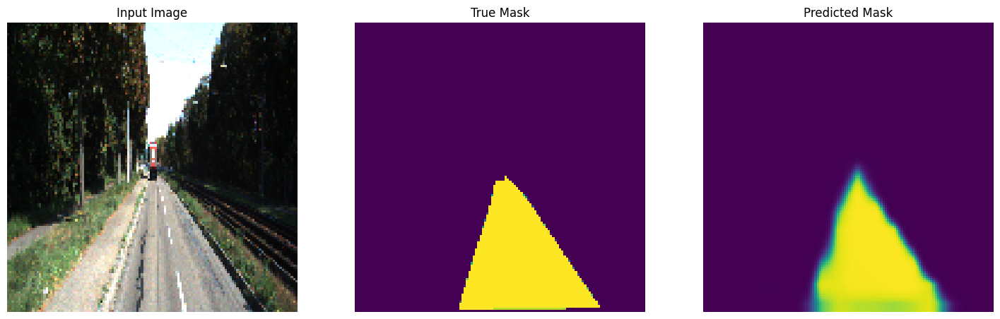


Sample Prediction after epoch 127


Epoch 127: val_loss did not improve from 0.05631
7/7 [==============================] - 21s 3s/step - loss: 0.0610 - mse: 0.0174 - val_loss: 0.0614 - val_mse: 0.0178
Epoch 128/200
1/1 [==============================] - 0s 20ms/step


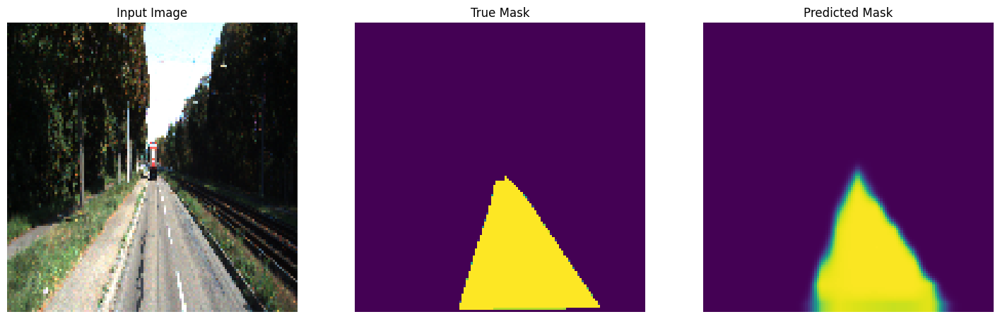


Sample Prediction after epoch 128


Epoch 128: val_loss did not improve from 0.05631
7/7 [==============================] - 22s 4s/step - loss: 0.0617 - mse: 0.0176 - val_loss: 0.0594 - val_mse: 0.0169
Epoch 129/200
1/1 [==============================] - 0s 20ms/step


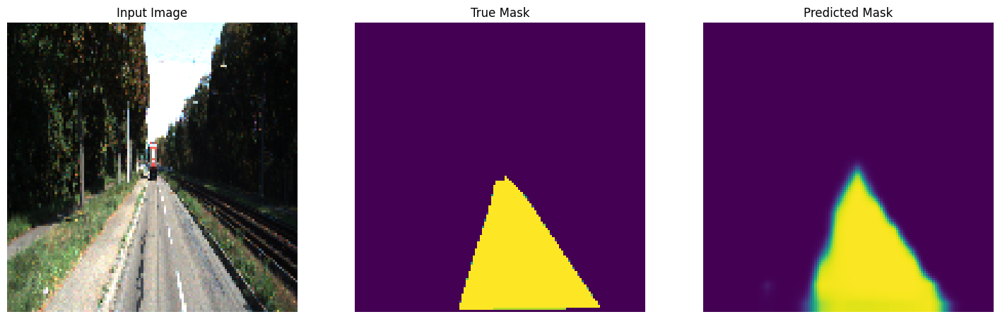


Sample Prediction after epoch 129


Epoch 129: val_loss did not improve from 0.05631
7/7 [==============================] - 26s 4s/step - loss: 0.0589 - mse: 0.0166 - val_loss: 0.0573 - val_mse: 0.0164
Epoch 130/200
1/1 [==============================] - 0s 21ms/step


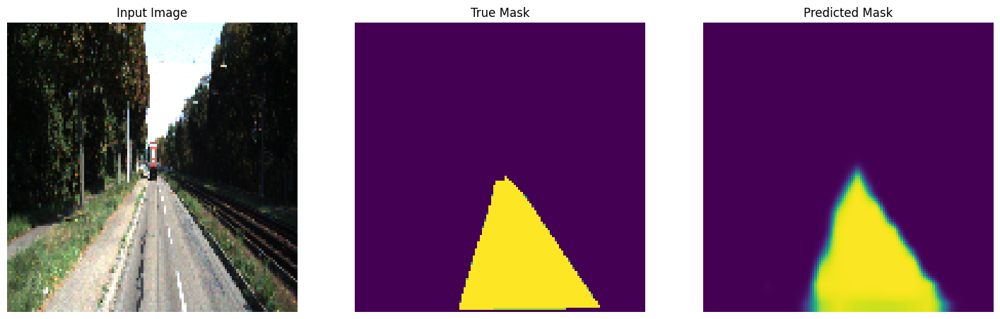


Sample Prediction after epoch 130


Epoch 130: val_loss did not improve from 0.05631
7/7 [==============================] - 26s 4s/step - loss: 0.0582 - mse: 0.0165 - val_loss: 0.0567 - val_mse: 0.0160
Epoch 131/200
1/1 [==============================] - 0s 20ms/step


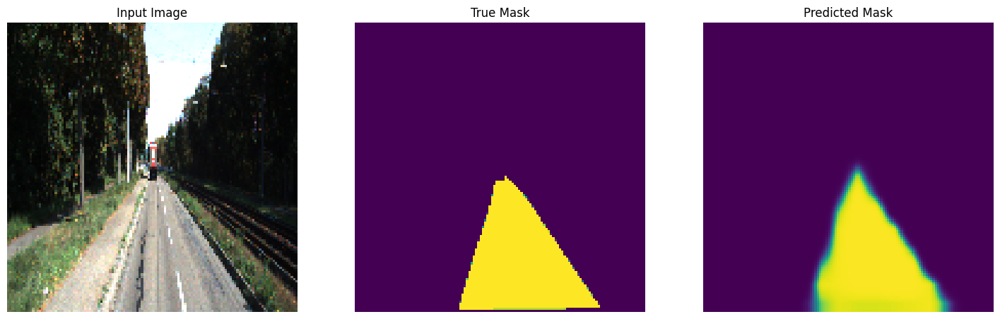


Sample Prediction after epoch 131


Epoch 131: val_loss did not improve from 0.05631
7/7 [==============================] - 22s 4s/step - loss: 0.0580 - mse: 0.0164 - val_loss: 0.0588 - val_mse: 0.0167
Epoch 132/200
1/1 [==============================] - 0s 31ms/step


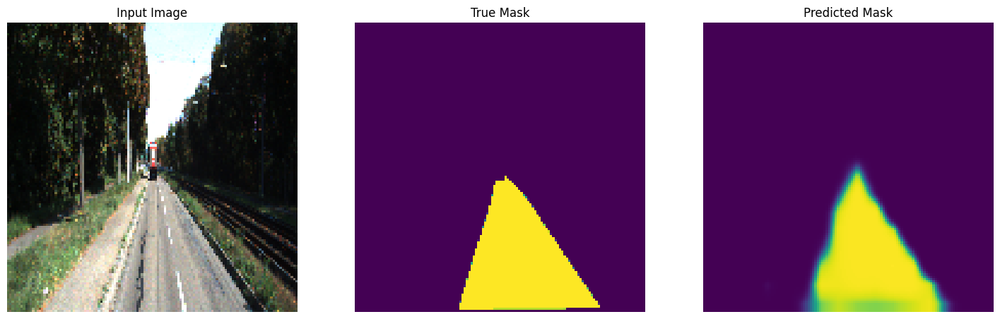


Sample Prediction after epoch 132


Epoch 132: val_loss did not improve from 0.05631
7/7 [==============================] - 22s 4s/step - loss: 0.0580 - mse: 0.0165 - val_loss: 0.0570 - val_mse: 0.0164
Epoch 133/200
1/1 [==============================] - 0s 19ms/step


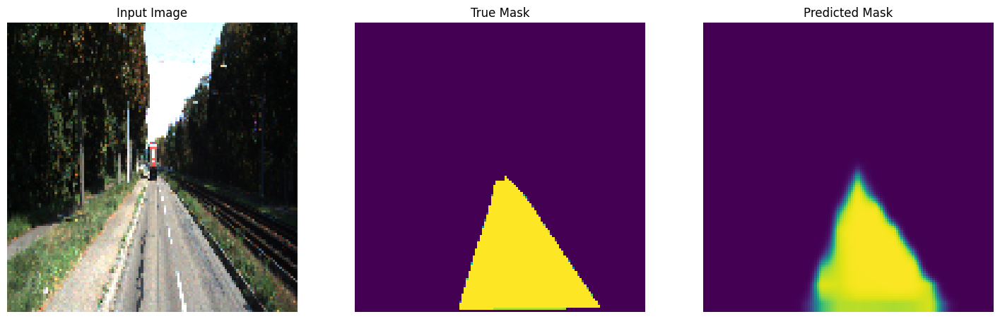


Sample Prediction after epoch 133


Epoch 133: val_loss did not improve from 0.05631
7/7 [==============================] - 26s 4s/step - loss: 0.0576 - mse: 0.0165 - val_loss: 0.0642 - val_mse: 0.0186
Epoch 134/200
1/1 [==============================] - 0s 19ms/step


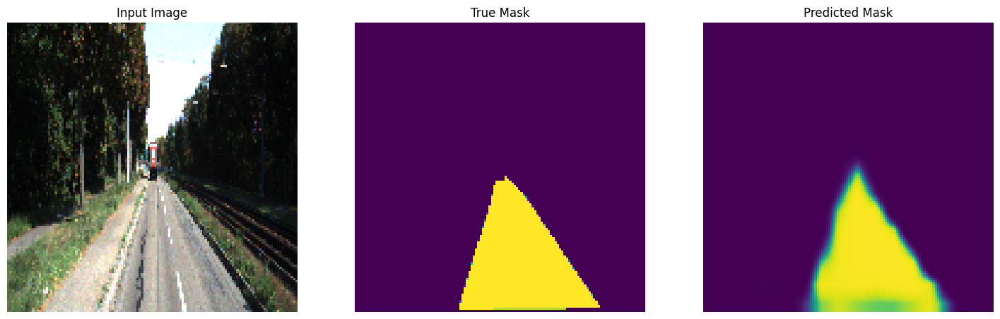


Sample Prediction after epoch 134


Epoch 134: val_loss did not improve from 0.05631
7/7 [==============================] - 26s 4s/step - loss: 0.0599 - mse: 0.0172 - val_loss: 0.0592 - val_mse: 0.0166
Epoch 135/200
1/1 [==============================] - 0s 20ms/step


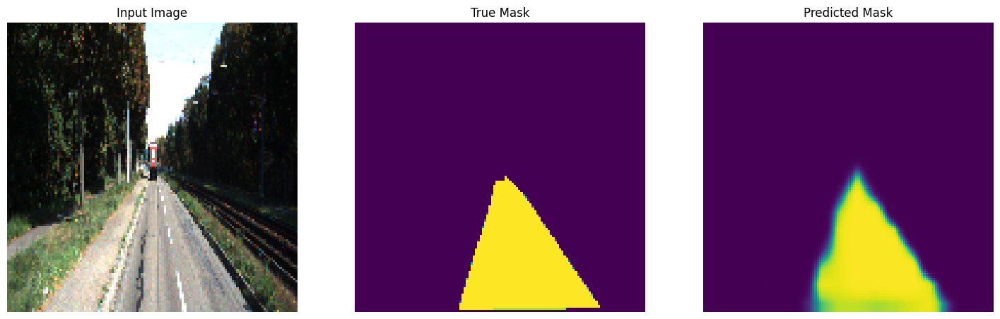


Sample Prediction after epoch 135


Epoch 135: val_loss did not improve from 0.05631
7/7 [==============================] - 22s 4s/step - loss: 0.0555 - mse: 0.0156 - val_loss: 0.0578 - val_mse: 0.0162
Epoch 136/200
1/1 [==============================] - 0s 20ms/step


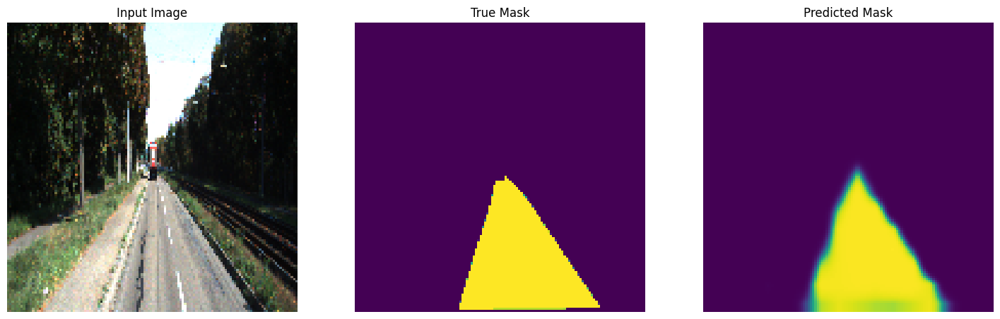


Sample Prediction after epoch 136


Epoch 136: val_loss improved from 0.05631 to 0.05382, saving model to best_model.h5
7/7 [==============================] - 19s 3s/step - loss: 0.0585 - mse: 0.0168 - val_loss: 0.0538 - val_mse: 0.0155
Epoch 137/200
1/1 [==============================] - 0s 20ms/step


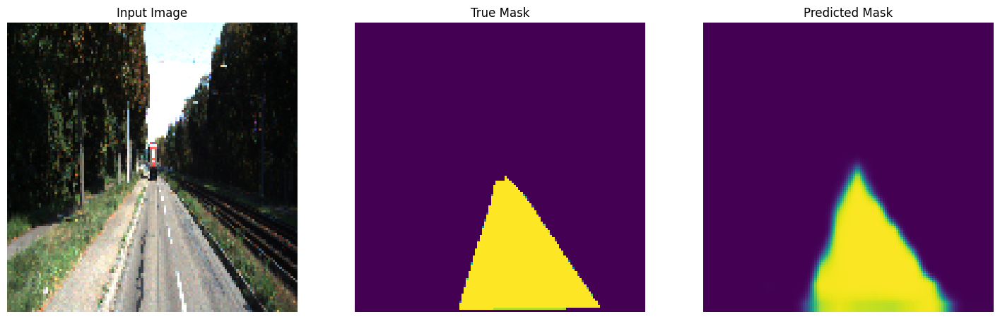


Sample Prediction after epoch 137


Epoch 137: val_loss did not improve from 0.05382
7/7 [==============================] - 27s 4s/step - loss: 0.0545 - mse: 0.0154 - val_loss: 0.0550 - val_mse: 0.0155
Epoch 138/200
1/1 [==============================] - 0s 21ms/step


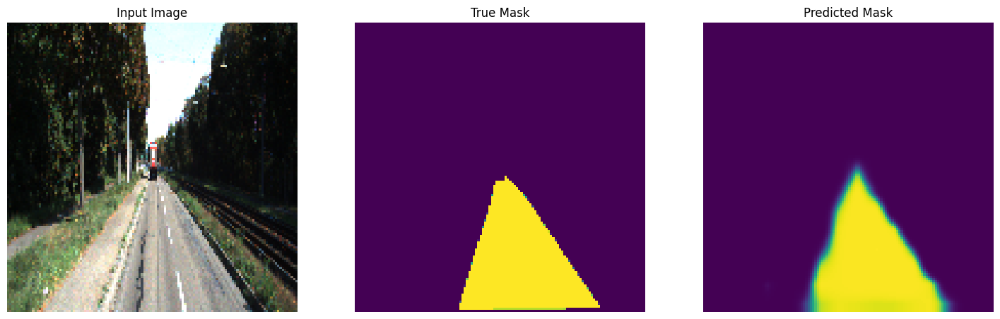


Sample Prediction after epoch 138


Epoch 138: val_loss improved from 0.05382 to 0.05178, saving model to best_model.h5
7/7 [==============================] - 21s 3s/step - loss: 0.0569 - mse: 0.0160 - val_loss: 0.0518 - val_mse: 0.0147
Epoch 139/200
1/1 [==============================] - 0s 19ms/step


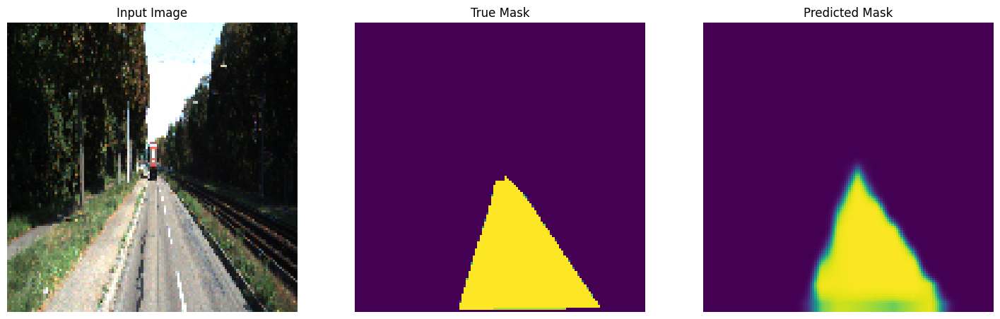


Sample Prediction after epoch 139


Epoch 139: val_loss did not improve from 0.05178
7/7 [==============================] - 21s 4s/step - loss: 0.0552 - mse: 0.0155 - val_loss: 0.0544 - val_mse: 0.0150
Epoch 140/200
1/1 [==============================] - 0s 20ms/step


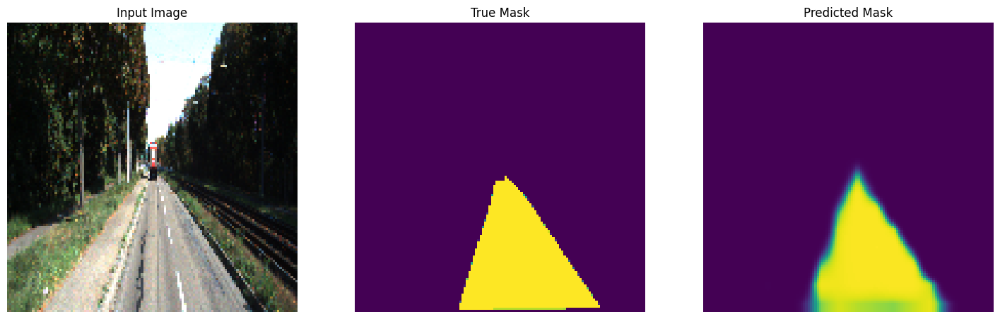


Sample Prediction after epoch 140


Epoch 140: val_loss did not improve from 0.05178
7/7 [==============================] - 26s 4s/step - loss: 0.0547 - mse: 0.0156 - val_loss: 0.0524 - val_mse: 0.0146
Epoch 141/200
1/1 [==============================] - 0s 20ms/step


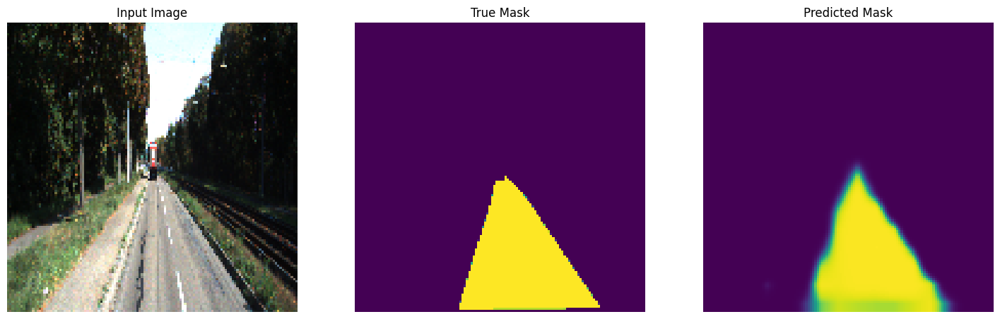


Sample Prediction after epoch 141


Epoch 141: val_loss improved from 0.05178 to 0.05052, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0530 - mse: 0.0147 - val_loss: 0.0505 - val_mse: 0.0145
Epoch 142/200
1/1 [==============================] - 0s 19ms/step


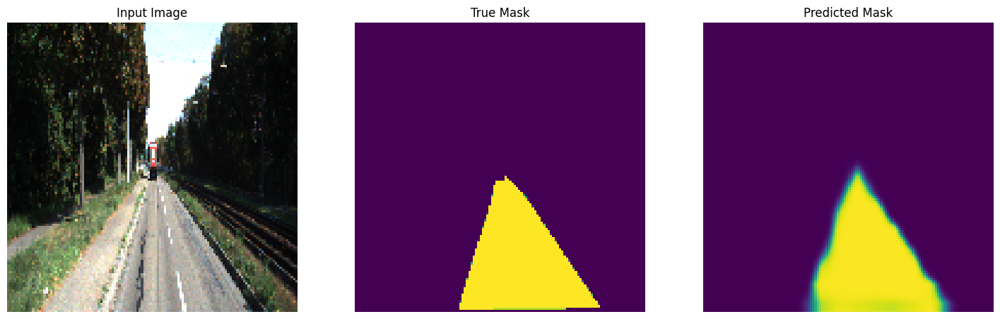


Sample Prediction after epoch 142


Epoch 142: val_loss improved from 0.05052 to 0.04858, saving model to best_model.h5
7/7 [==============================] - 22s 4s/step - loss: 0.0517 - mse: 0.0148 - val_loss: 0.0486 - val_mse: 0.0134
Epoch 143/200
1/1 [==============================] - 0s 30ms/step


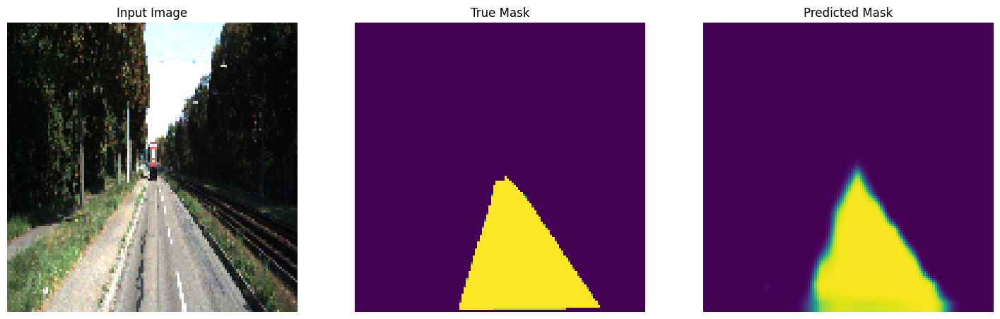


Sample Prediction after epoch 143


Epoch 143: val_loss did not improve from 0.04858
7/7 [==============================] - 22s 4s/step - loss: 0.0531 - mse: 0.0148 - val_loss: 0.0533 - val_mse: 0.0153
Epoch 144/200
1/1 [==============================] - 0s 20ms/step


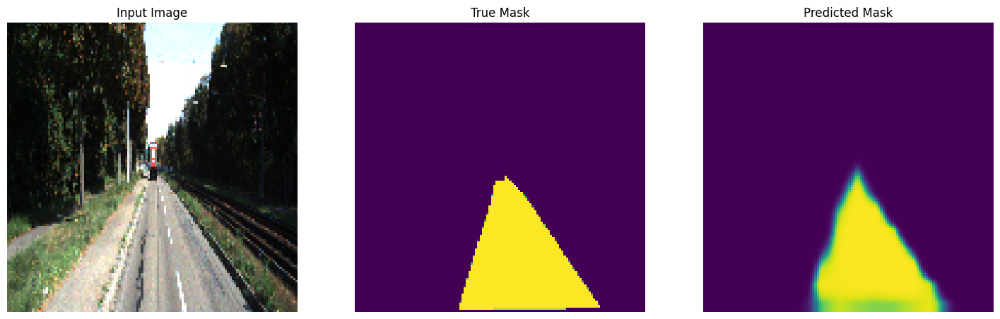


Sample Prediction after epoch 144


Epoch 144: val_loss did not improve from 0.04858
7/7 [==============================] - 21s 3s/step - loss: 0.0512 - mse: 0.0146 - val_loss: 0.0513 - val_mse: 0.0138
Epoch 145/200
1/1 [==============================] - 0s 20ms/step


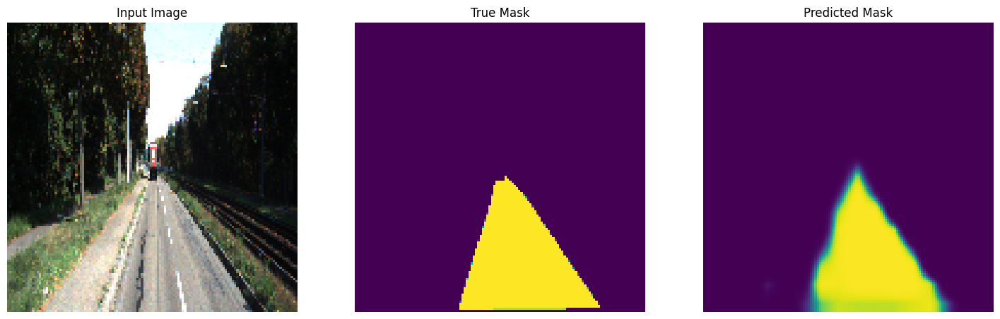


Sample Prediction after epoch 145


Epoch 145: val_loss did not improve from 0.04858
7/7 [==============================] - 27s 4s/step - loss: 0.0540 - mse: 0.0153 - val_loss: 0.0585 - val_mse: 0.0170
Epoch 146/200
1/1 [==============================] - 0s 20ms/step


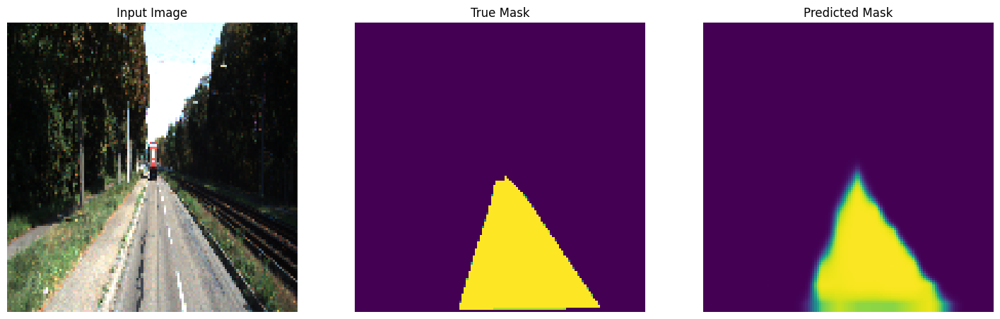


Sample Prediction after epoch 146


Epoch 146: val_loss did not improve from 0.04858
7/7 [==============================] - 26s 4s/step - loss: 0.0531 - mse: 0.0150 - val_loss: 0.0516 - val_mse: 0.0149
Epoch 147/200
1/1 [==============================] - 0s 21ms/step


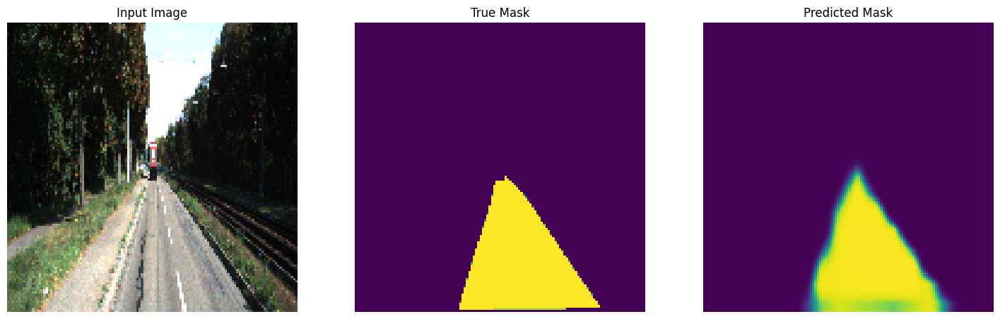


Sample Prediction after epoch 147


Epoch 147: val_loss did not improve from 0.04858
7/7 [==============================] - 21s 3s/step - loss: 0.0526 - mse: 0.0150 - val_loss: 0.0517 - val_mse: 0.0146
Epoch 148/200
1/1 [==============================] - 0s 20ms/step


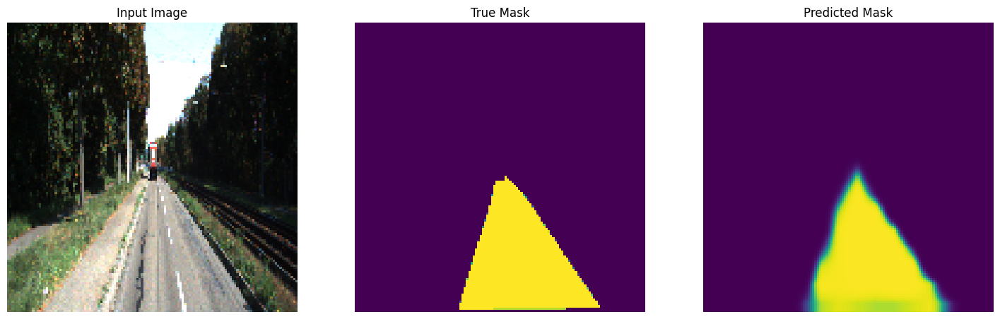


Sample Prediction after epoch 148


Epoch 148: val_loss improved from 0.04858 to 0.04853, saving model to best_model.h5
7/7 [==============================] - 21s 4s/step - loss: 0.0509 - mse: 0.0145 - val_loss: 0.0485 - val_mse: 0.0136
Epoch 149/200
1/1 [==============================] - 0s 20ms/step


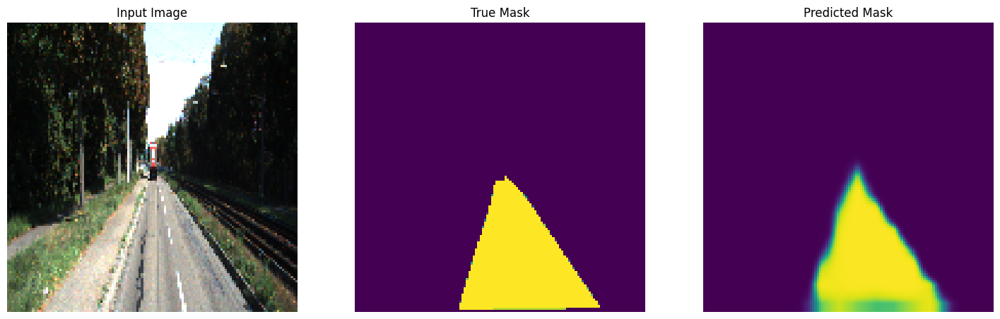


Sample Prediction after epoch 149


Epoch 149: val_loss did not improve from 0.04853
7/7 [==============================] - 22s 4s/step - loss: 0.0498 - mse: 0.0142 - val_loss: 0.0519 - val_mse: 0.0147
Epoch 150/200
1/1 [==============================] - 0s 23ms/step


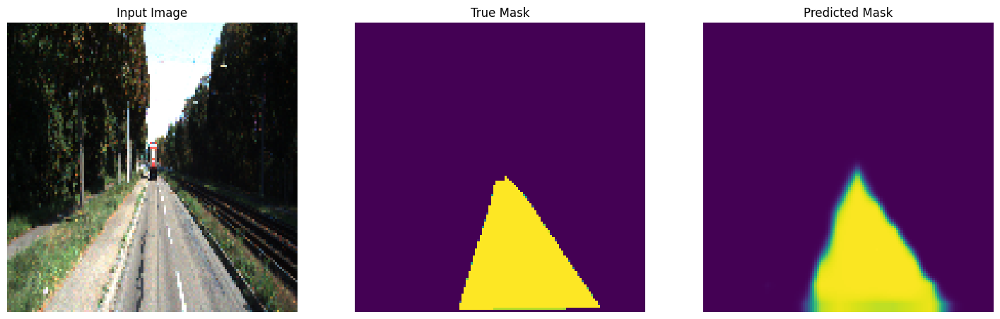


Sample Prediction after epoch 150


Epoch 150: val_loss did not improve from 0.04853
7/7 [==============================] - 26s 4s/step - loss: 0.0529 - mse: 0.0149 - val_loss: 0.0515 - val_mse: 0.0148
Epoch 151/200
1/1 [==============================] - 0s 20ms/step


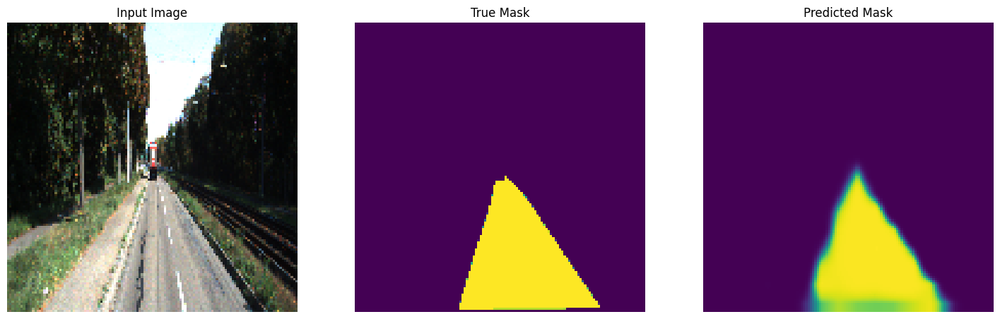


Sample Prediction after epoch 151


Epoch 151: val_loss did not improve from 0.04853
7/7 [==============================] - 22s 4s/step - loss: 0.0493 - mse: 0.0140 - val_loss: 0.0491 - val_mse: 0.0138
Epoch 152/200
1/1 [==============================] - 0s 20ms/step


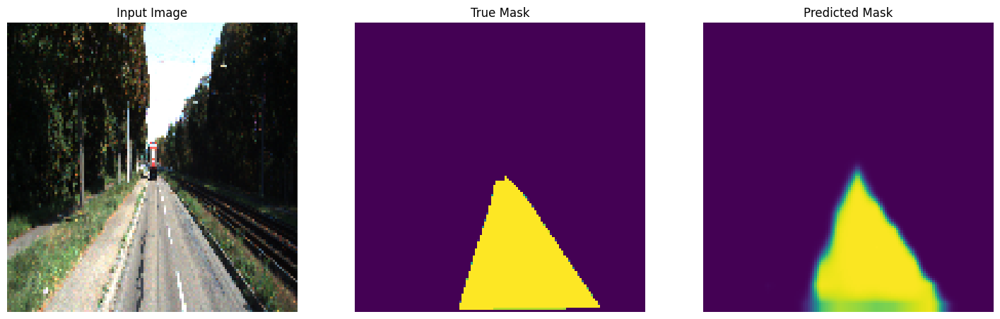


Sample Prediction after epoch 152


Epoch 152: val_loss did not improve from 0.04853
7/7 [==============================] - 22s 4s/step - loss: 0.0499 - mse: 0.0141 - val_loss: 0.0500 - val_mse: 0.0143
Epoch 153/200
1/1 [==============================] - 0s 21ms/step


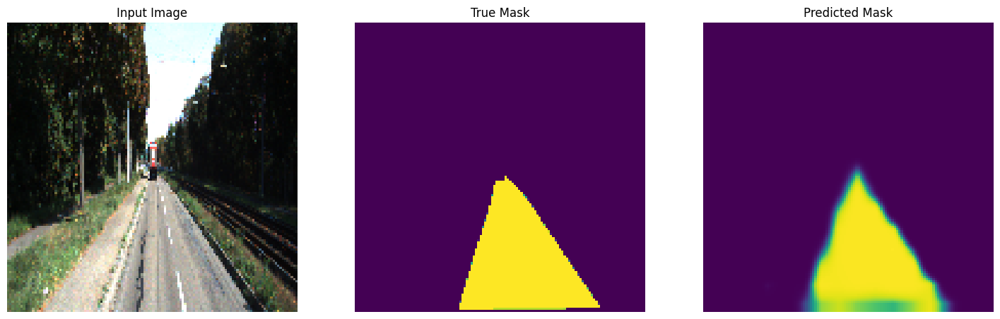


Sample Prediction after epoch 153


Epoch 153: val_loss did not improve from 0.04853
7/7 [==============================] - 26s 4s/step - loss: 0.0502 - mse: 0.0143 - val_loss: 0.0496 - val_mse: 0.0142
Epoch 154/200
1/1 [==============================] - 0s 19ms/step


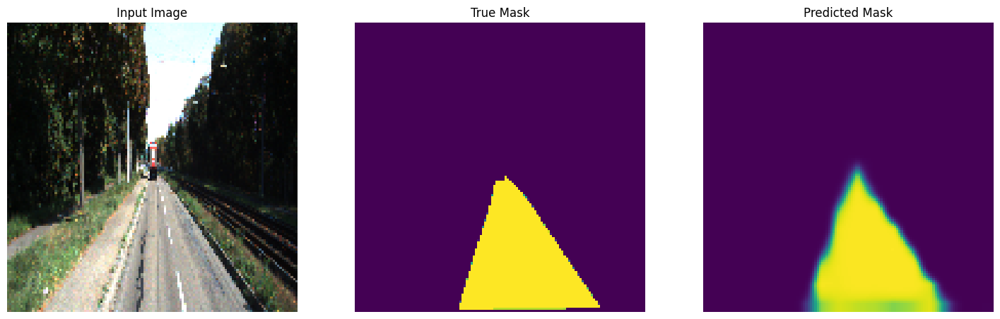


Sample Prediction after epoch 154


Epoch 154: val_loss did not improve from 0.04853
7/7 [==============================] - 26s 4s/step - loss: 0.0521 - mse: 0.0147 - val_loss: 0.0491 - val_mse: 0.0140
Epoch 155/200
1/1 [==============================] - 0s 19ms/step


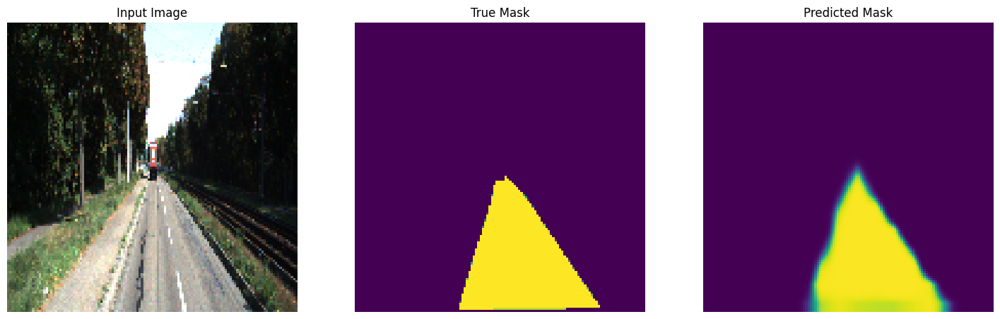


Sample Prediction after epoch 155


Epoch 155: val_loss improved from 0.04853 to 0.04687, saving model to best_model.h5
7/7 [==============================] - 23s 4s/step - loss: 0.0486 - mse: 0.0137 - val_loss: 0.0469 - val_mse: 0.0134
Epoch 156/200
1/1 [==============================] - 0s 19ms/step


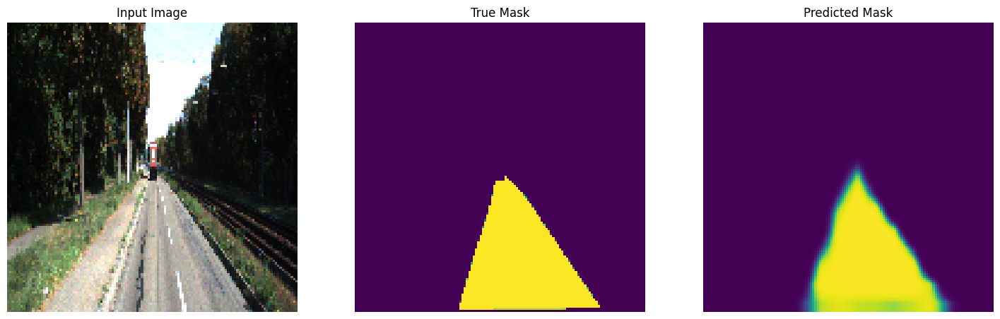


Sample Prediction after epoch 156


Epoch 156: val_loss did not improve from 0.04687
7/7 [==============================] - 26s 4s/step - loss: 0.0500 - mse: 0.0142 - val_loss: 0.0480 - val_mse: 0.0138
Epoch 157/200
1/1 [==============================] - 0s 19ms/step


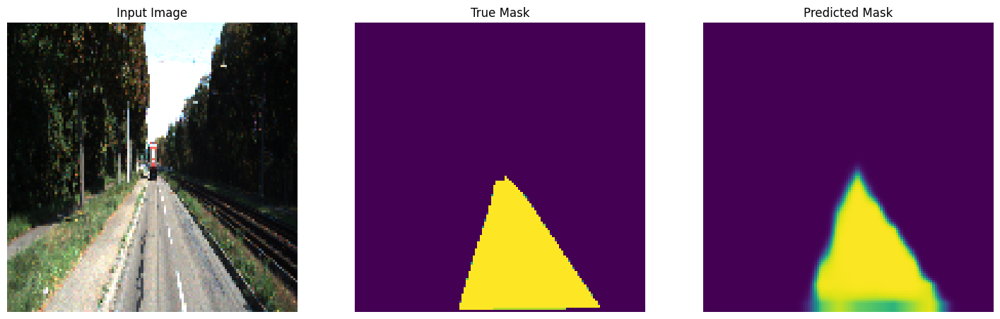


Sample Prediction after epoch 157


Epoch 157: val_loss did not improve from 0.04687
7/7 [==============================] - 22s 4s/step - loss: 0.0479 - mse: 0.0136 - val_loss: 0.0499 - val_mse: 0.0144
Epoch 158/200
1/1 [==============================] - 0s 20ms/step


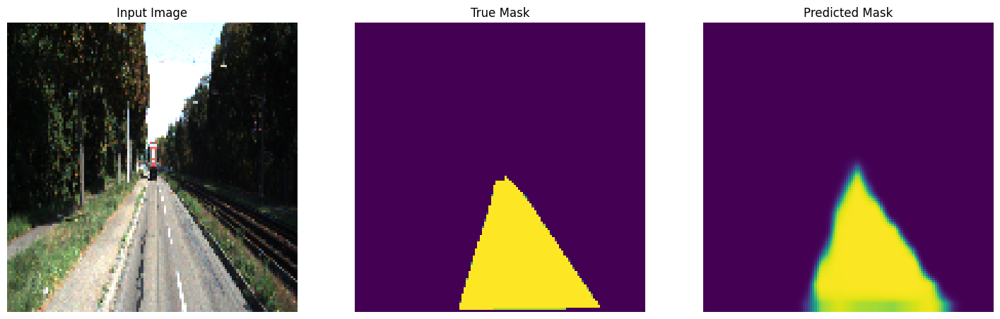


Sample Prediction after epoch 158


Epoch 158: val_loss did not improve from 0.04687
7/7 [==============================] - 26s 4s/step - loss: 0.0501 - mse: 0.0143 - val_loss: 0.0510 - val_mse: 0.0148
Epoch 159/200
1/1 [==============================] - 0s 25ms/step


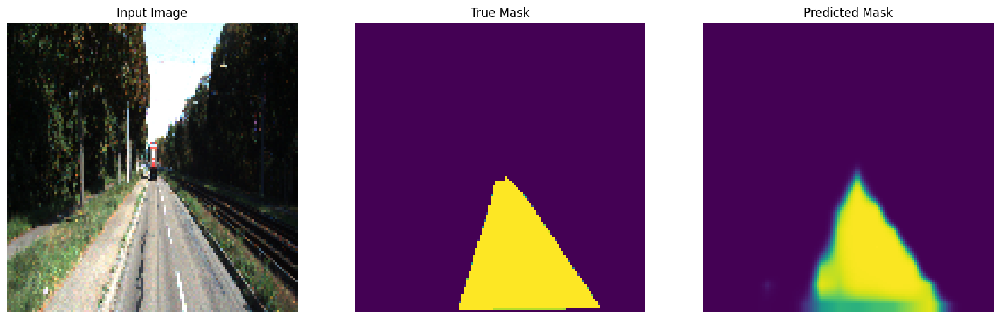


Sample Prediction after epoch 159


Epoch 159: val_loss did not improve from 0.04687
7/7 [==============================] - 22s 4s/step - loss: 0.0601 - mse: 0.0173 - val_loss: 0.0569 - val_mse: 0.0164
Epoch 160/200
1/1 [==============================] - 0s 21ms/step


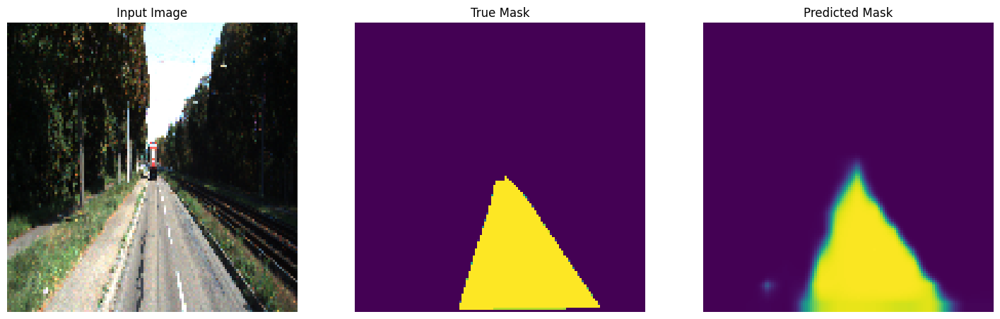


Sample Prediction after epoch 160


Epoch 160: val_loss did not improve from 0.04687
7/7 [==============================] - 26s 4s/step - loss: 0.0579 - mse: 0.0164 - val_loss: 0.0529 - val_mse: 0.0149
Epoch 161/200
1/1 [==============================] - 0s 20ms/step


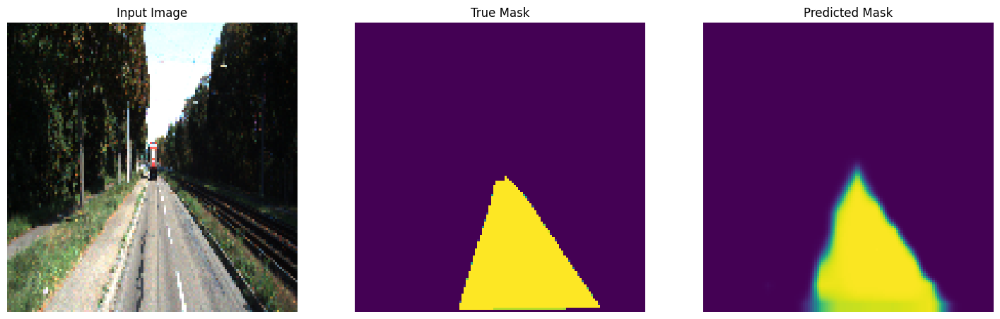


Sample Prediction after epoch 161


Epoch 161: val_loss did not improve from 0.04687
7/7 [==============================] - 22s 4s/step - loss: 0.0560 - mse: 0.0160 - val_loss: 0.0527 - val_mse: 0.0144
Epoch 162/200
1/1 [==============================] - 0s 20ms/step


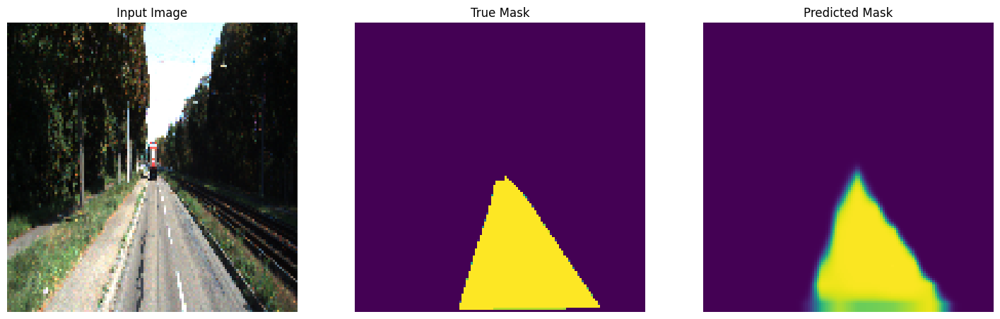


Sample Prediction after epoch 162


Epoch 162: val_loss did not improve from 0.04687
7/7 [==============================] - 27s 4s/step - loss: 0.0525 - mse: 0.0150 - val_loss: 0.0518 - val_mse: 0.0147
Epoch 163/200
1/1 [==============================] - 0s 20ms/step


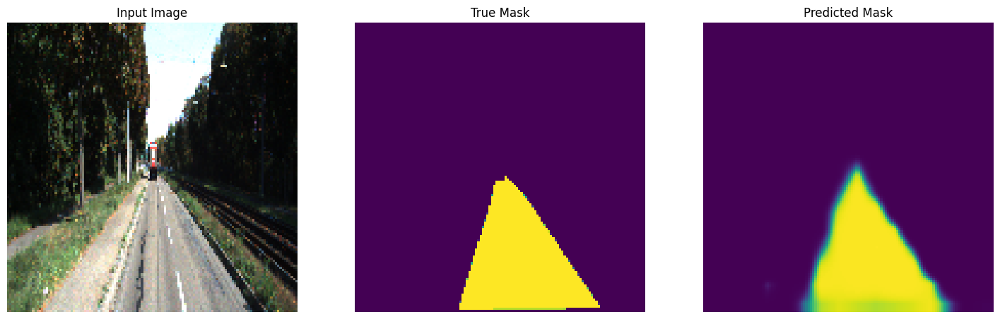


Sample Prediction after epoch 163


Epoch 163: val_loss did not improve from 0.04687
7/7 [==============================] - 22s 4s/step - loss: 0.0520 - mse: 0.0147 - val_loss: 0.0488 - val_mse: 0.0138
Epoch 164/200
1/1 [==============================] - 0s 20ms/step


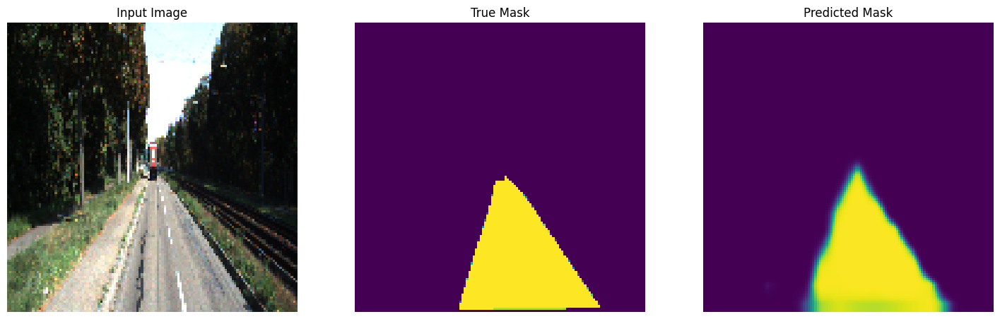


Sample Prediction after epoch 164


Epoch 164: val_loss did not improve from 0.04687
7/7 [==============================] - 26s 4s/step - loss: 0.0507 - mse: 0.0143 - val_loss: 0.0494 - val_mse: 0.0138
Epoch 165/200
1/1 [==============================] - 0s 20ms/step


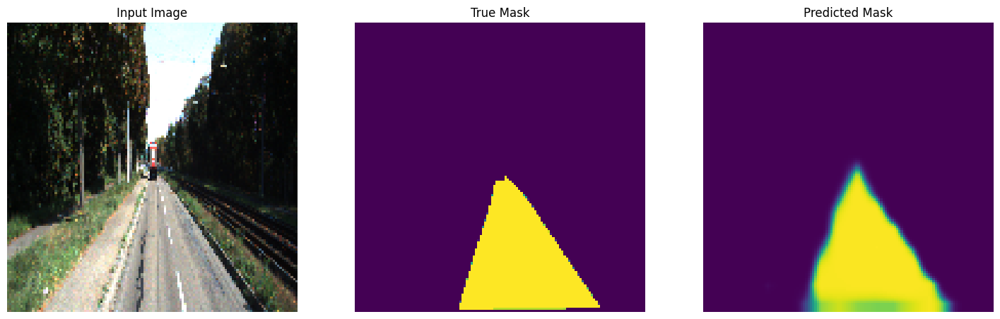


Sample Prediction after epoch 165


Epoch 165: val_loss did not improve from 0.04687
7/7 [==============================] - 22s 4s/step - loss: 0.0494 - mse: 0.0140 - val_loss: 0.0528 - val_mse: 0.0153
Epoch 166/200
1/1 [==============================] - 0s 20ms/step


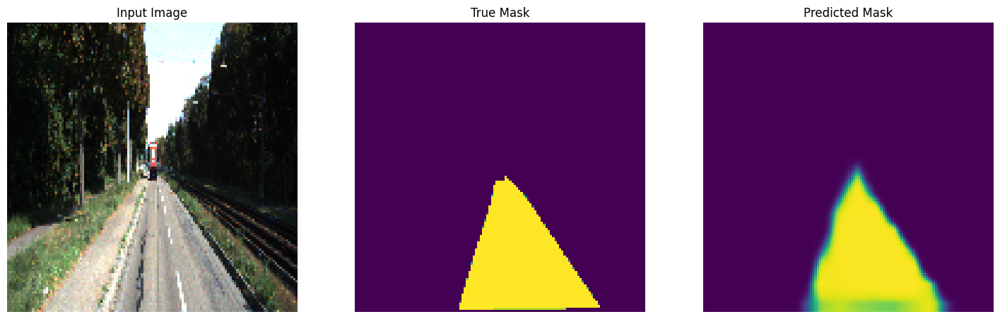


Sample Prediction after epoch 166


Epoch 166: val_loss did not improve from 0.04687
7/7 [==============================] - 26s 4s/step - loss: 0.0484 - mse: 0.0138 - val_loss: 0.0496 - val_mse: 0.0143
Epoch 167/200
1/1 [==============================] - 0s 20ms/step


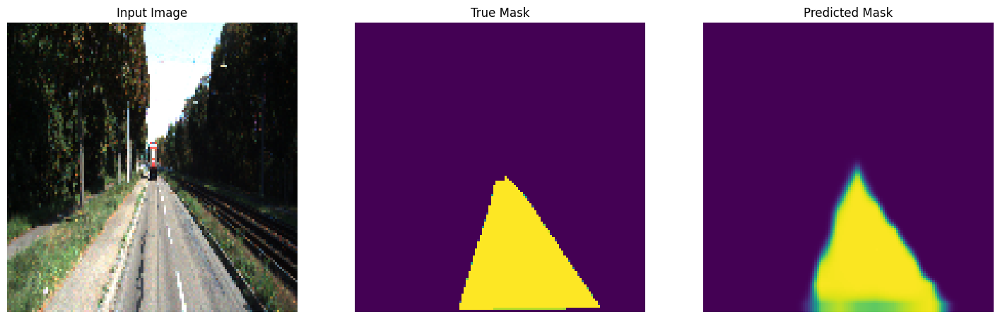


Sample Prediction after epoch 167


Epoch 167: val_loss did not improve from 0.04687
7/7 [==============================] - 26s 4s/step - loss: 0.0477 - mse: 0.0134 - val_loss: 0.0495 - val_mse: 0.0141
Epoch 168/200
1/1 [==============================] - 0s 20ms/step


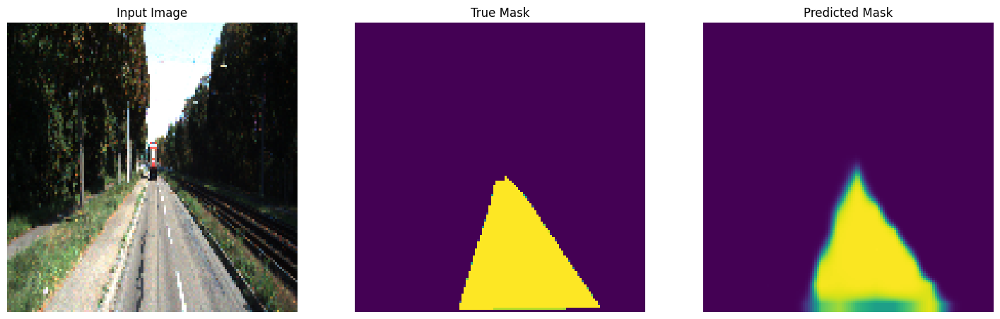


Sample Prediction after epoch 168


Epoch 168: val_loss improved from 0.04687 to 0.04611, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0504 - mse: 0.0144 - val_loss: 0.0461 - val_mse: 0.0131
Epoch 169/200
1/1 [==============================] - 0s 25ms/step


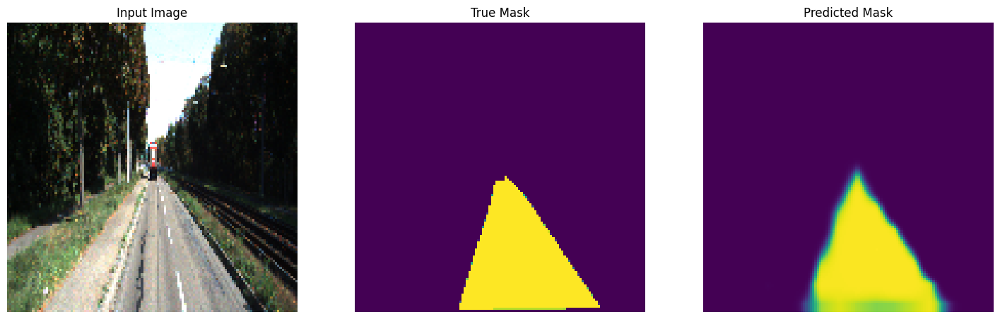


Sample Prediction after epoch 169


Epoch 169: val_loss did not improve from 0.04611
7/7 [==============================] - 27s 4s/step - loss: 0.0488 - mse: 0.0138 - val_loss: 0.0462 - val_mse: 0.0133
Epoch 170/200
1/1 [==============================] - 0s 29ms/step


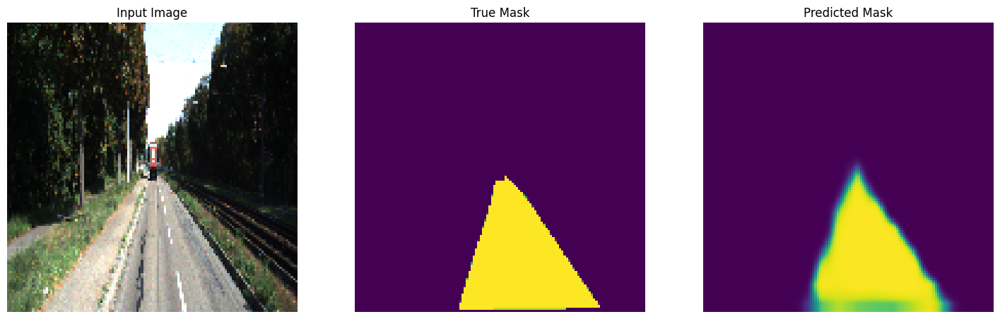


Sample Prediction after epoch 170


Epoch 170: val_loss did not improve from 0.04611
7/7 [==============================] - 27s 4s/step - loss: 0.0492 - mse: 0.0139 - val_loss: 0.0470 - val_mse: 0.0134
Epoch 171/200
1/1 [==============================] - 0s 20ms/step


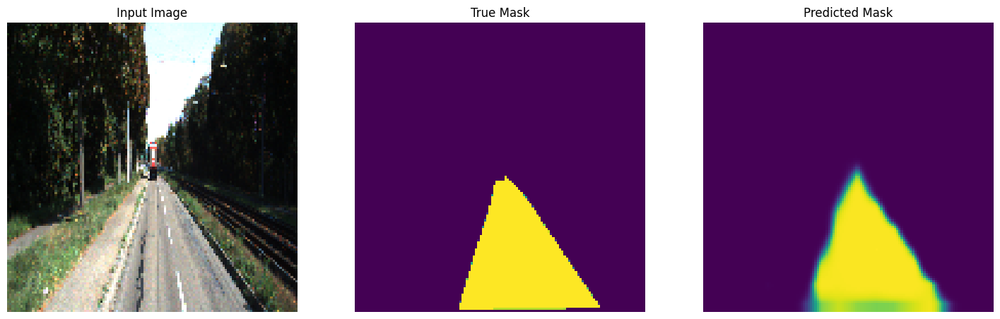


Sample Prediction after epoch 171


Epoch 171: val_loss did not improve from 0.04611
7/7 [==============================] - 22s 4s/step - loss: 0.0451 - mse: 0.0128 - val_loss: 0.0468 - val_mse: 0.0135
Epoch 172/200
1/1 [==============================] - 0s 30ms/step


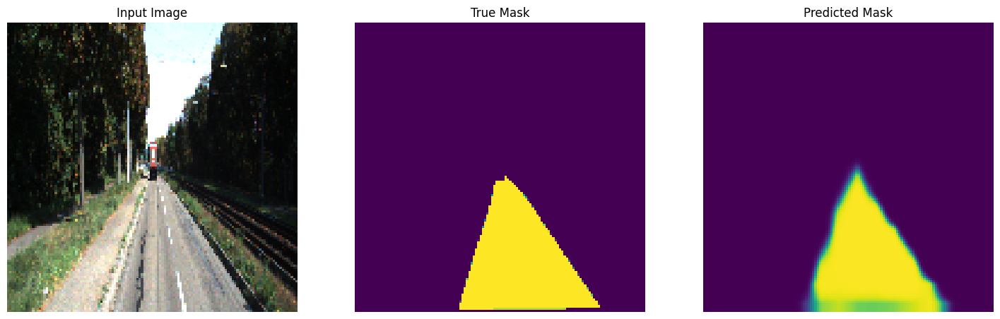


Sample Prediction after epoch 172


Epoch 172: val_loss did not improve from 0.04611
7/7 [==============================] - 27s 4s/step - loss: 0.0442 - mse: 0.0126 - val_loss: 0.0483 - val_mse: 0.0137
Epoch 173/200
1/1 [==============================] - 0s 20ms/step


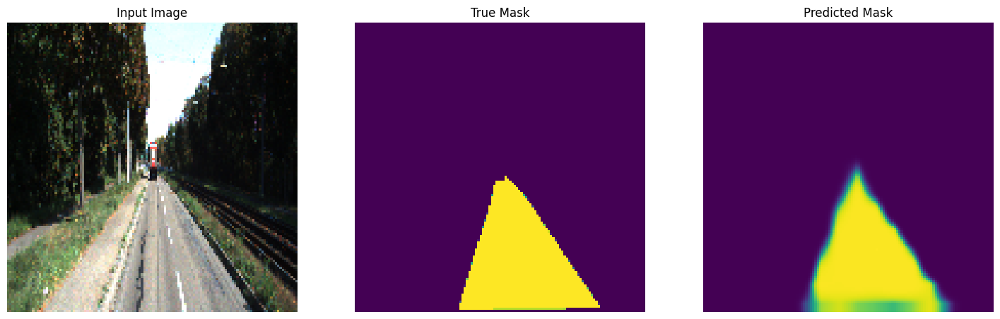


Sample Prediction after epoch 173


Epoch 173: val_loss improved from 0.04611 to 0.04408, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0481 - mse: 0.0137 - val_loss: 0.0441 - val_mse: 0.0126
Epoch 174/200
1/1 [==============================] - 0s 27ms/step


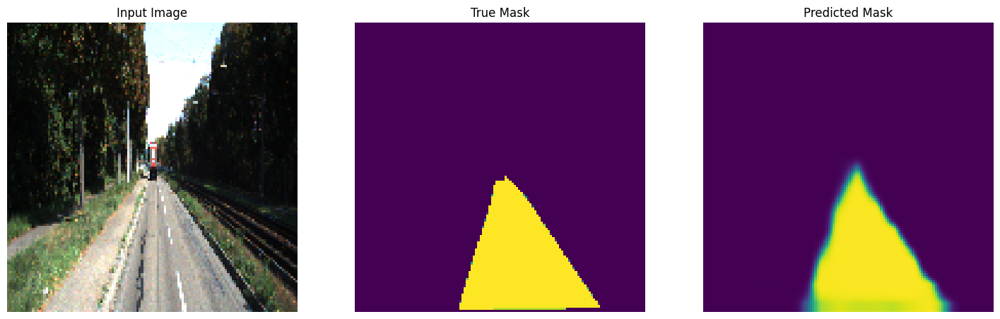


Sample Prediction after epoch 174


Epoch 174: val_loss did not improve from 0.04408
7/7 [==============================] - 22s 4s/step - loss: 0.0447 - mse: 0.0126 - val_loss: 0.0458 - val_mse: 0.0128
Epoch 175/200
1/1 [==============================] - 0s 19ms/step


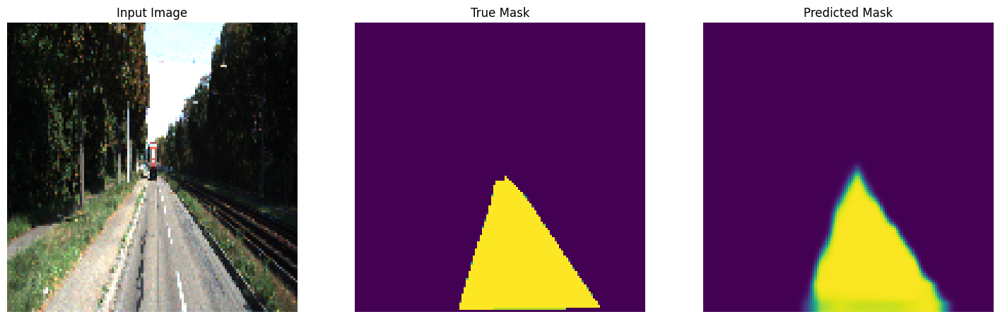


Sample Prediction after epoch 175


Epoch 175: val_loss did not improve from 0.04408
7/7 [==============================] - 26s 4s/step - loss: 0.0472 - mse: 0.0136 - val_loss: 0.0468 - val_mse: 0.0133
Epoch 176/200
1/1 [==============================] - 0s 19ms/step


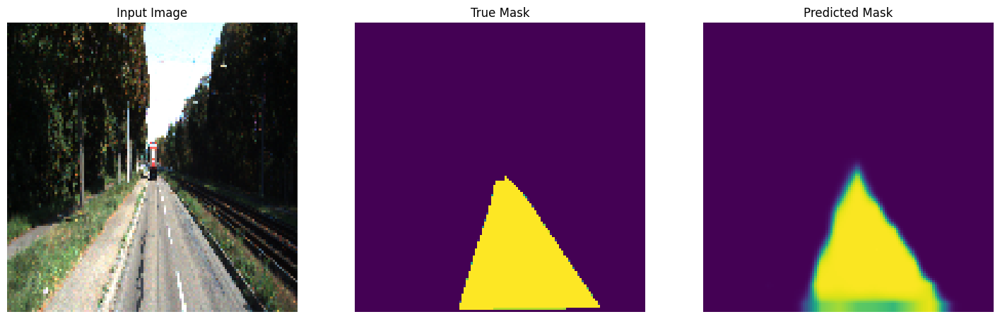


Sample Prediction after epoch 176


Epoch 176: val_loss improved from 0.04408 to 0.04377, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0456 - mse: 0.0129 - val_loss: 0.0438 - val_mse: 0.0128
Epoch 177/200
1/1 [==============================] - 0s 20ms/step


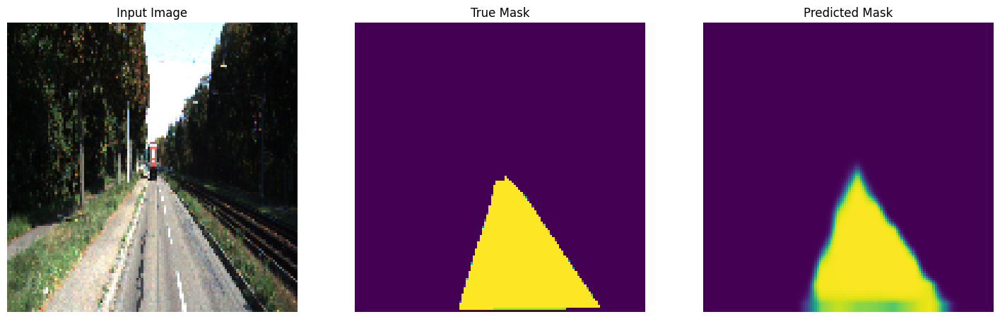


Sample Prediction after epoch 177


Epoch 177: val_loss improved from 0.04377 to 0.04301, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0435 - mse: 0.0124 - val_loss: 0.0430 - val_mse: 0.0122
Epoch 178/200
1/1 [==============================] - 0s 20ms/step


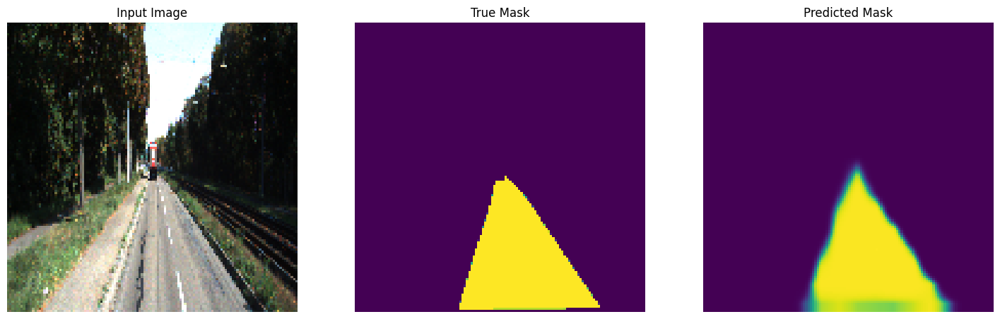


Sample Prediction after epoch 178


Epoch 178: val_loss did not improve from 0.04301
7/7 [==============================] - 27s 4s/step - loss: 0.0459 - mse: 0.0131 - val_loss: 0.0472 - val_mse: 0.0137
Epoch 179/200
1/1 [==============================] - 0s 20ms/step


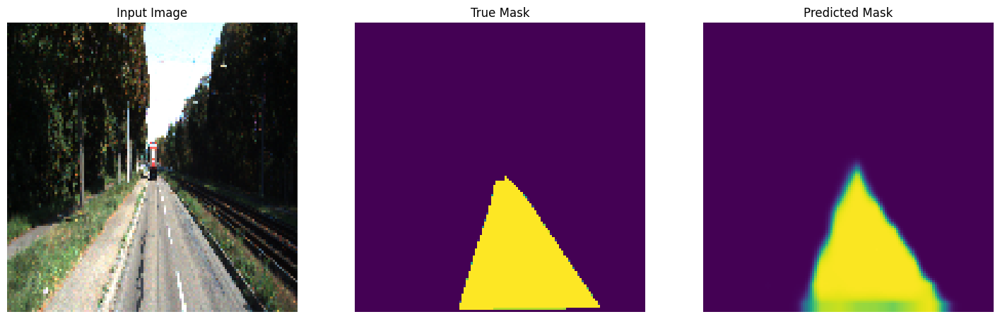


Sample Prediction after epoch 179


Epoch 179: val_loss did not improve from 0.04301
7/7 [==============================] - 27s 4s/step - loss: 0.0463 - mse: 0.0132 - val_loss: 0.0431 - val_mse: 0.0123
Epoch 180/200
1/1 [==============================] - 0s 27ms/step


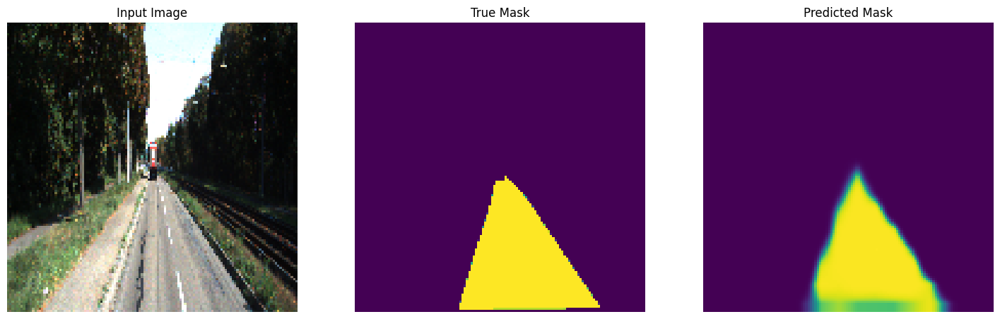


Sample Prediction after epoch 180


Epoch 180: val_loss improved from 0.04301 to 0.04215, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0456 - mse: 0.0129 - val_loss: 0.0422 - val_mse: 0.0122
Epoch 181/200
1/1 [==============================] - 0s 20ms/step


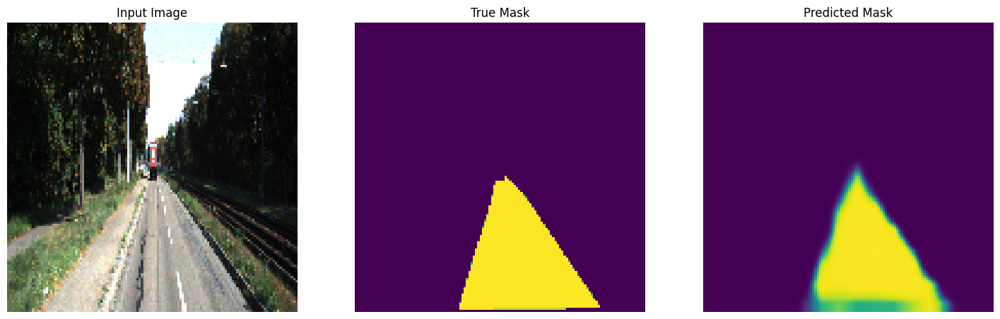


Sample Prediction after epoch 181


Epoch 181: val_loss did not improve from 0.04215
7/7 [==============================] - 21s 4s/step - loss: 0.0429 - mse: 0.0123 - val_loss: 0.0445 - val_mse: 0.0124
Epoch 182/200
1/1 [==============================] - 0s 21ms/step


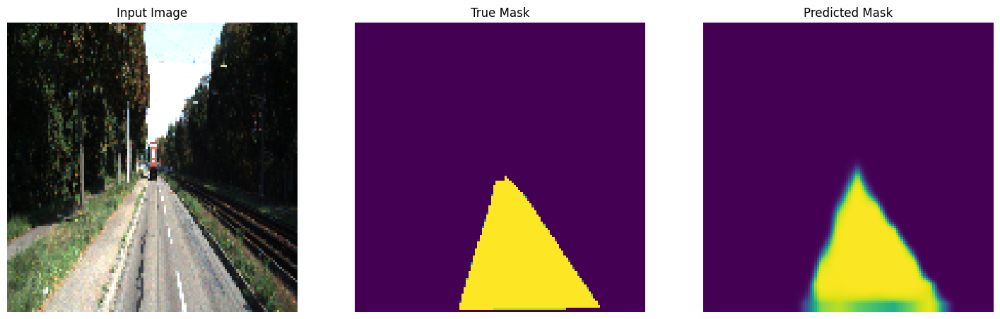


Sample Prediction after epoch 182


Epoch 182: val_loss improved from 0.04215 to 0.04152, saving model to best_model.h5
7/7 [==============================] - 28s 5s/step - loss: 0.0437 - mse: 0.0123 - val_loss: 0.0415 - val_mse: 0.0118
Epoch 183/200
1/1 [==============================] - 0s 20ms/step


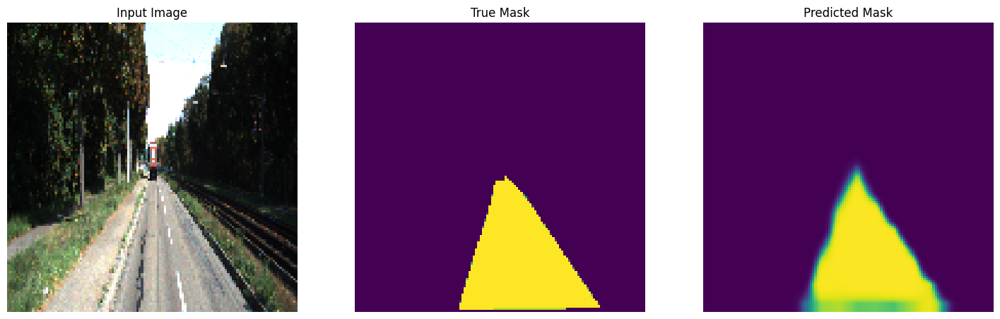


Sample Prediction after epoch 183


Epoch 183: val_loss did not improve from 0.04152
7/7 [==============================] - 26s 4s/step - loss: 0.0455 - mse: 0.0129 - val_loss: 0.0431 - val_mse: 0.0121
Epoch 184/200
1/1 [==============================] - 0s 20ms/step


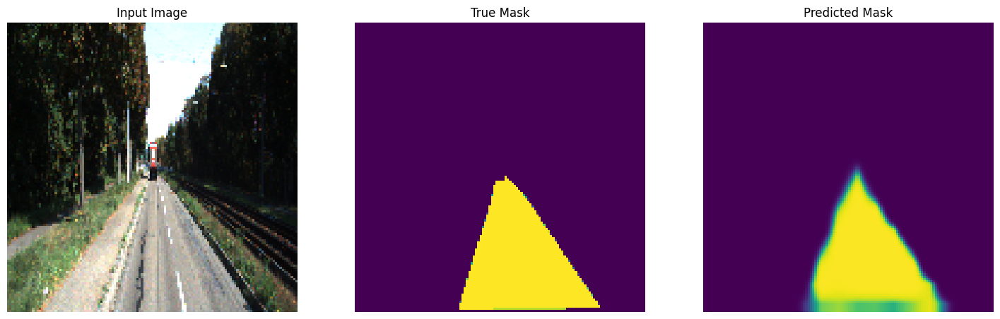


Sample Prediction after epoch 184


Epoch 184: val_loss did not improve from 0.04152
7/7 [==============================] - 27s 4s/step - loss: 0.0407 - mse: 0.0117 - val_loss: 0.0452 - val_mse: 0.0128
Epoch 185/200
1/1 [==============================] - 0s 26ms/step


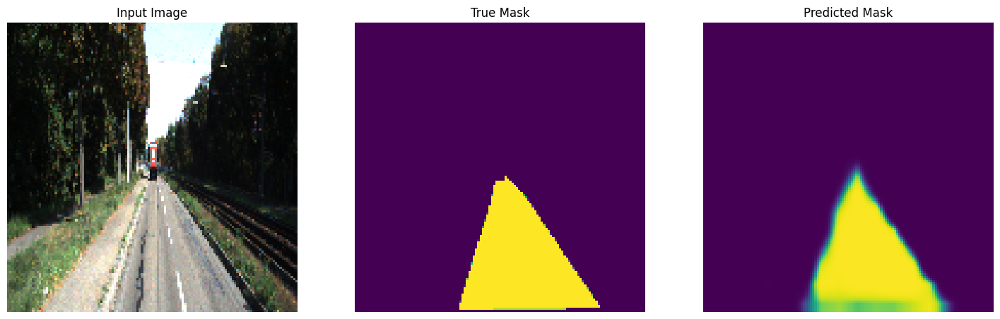


Sample Prediction after epoch 185


Epoch 185: val_loss did not improve from 0.04152
7/7 [==============================] - 23s 4s/step - loss: 0.0436 - mse: 0.0125 - val_loss: 0.0445 - val_mse: 0.0127
Epoch 186/200
1/1 [==============================] - 0s 19ms/step


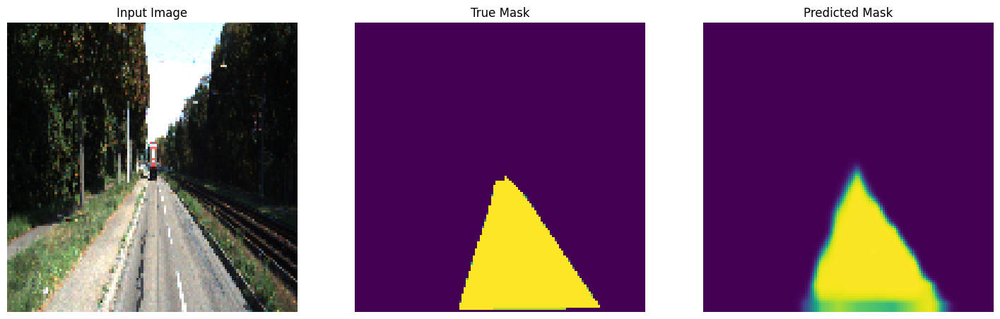


Sample Prediction after epoch 186


Epoch 186: val_loss did not improve from 0.04152
7/7 [==============================] - 22s 4s/step - loss: 0.0427 - mse: 0.0122 - val_loss: 0.0442 - val_mse: 0.0124
Epoch 187/200
1/1 [==============================] - 0s 20ms/step


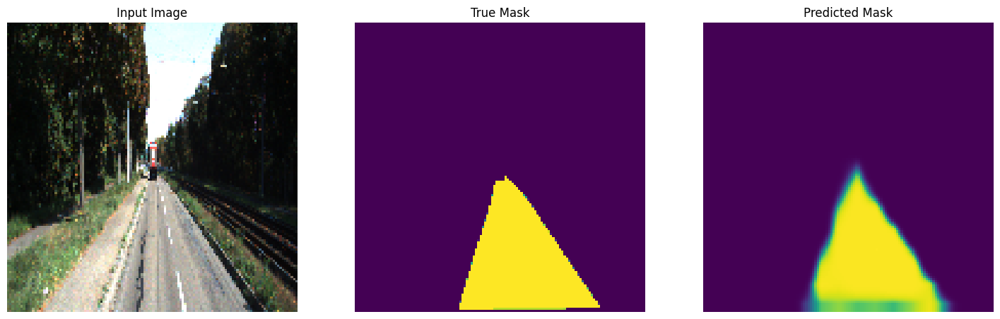


Sample Prediction after epoch 187


Epoch 187: val_loss did not improve from 0.04152
7/7 [==============================] - 21s 4s/step - loss: 0.0435 - mse: 0.0125 - val_loss: 0.0431 - val_mse: 0.0122
Epoch 188/200
1/1 [==============================] - 0s 20ms/step


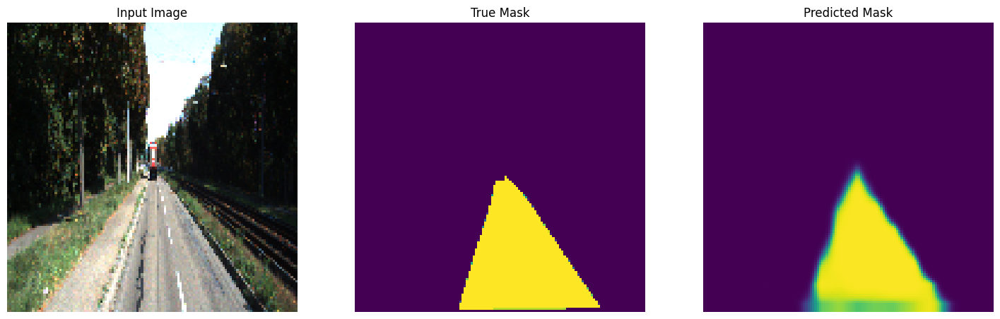


Sample Prediction after epoch 188


Epoch 188: val_loss did not improve from 0.04152
7/7 [==============================] - 27s 4s/step - loss: 0.0454 - mse: 0.0129 - val_loss: 0.0480 - val_mse: 0.0139
Epoch 189/200
1/1 [==============================] - 0s 20ms/step


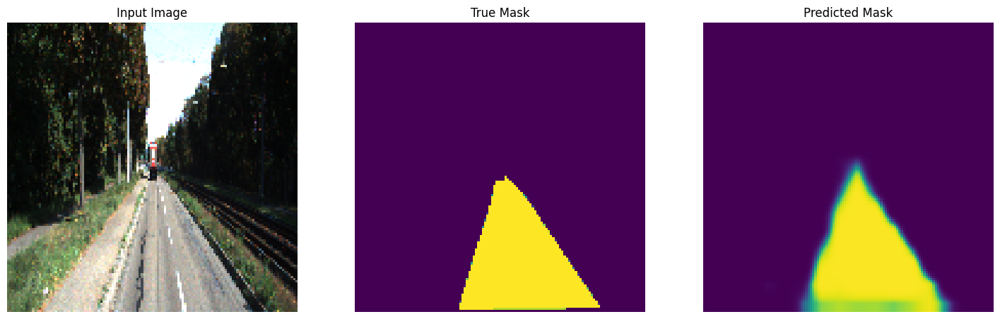


Sample Prediction after epoch 189


Epoch 189: val_loss did not improve from 0.04152
7/7 [==============================] - 27s 4s/step - loss: 0.0460 - mse: 0.0132 - val_loss: 0.0525 - val_mse: 0.0154
Epoch 190/200
1/1 [==============================] - 0s 20ms/step


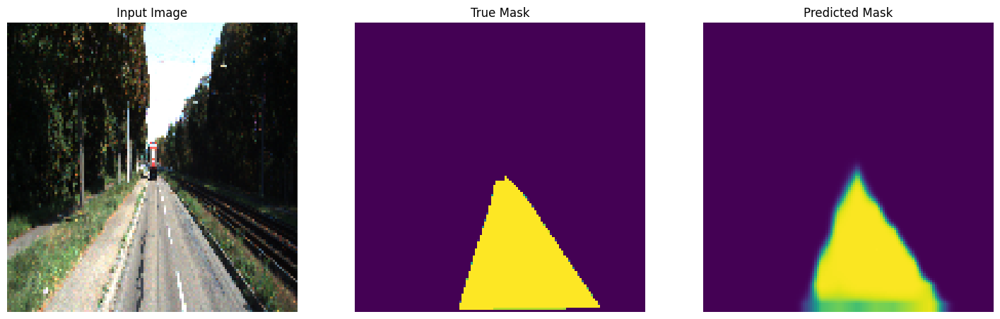


Sample Prediction after epoch 190


Epoch 190: val_loss did not improve from 0.04152
7/7 [==============================] - 21s 4s/step - loss: 0.0464 - mse: 0.0133 - val_loss: 0.0443 - val_mse: 0.0125
Epoch 191/200
1/1 [==============================] - 0s 20ms/step


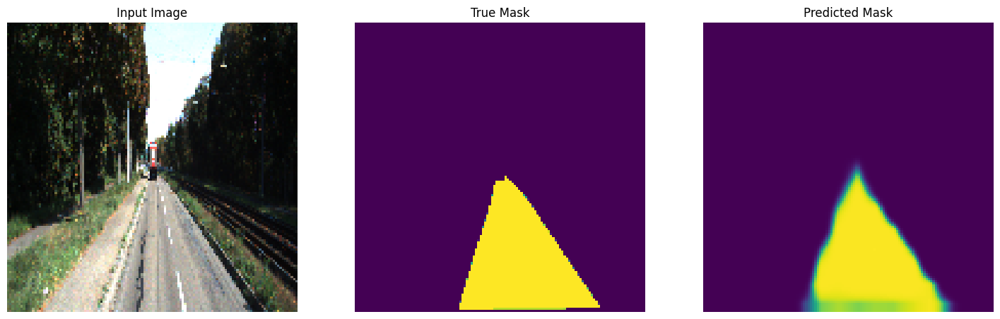


Sample Prediction after epoch 191


Epoch 191: val_loss did not improve from 0.04152
7/7 [==============================] - 22s 4s/step - loss: 0.0429 - mse: 0.0123 - val_loss: 0.0446 - val_mse: 0.0125
Epoch 192/200
1/1 [==============================] - 0s 19ms/step


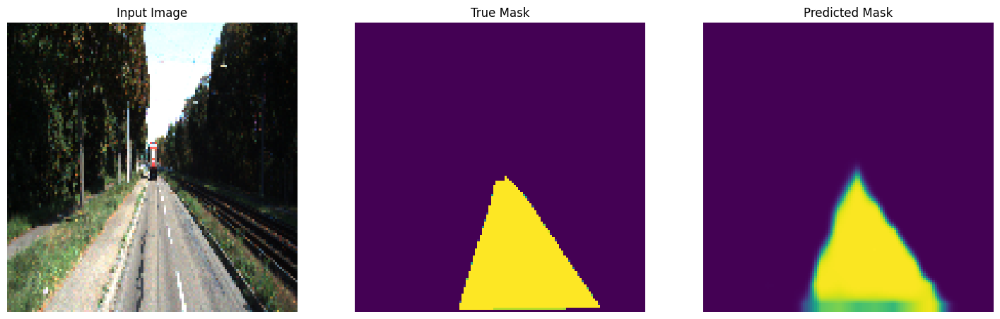


Sample Prediction after epoch 192


Epoch 192: val_loss did not improve from 0.04152
7/7 [==============================] - 26s 4s/step - loss: 0.0434 - mse: 0.0124 - val_loss: 0.0449 - val_mse: 0.0128
Epoch 193/200
1/1 [==============================] - 0s 20ms/step


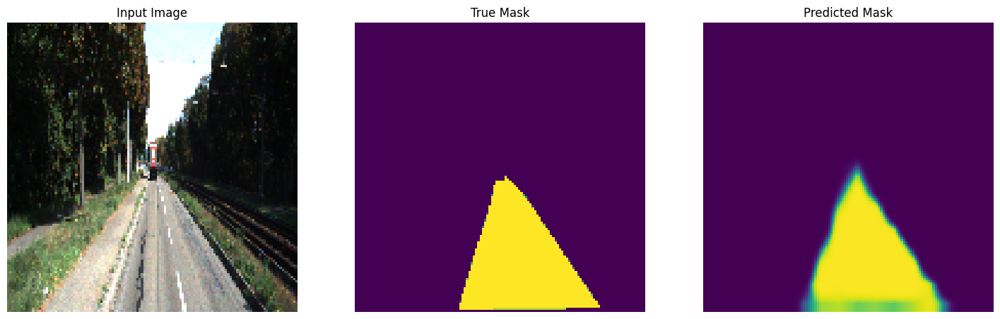


Sample Prediction after epoch 193


Epoch 193: val_loss improved from 0.04152 to 0.04110, saving model to best_model.h5
7/7 [==============================] - 23s 4s/step - loss: 0.0431 - mse: 0.0123 - val_loss: 0.0411 - val_mse: 0.0117
Epoch 194/200
1/1 [==============================] - 0s 20ms/step


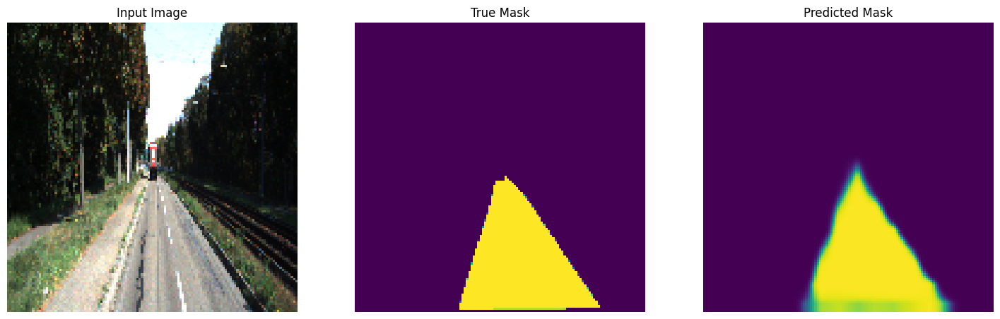


Sample Prediction after epoch 194


Epoch 194: val_loss improved from 0.04110 to 0.03875, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0426 - mse: 0.0122 - val_loss: 0.0388 - val_mse: 0.0109
Epoch 195/200
1/1 [==============================] - 0s 21ms/step


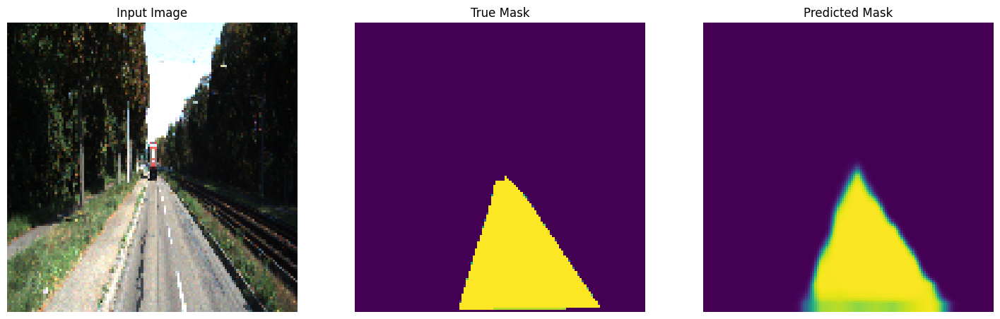


Sample Prediction after epoch 195


Epoch 195: val_loss improved from 0.03875 to 0.03822, saving model to best_model.h5
7/7 [==============================] - 27s 4s/step - loss: 0.0413 - mse: 0.0118 - val_loss: 0.0382 - val_mse: 0.0107
Epoch 196/200
1/1 [==============================] - 0s 23ms/step


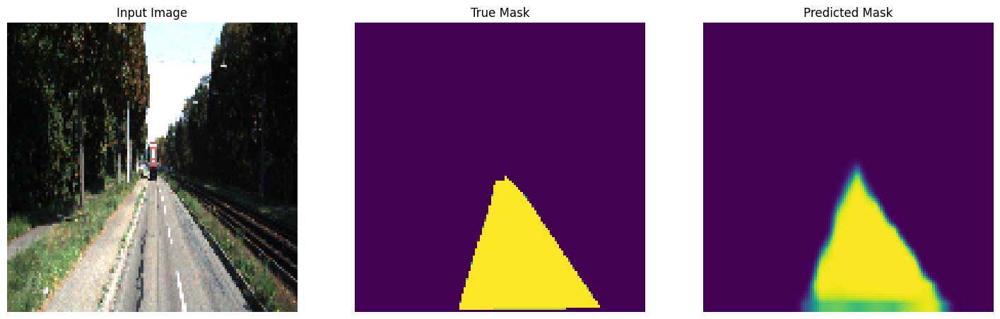


Sample Prediction after epoch 196


Epoch 196: val_loss did not improve from 0.03822
7/7 [==============================] - 22s 4s/step - loss: 0.0422 - mse: 0.0120 - val_loss: 0.0431 - val_mse: 0.0122
Epoch 197/200
1/1 [==============================] - 0s 21ms/step


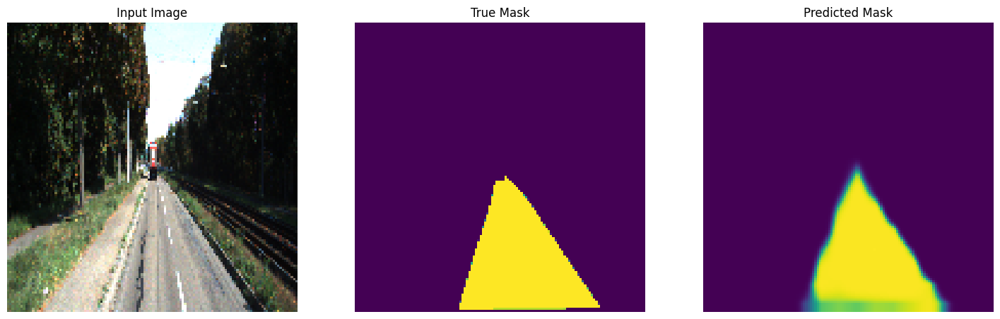


Sample Prediction after epoch 197


Epoch 197: val_loss did not improve from 0.03822
7/7 [==============================] - 23s 4s/step - loss: 0.0420 - mse: 0.0120 - val_loss: 0.0411 - val_mse: 0.0116
Epoch 198/200
1/1 [==============================] - 0s 20ms/step


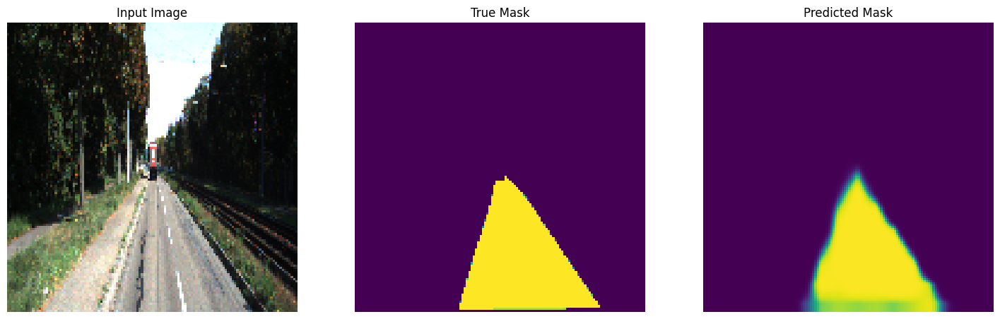


Sample Prediction after epoch 198


Epoch 198: val_loss did not improve from 0.03822
7/7 [==============================] - 22s 4s/step - loss: 0.0428 - mse: 0.0123 - val_loss: 0.0458 - val_mse: 0.0131
Epoch 199/200
1/1 [==============================] - 0s 20ms/step


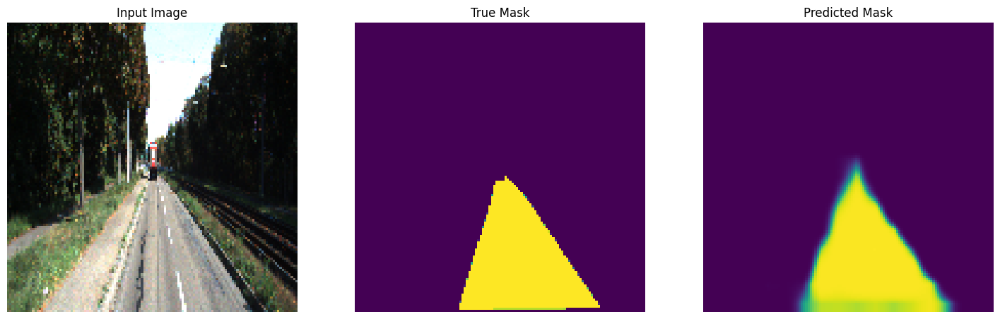


Sample Prediction after epoch 199


Epoch 199: val_loss did not improve from 0.03822
7/7 [==============================] - 22s 4s/step - loss: 0.0479 - mse: 0.0135 - val_loss: 0.0476 - val_mse: 0.0139
Epoch 200/200
1/1 [==============================] - 0s 24ms/step


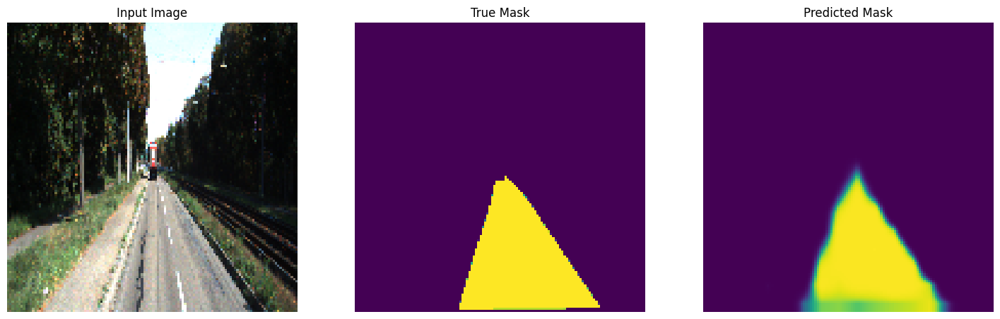


Sample Prediction after epoch 200


Epoch 200: val_loss did not improve from 0.03822
7/7 [==============================] - 22s 4s/step - loss: 0.0499 - mse: 0.0144 - val_loss: 0.0548 - val_mse: 0.0156


In [ ]:
model_history = model.fit(dataset['train'], epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_data = dataset["val"],
                          validation_steps=VALIDATION_STEPS,
                          callbacks = callbacks)

In [ ]:
# Function to calculate mask over image
def weighted_img(img, initial_img, a=1., b=0.5, y=0.):
    return cv2.addWeighted(initial_img, a, img, b, y)

# Function to process an individual image and it's mask
def process_image_mask(image, mask):
    # Round to closest
    mask = tf.math.round(mask)

    # Convert to mask image
    zero_image = np.zeros_like(mask)
    mask = np.dstack((mask, zero_image, zero_image))
    mask = np.asarray(mask, np.float32)

    # Convert to image image
    image = np.asarray(image, np.float32)

    # Get the final image
    final_image = weighted_img(mask, image)

    return final_image

In [ ]:
# Function to save predictions
def save_predictions(dataset):
    # Predict and save image the from input dataset
    index = 0
    for batch_image, batch_mask in dataset:
        for image, mask in zip(batch_image, batch_mask):
            print(f"Processing image : {index}")
            pred_mask = model.predict(tf.expand_dims(image, axis = 0))
            save_sample([image, process_image_mask(image, pred_mask[0])], index)
            index += 1

# Function to save the images as a plot
def save_sample(display_list, index):
    plt.figure(figsize=(18, 18))

    title = ['Input Image', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')

    plt.savefig(f"outputs/{index}.png")
    plt.show()

Processing image : 0
1/1 [==============================] - 1s 1s/step


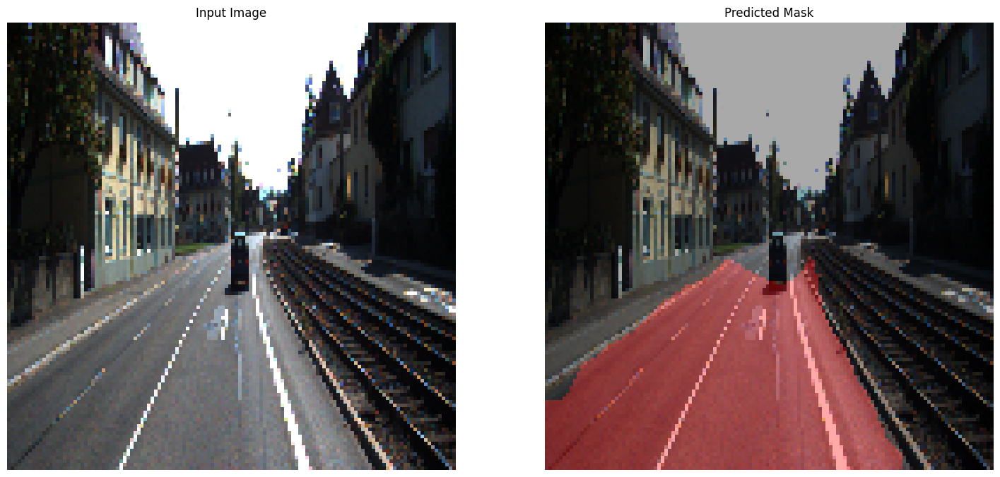

Processing image : 1
1/1 [==============================] - 0s 22ms/step


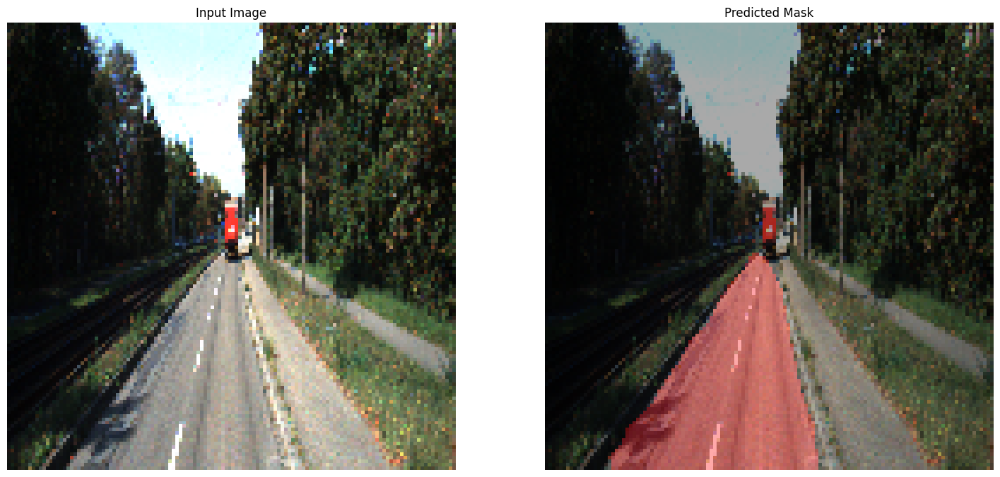

Processing image : 2
1/1 [==============================] - 0s 20ms/step


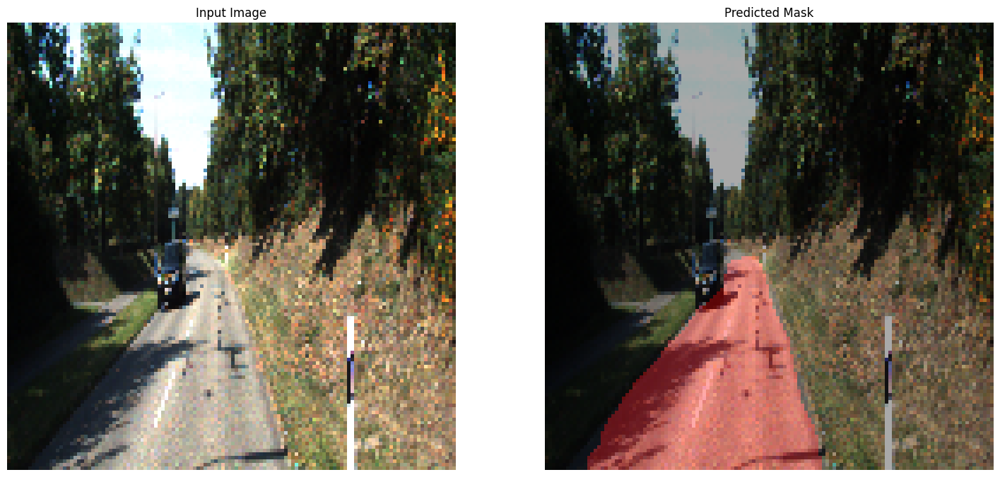

Processing image : 3
1/1 [==============================] - 0s 18ms/step


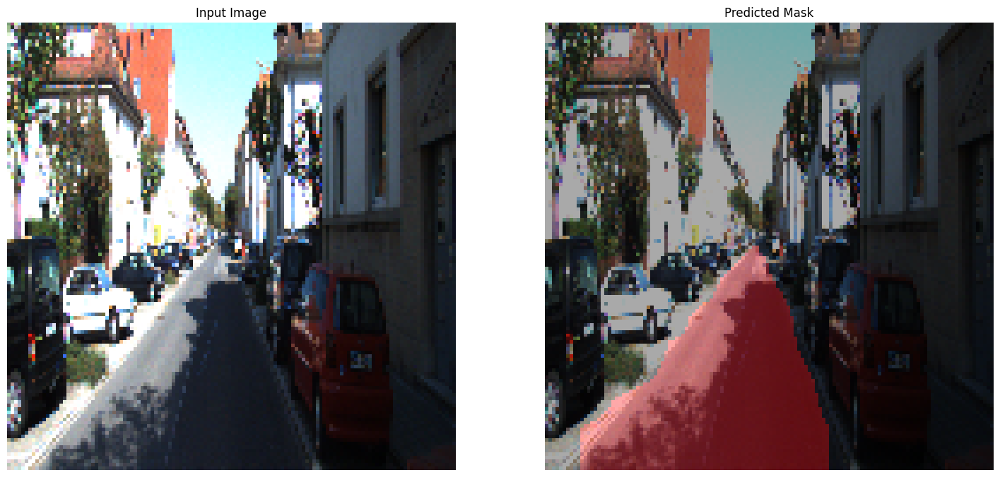

Processing image : 4
1/1 [==============================] - 0s 19ms/step


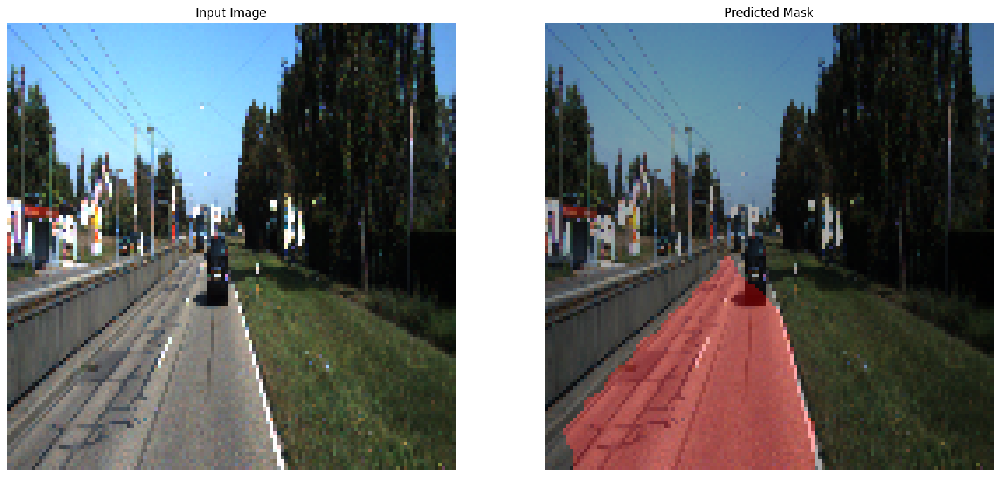

Processing image : 5
1/1 [==============================] - 0s 23ms/step


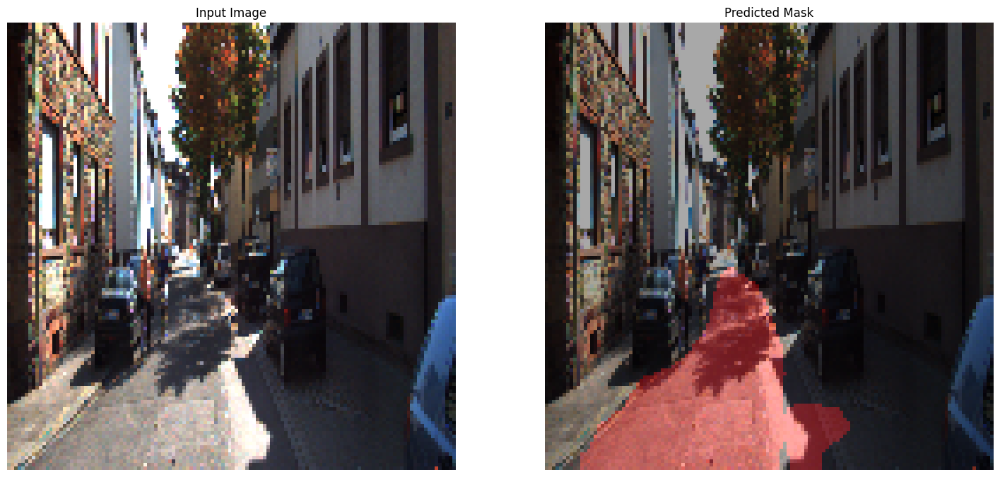

Processing image : 6
1/1 [==============================] - 0s 23ms/step


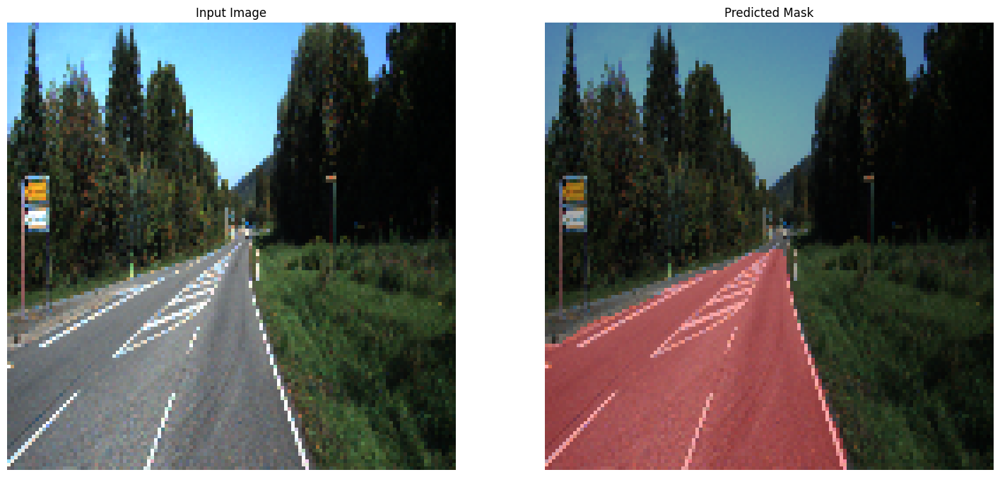

Processing image : 7
1/1 [==============================] - 0s 18ms/step


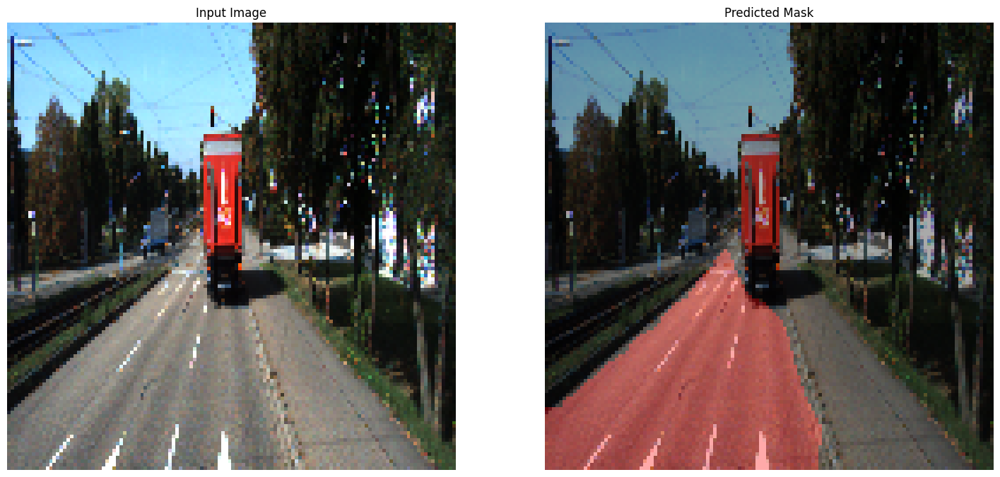

Processing image : 8
1/1 [==============================] - 0s 26ms/step


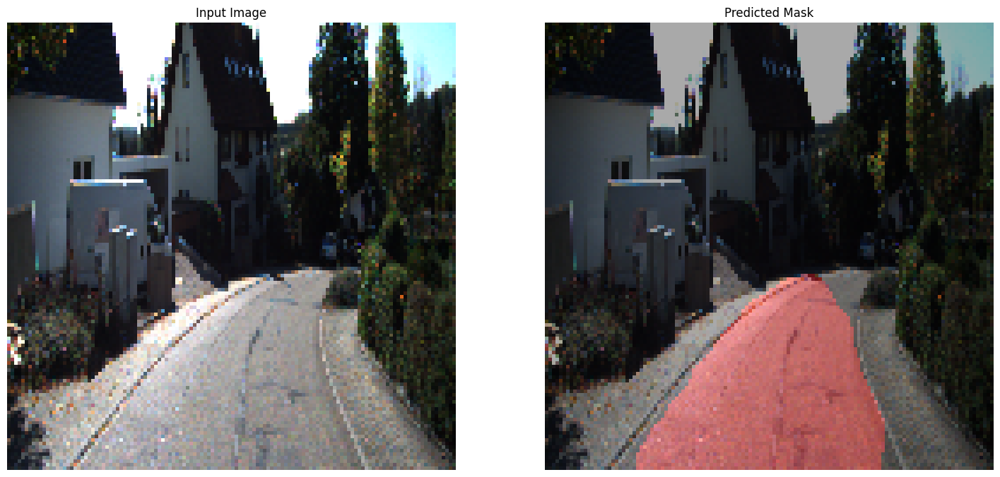

Processing image : 9
1/1 [==============================] - 0s 22ms/step


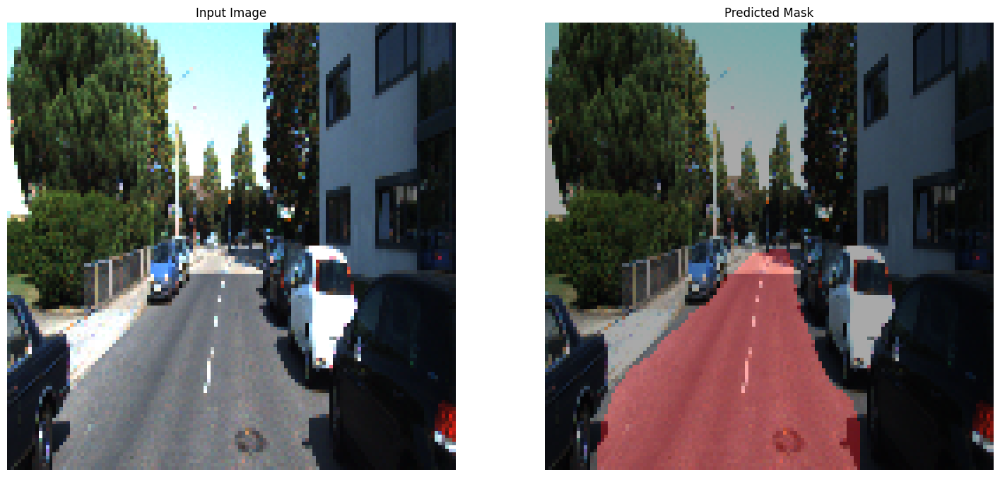

Processing image : 10
1/1 [==============================] - 0s 21ms/step


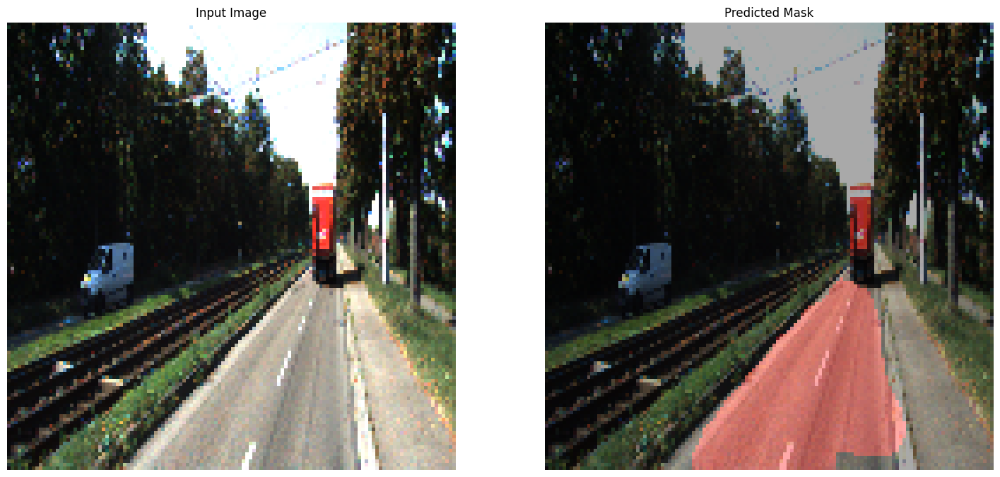

Processing image : 11
1/1 [==============================] - 0s 19ms/step


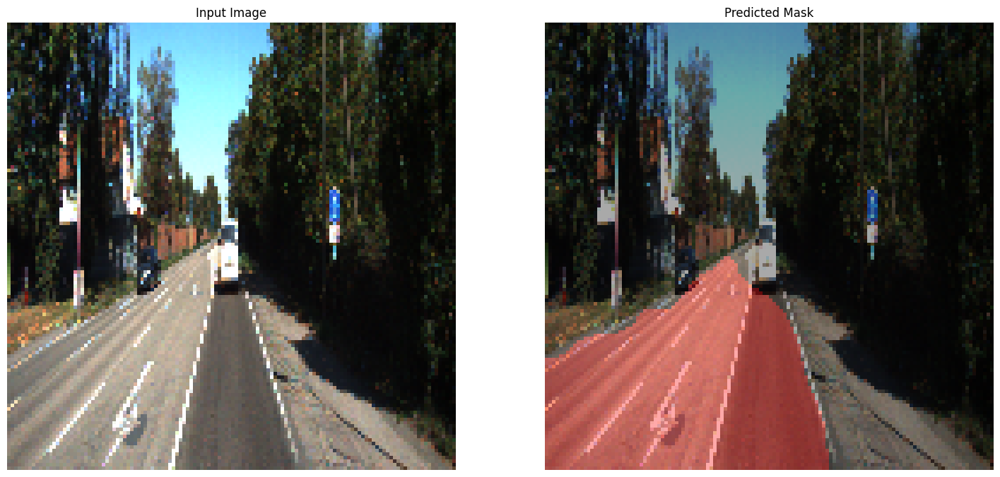

Processing image : 12
1/1 [==============================] - 0s 27ms/step


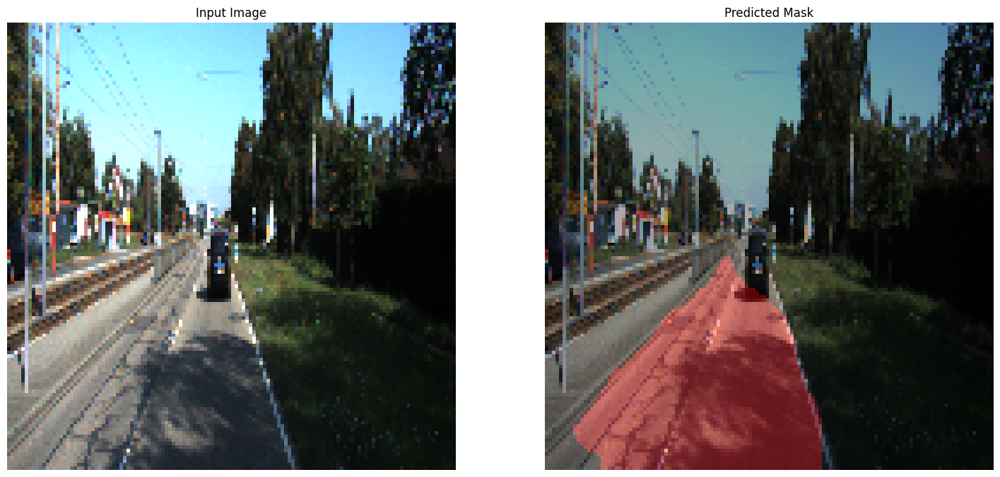

Processing image : 13
1/1 [==============================] - 0s 26ms/step


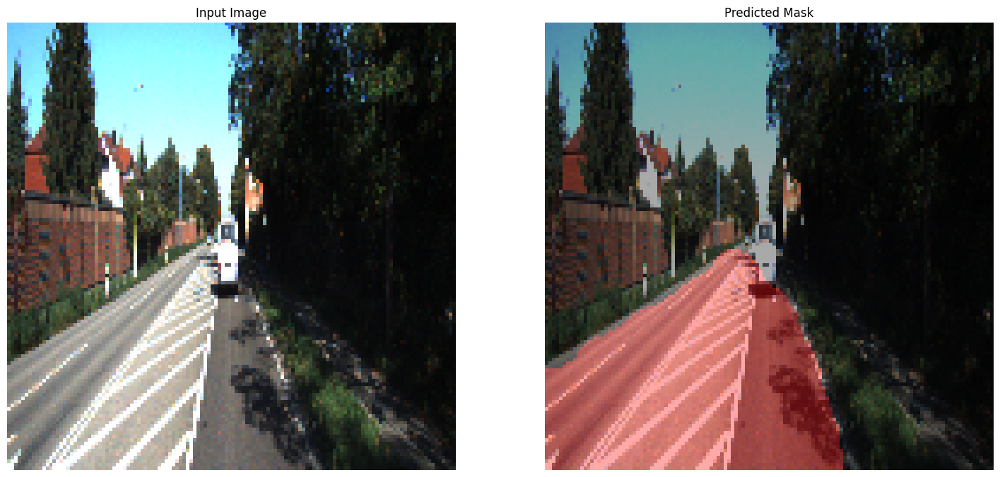

Processing image : 14
1/1 [==============================] - 0s 30ms/step


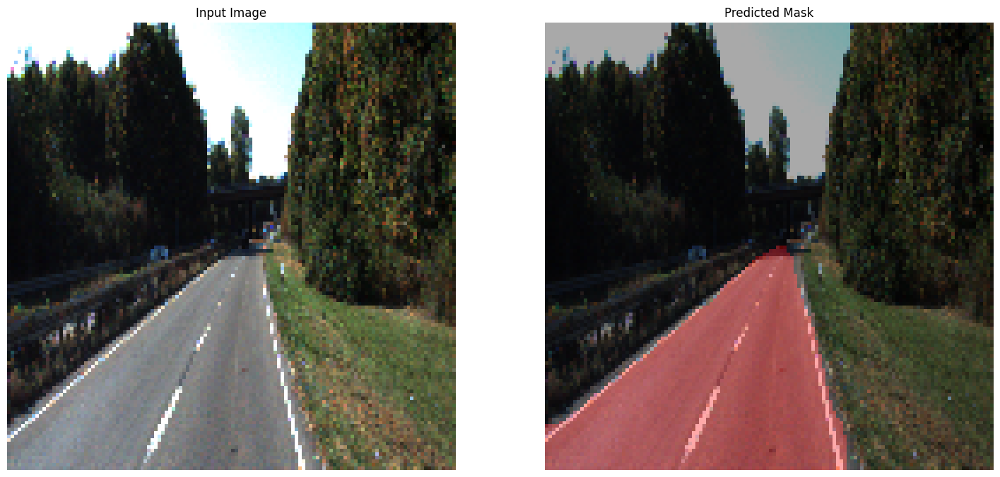

Processing image : 15
1/1 [==============================] - 0s 22ms/step


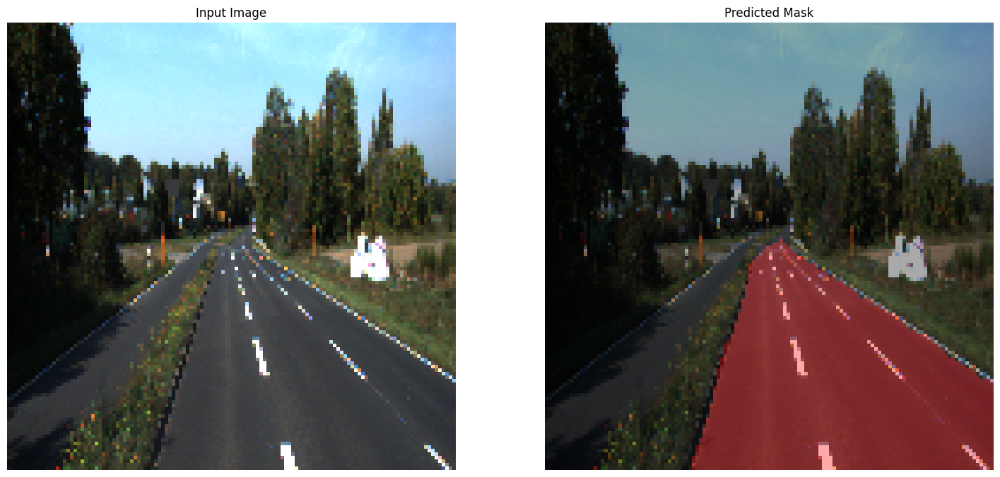

Processing image : 16
1/1 [==============================] - 0s 26ms/step


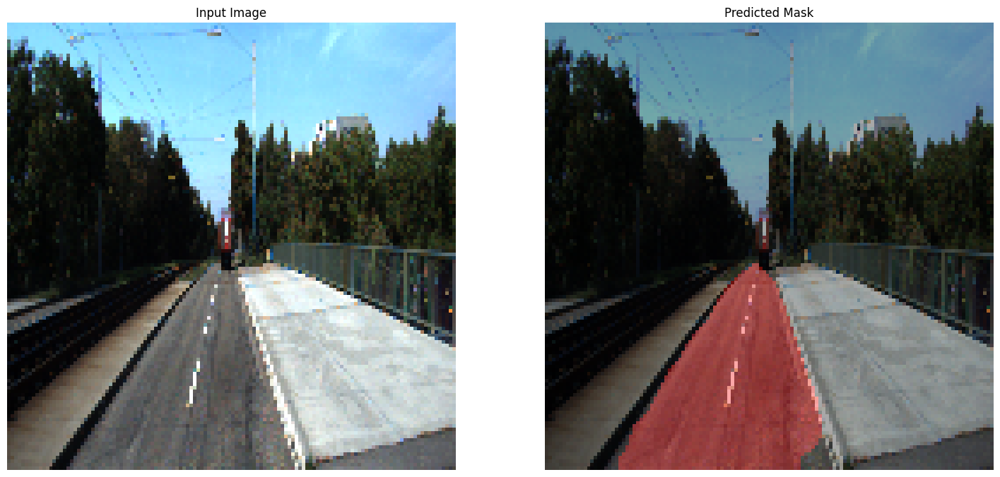

Processing image : 17
1/1 [==============================] - 0s 24ms/step


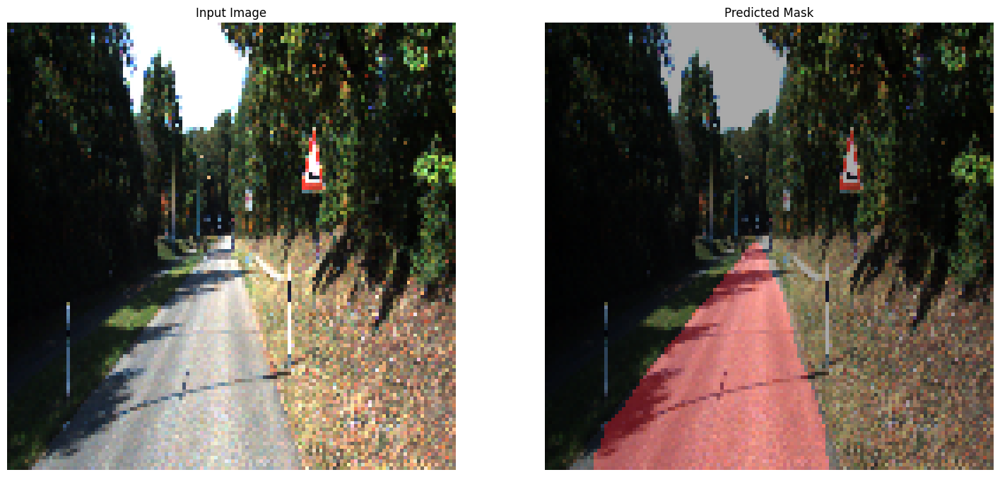

Processing image : 18
1/1 [==============================] - 0s 27ms/step


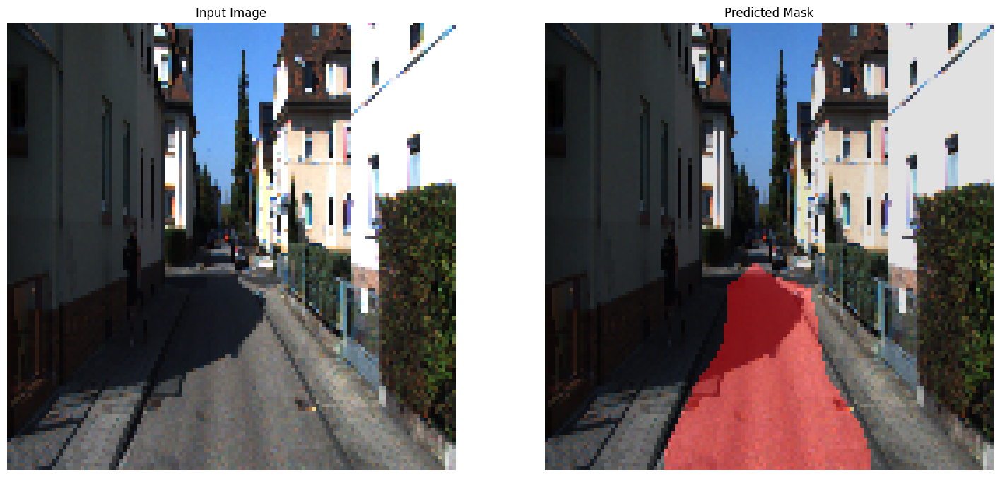

Processing image : 19
1/1 [==============================] - 0s 22ms/step


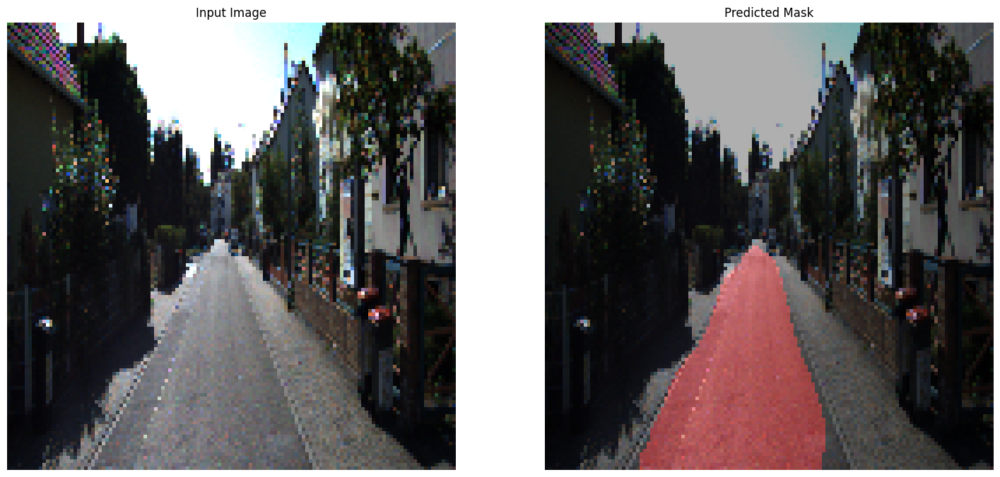

Processing image : 20
1/1 [==============================] - 0s 25ms/step


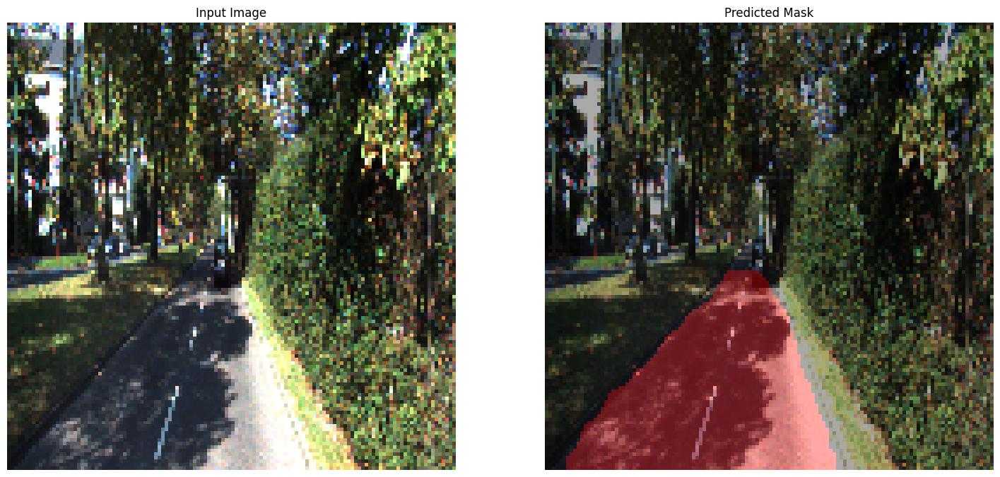

Processing image : 21
1/1 [==============================] - 0s 26ms/step


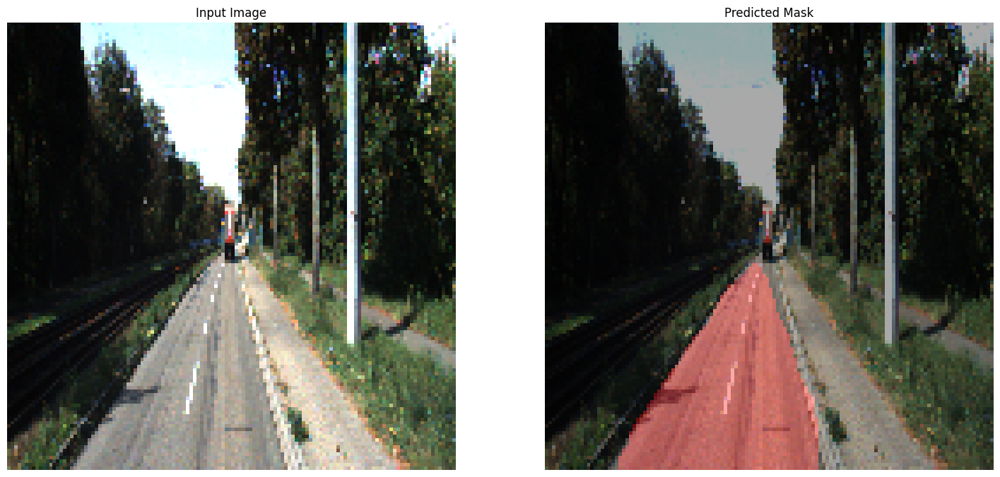

Processing image : 22
1/1 [==============================] - 0s 27ms/step


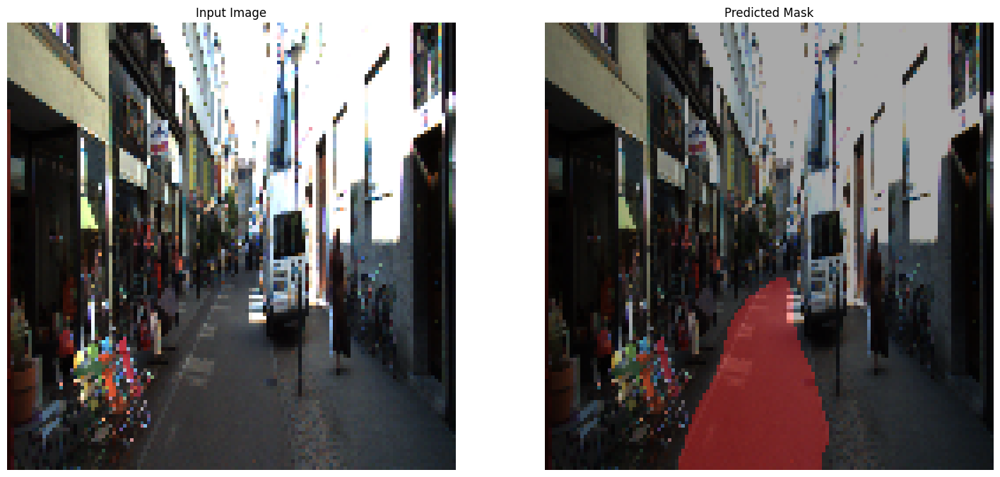

Processing image : 23
1/1 [==============================] - 0s 26ms/step


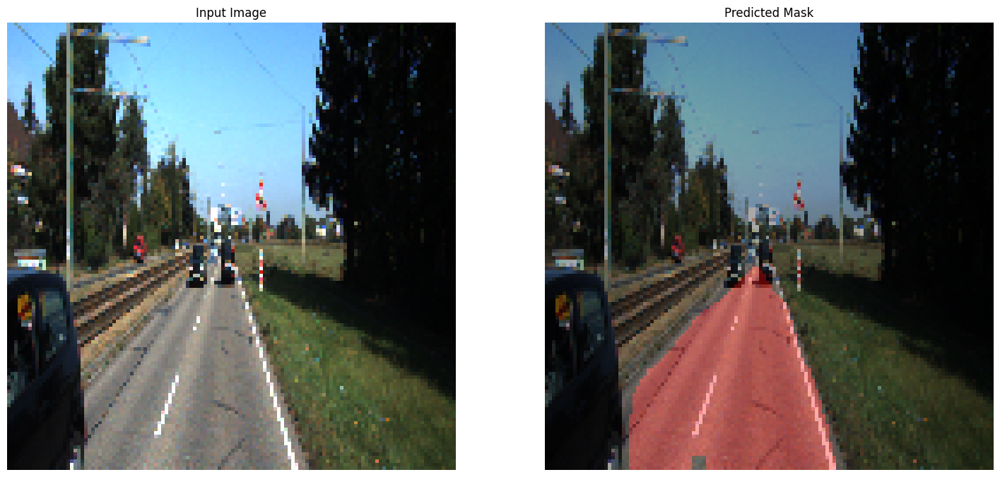

Processing image : 24
1/1 [==============================] - 0s 26ms/step


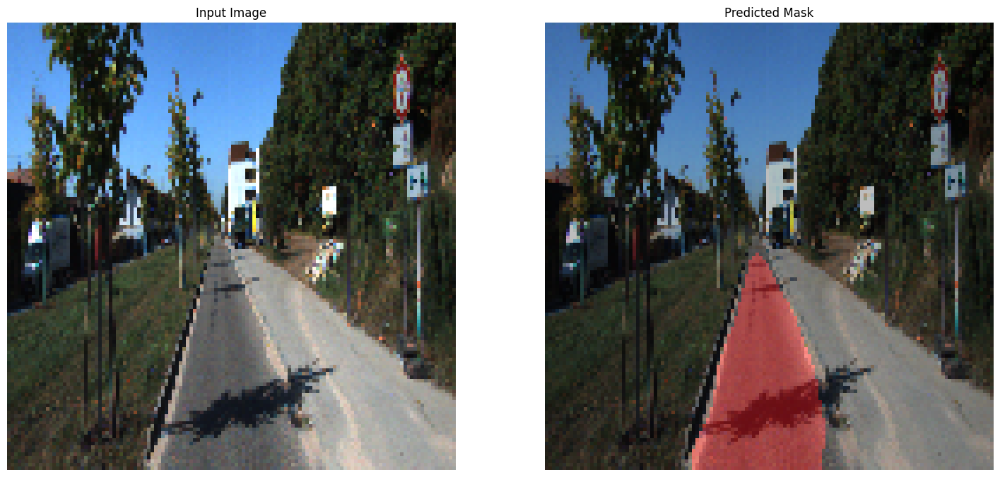

Processing image : 25
1/1 [==============================] - 0s 38ms/step


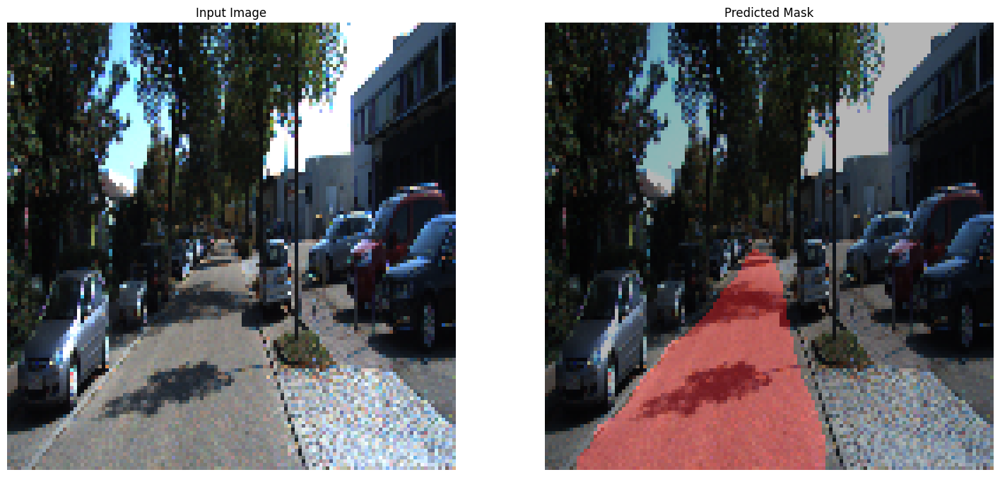

Processing image : 26
1/1 [==============================] - 0s 28ms/step


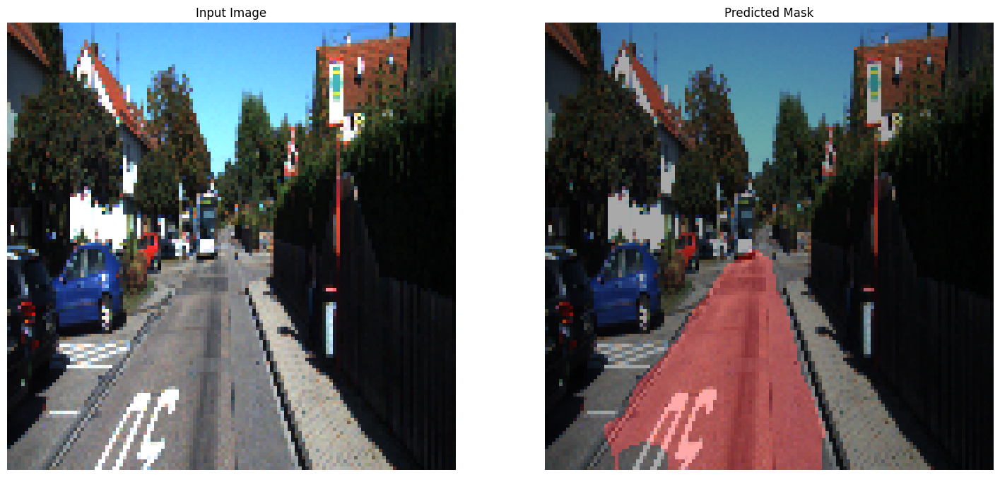

Processing image : 27
1/1 [==============================] - 0s 26ms/step


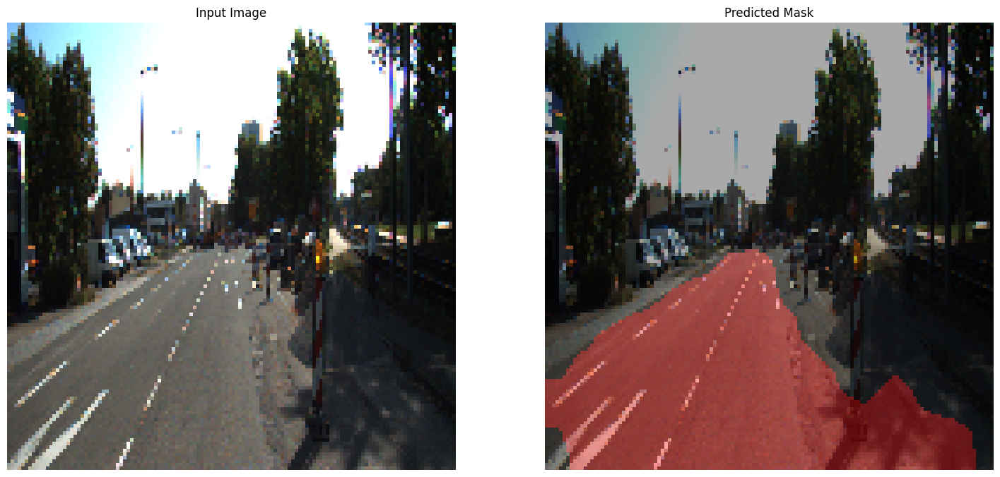

Processing image : 28
1/1 [==============================] - 0s 29ms/step


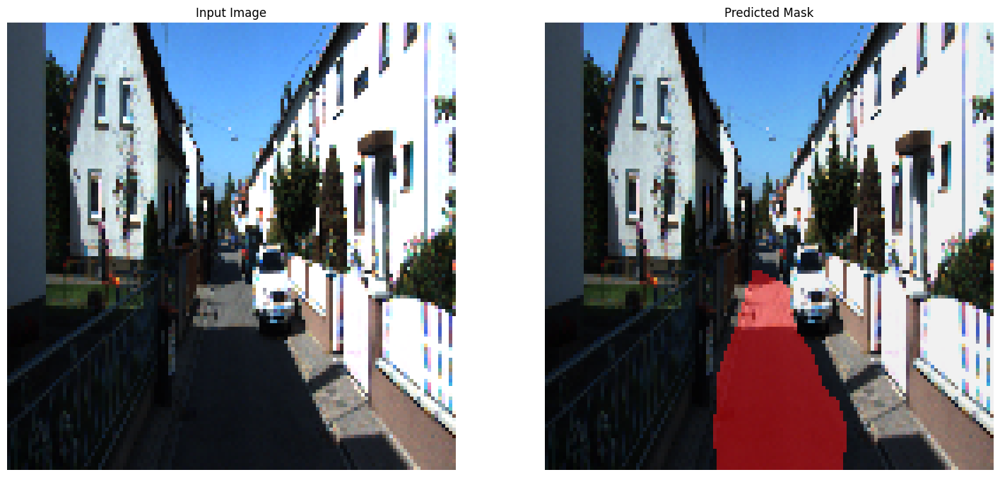

Processing image : 29
1/1 [==============================] - 0s 26ms/step


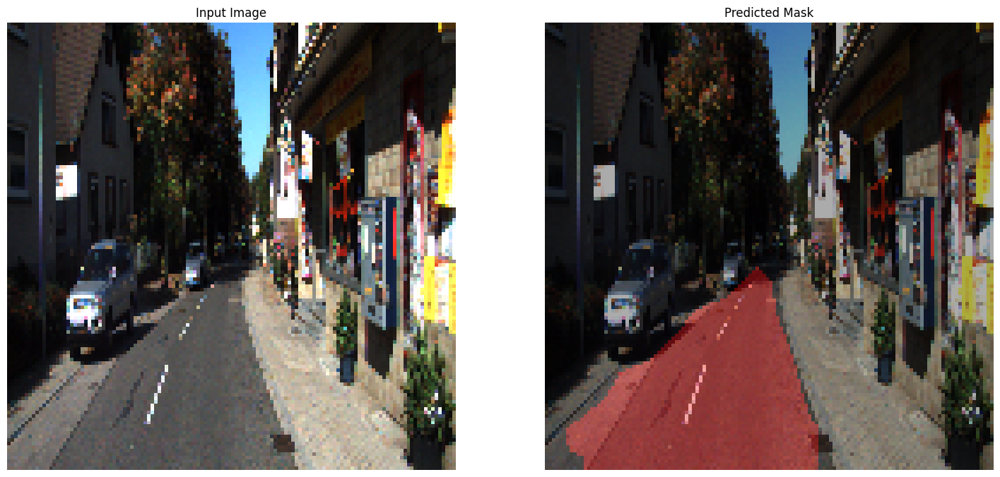

In [ ]:
os.mkdir("outputs")
save_predictions(dataset['test'])

In [ ]:
# Function to view video
def play(filename):
    html = ''
    video = open(filename,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=1000 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
    return HTML(html)

In [ ]:
# Function to process an individual image
def process_image(image):
    # Preprocess image
    image = cv2.resize(image, (IMG_SIZE, IMG_SIZE))
    # Get the binary mask
    pred_mask = model.predict(np.expand_dims(image, axis = 0))
    mask = np.round_(pred_mask[0])

    # Convert to mask image
    zero_image = np.zeros_like(mask)
    mask = np.dstack((mask, zero_image, zero_image)) * 255
    mask = np.asarray(mask, np.uint8)

    # Get the final image
    final_image = weighted_img(mask, image)
    final_image = cv2.resize(final_image, (1280, 720))

    return final_image

In [ ]:
# Make a new directory
os.mkdir("videos")

In [ ]:
# Creating a VideoCapture object to read the video
project_video = "project_video.mp4"
original_video = cv2.VideoCapture(test_data_dir + project_video)
frame_width = int(original_video.get(3))
frame_height = int(original_video.get(4))

# Define the codec and create VideoWriter object.The output is stored in 'outpy.avi' file.
fourcc = cv2.VideoWriter_fourcc('m','p','4','v')
fps = 60
output = cv2.VideoWriter("videos/" + project_video, fourcc, fps, (frame_width,frame_height))

# Process Video
while(original_video.isOpened()):
    ret, frame = original_video.read()

    if ret == True:
        # Write the frame into the file 'output.avi'
        output.write(process_image(frame))

    else:
        break

# When everything done, release the video capture and video write objects
original_video.release()
output.release()

In [ ]:
play("videos/" + project_video)

In [ ]:
# Creating a VideoCapture object to read the video
project_video = "challenge.mp4"
original_video = cv2.VideoCapture(test_data_dir + project_video)
frame_width = int(original_video.get(3))
frame_height = int(original_video.get(4))

# Define the codec and create VideoWriter object.The output is stored in 'outpy.avi' file.
fourcc = cv2.VideoWriter_fourcc('m','p','4','v')
fps = 60
output = cv2.VideoWriter("videos/" + project_video, fourcc, fps, (frame_width,frame_height))

# Process Video
while(original_video.isOpened()):
    ret, frame = original_video.read()

    if ret == True:
        # Write the frame into the file 'output.avi'
        output.write(process_image(frame))

    else:
        break

# When everything done, release the video capture and video write objects
original_video.release()
output.release()

In [ ]:
play("videos/" + project_video)

In [ ]:
# Creating a VideoCapture object to read the video
project_video = "challenge_video.mp4"
original_video = cv2.VideoCapture(test_data_dir + project_video)
frame_width = int(original_video.get(3))
frame_height = int(original_video.get(4))

# Define the codec and create VideoWriter object.The output is stored in 'outpy.avi' file.
fourcc = cv2.VideoWriter_fourcc('m','p','4','v')
fps = 60
output = cv2.VideoWriter("videos/" + project_video, fourcc, fps, (frame_width,frame_height))

# Process Video
while(original_video.isOpened()):
    ret, frame = original_video.read()

    if ret == True:
        # Write the frame into the file 'output.avi'
        output.write(process_image(frame))

    else:
        break

# When everything done, release the video capture and video write objects
original_video.release()
output.release()

In [ ]:
play("videos/" + project_video)

In [ ]:
# Creating a VideoCapture object to read the video
project_video = "harder_challenge_video.mp4"
original_video = cv2.VideoCapture(test_data_dir + project_video)
frame_width = int(original_video.get(3))
frame_height = int(original_video.get(4))

# Define the codec and create VideoWriter object.The output is stored in 'outpy.avi' file.
fourcc = cv2.VideoWriter_fourcc('m','p','4','v')
fps = 60
output = cv2.VideoWriter("videos/" + project_video, fourcc, fps, (frame_width,frame_height))

# Process Video
while(original_video.isOpened()):
    ret, frame = original_video.read()

    if ret == True:
        # Write the frame into the file 'output.avi'
        output.write(process_image(frame))

    else:
        break

# When everything done, release the video capture and video write objects
original_video.release()
output.release()

In [ ]:
play("videos/" + project_video)